# Visualizing Wareham River Data from July 12
All data has been pre-cleaned that is loaded into this notebook. Several types of figures will be generated, including, temporal, property v property, and spatial. 

## Loading Dependencies and Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.image import NonUniformImage
from matplotlib import cm
from mpl_toolkits.axes_grid1 import host_subplot
import mpl_toolkits.axisartist as AA
% pylab inline
import seaborn as sns
from IPython.display import display
from descartes import PolygonPatch
from shapely.geometry import LineString
import shapefile
from scipy.optimize import curve_fit
import sensor_plotting as sp

# Data Files
# Instruments
ctd_fn = './Cleaned_Data/ctd.csv'
gga_fn = './Cleaned_Data/gga.csv'
op_fn ='./Cleaned_Data/op.csv'
airmar_fn ='./Cleaned_Data/airmar.csv'
dge_fn= './Cleaned_Data/dge.csv'
nitrate_fn = './Cleaned_Data/nitrate.csv'

# Full Data
all_fn = './Cleaned_Data/interpolated_complete_data.csv'

# Transects
a_fn = './Cleaned_Data/transectA.csv'
b_fn = './Cleaned_Data/transectB.csv'
c_fn = './Cleaned_Data/transectC.csv'
d_fn = './Cleaned_Data/transectD.csv'
e_fn = './Cleaned_Data/transectE.csv'
# f_fn = './Cleaned_Data/transectF.csv'

# PANDAS dataframe display options
pd.set_option('display.max_columns', None)

# more info at http://matplotlib.org/users/customizing.html
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['figure.figsize'] = (10,6)
plt.rcParams['axes.facecolor'] = '0.75'

/home/vpreston/anaconda2/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')
/home/vpreston/anaconda2/lib/python2.7/site-packages/matplotlib/__init__.py:872: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


Populating the interactive namespace from numpy and matplotlib


In [2]:
reload(sp)

<module 'sensor_plotting' from 'sensor_plotting.pyc'>

## Read in Data

In [3]:
# Instruments
ctd = pd.read_table(ctd_fn, delimiter=',', header=0)
gga = pd.read_table(gga_fn, delimiter=',', header=0)
op = pd.read_table(op_fn, delimiter=',', header=0)
airmar = pd.read_table(airmar_fn, delimiter=',', header=0)
dge = pd.read_table(dge_fn, delimiter=',', header=0)
nitrate = pd.read_table(nitrate_fn, delimiter=',', header=0)

In [4]:
# Complete Data
df = pd.read_table(all_fn, delimiter=',', header=[0,1])

/home/vpreston/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py:2902: DtypeWarning: Columns (0,31) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [5]:
# Transects
ta = pd.read_table(a_fn, delimiter=',', header=[0,1])
tb = pd.read_table(b_fn, delimiter=',', header=[0,1])
tc = pd.read_table(c_fn, delimiter=',', header=[0,1])
td = pd.read_table(d_fn, delimiter=',', header=[0,1])
te = pd.read_table(e_fn, delimiter=',', header=[0,1])
# tf = pd.read_table(f_fn, delimiter=',', header=[0,1])

/home/vpreston/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py:2902: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


## Temporal Graphs

Let's start by looking at how readings changed over time on various instruments. Then we can break it down to look at multiple instruments, then across the different transects. Something important to note is that time and space for this next set of figures is related. Later we can try to control for space (by doing a groupby operation) and see how a particular location/region may have changed over time.

### Instruments

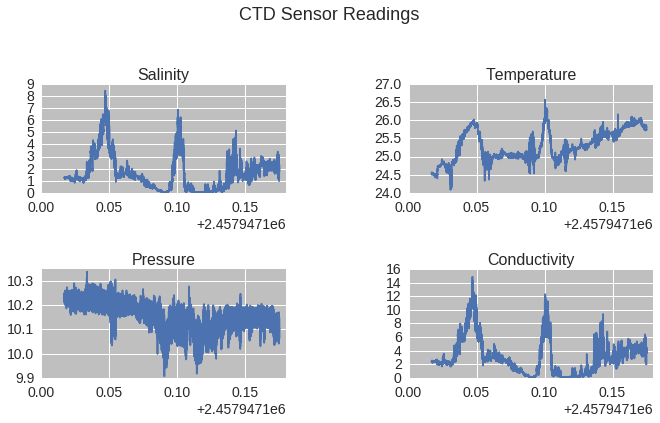

In [6]:
# Start with the CTD, let's just plot all of the data on one plot
plt.figure(1)
sp.plot_timequad(plt,
                 ctd['Julian_Date'], 
                 ctd['Salinity'], 
                 ctd['Temperature'],
                 ctd['Pressure'],
                 ctd['Conductivity'],
                 'Time (Julian_Date)',
                 'Salinity',
                 'Temperature',
                 'Pressure',
                 'Conductivity',
                 'CTD Sensor Readings')
plt.show()

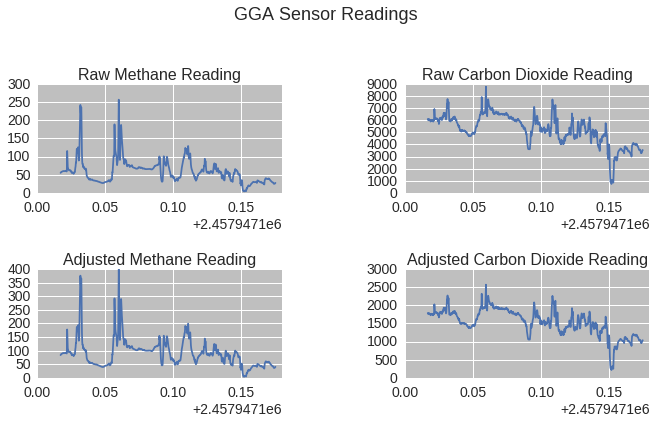

In [7]:
# Now for the greenhouse gas analyzer
plt.figure(2)
sp.plot_timequad(plt,
                 gga['Julian_Date'], 
                 gga['CH4_ppm'], 
                 gga['CO2_ppm'],
                 gga['CH4_ppm_adjusted'],
                 gga['CO2_ppm_adjusted'],
                 'Time (Julian_Date)',
                 'Raw Methane Reading',
                 'Raw Carbon Dioxide Reading',
                 'Adjusted Methane Reading',
                 'Adjusted Carbon Dioxide Reading',
                 'GGA Sensor Readings')

plt.show()

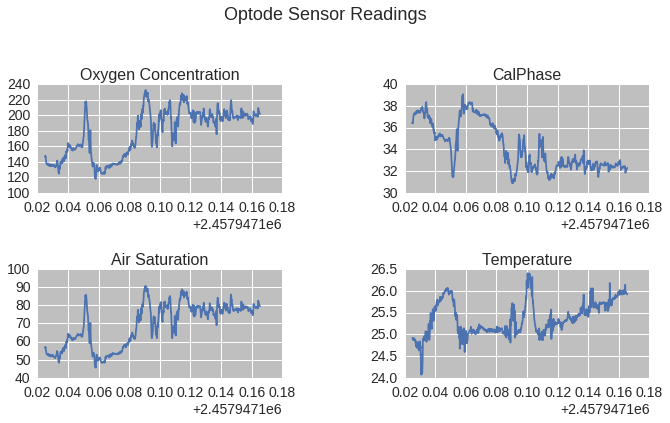

In [8]:
# Now for the optode
plt.figure(3)
sp.plot_timequad(plt,
                 op['Julian_Date'], 
                 op['O2Concentration'], 
                 op['CalPhase'],
                 op['AirSaturation'],
                 op['Temperature'],
                 'Time (Julian_Date)',
                 'Oxygen Concentration',
                 'CalPhase',
                 'Air Saturation',
                 'Temperature',
                 'Optode Sensor Readings')

plt.show()

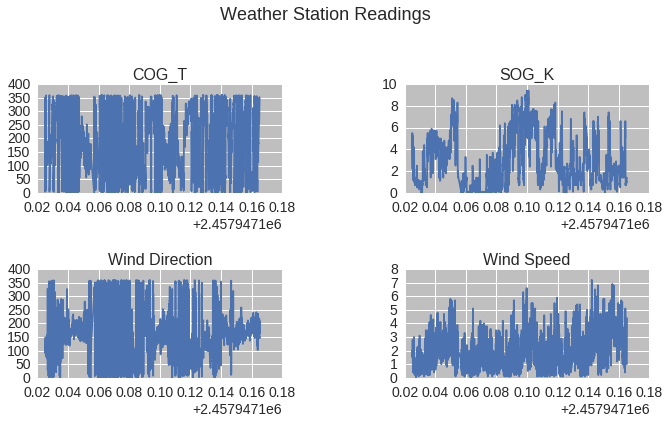

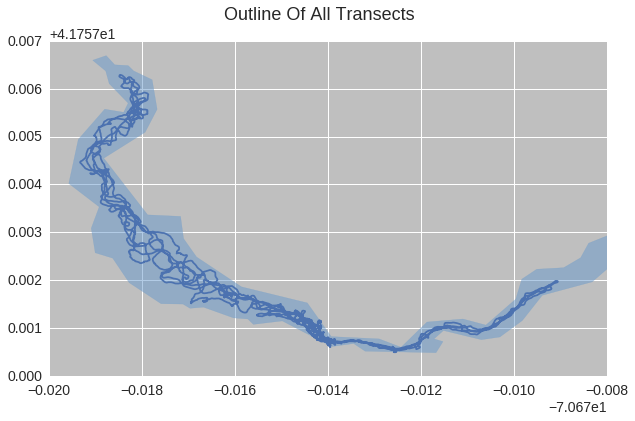

In [9]:
# Now for the airmar weather station
plt.figure(4)
sp.plot_timequad(plt,
                 airmar['Julian_Date'], 
                 airmar['COG_T'], 
                 airmar['SOG_K'],
                 airmar['wind_dir_T'],
                 airmar['wind_speed_M'],
                 'Time (Julian_Date)',
                 'COG_T',
                 'SOG_K',
                 'Wind Direction',
                 'Wind Speed',
                 'Weather Station Readings')

# Plot the coordinates over time
plt.figure(5)
plt.plot(airmar['lon_mod'], airmar['lat_mod'])
plt.suptitle('Outline Of All Transects', fontsize=18)

polys  = shapefile.Reader('./GIS_Data/River.shp')
poly = polys.iterShapes().next().__geo_interface__
ax = plt.gca()
ax.add_patch(PolygonPatch(poly, fc="#6699cc", ec="#6699cc", alpha=0.5, zorder=2))

plt.show()

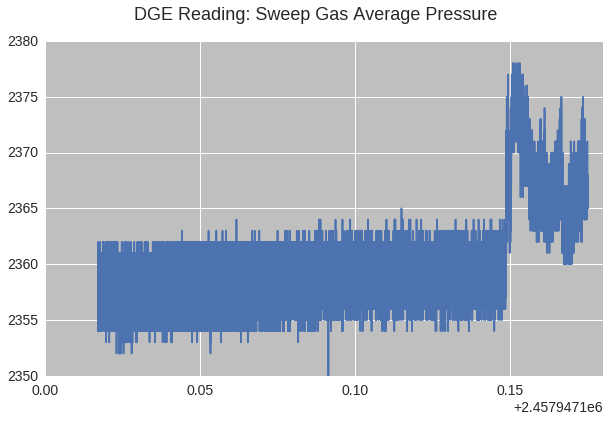

In [10]:
# Now for the DGE
x = dge['Julian_Date']

# plot with various axes scales
plt.figure(1)
plt.suptitle('DGE Reading: Sweep Gas Average Pressure', fontsize=18)

plt.plot(x, dge['SweepGas_Press_Avg'])
plt.grid(True)

plt.show()

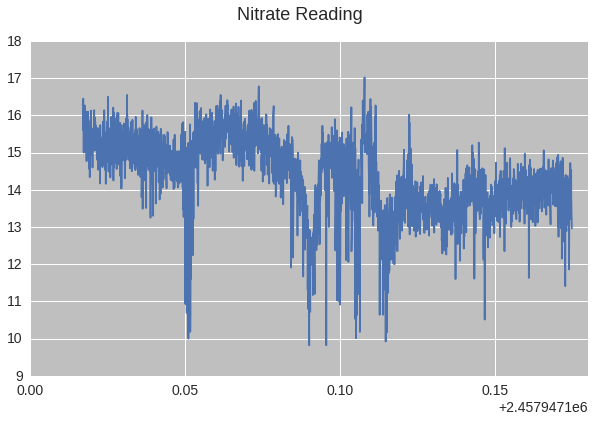

In [11]:
# And the nitrate sensor
x = nitrate['Julian_Date']

# plot with various axes scales
plt.figure(1)
plt.suptitle('Nitrate Reading', fontsize=18)

plt.plot(x, nitrate['0.00'])
plt.grid(True)

plt.show()

### Multiple Properties over Time

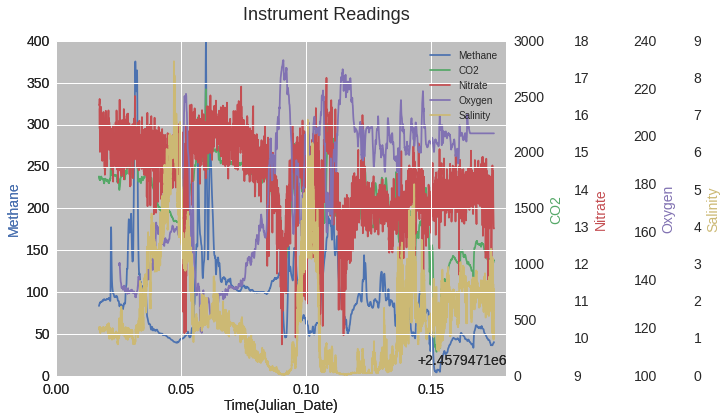

In [12]:
# Now let's look at methane, CO2, nitrate, oxygen, and salinity
host = host_subplot(111, axes_class=AA.Axes)
plt.figure(1)

data = [df['gga']['CH4_ppm_adjusted'][1:],
        df['gga']['CO2_ppm_adjusted'][1:],
        df['nitrate']['0.00'][1:],
        df['op']['O2Concentration'][1:],
        df['ctd']['Salinity'][1:]]

labels = ['Time(Julian_Date)', 'Methane', 'CO2', 'Nitrate', 'Oxygen', 'Salinity']
x = df['Unnamed: 0_level_0']['Unnamed: 0_level_1'][1:]

sp.plot_multiaxes(host, plt, x, data, labels, 'Instrument Readings')

plt.draw()
plt.show()


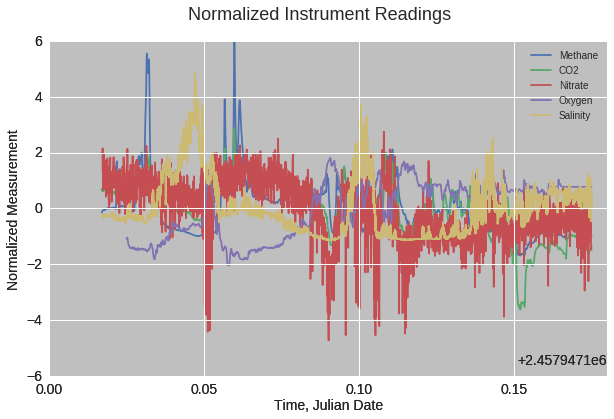

In [13]:
# That isn't the easiest to read and understand. So let's go ahead and normalize all of the readings
# and compare that way

#let's use z-score normalizing
x = df['Unnamed: 0_level_0']['Unnamed: 0_level_1'][1:]
meth_norm = (df['gga']['CH4_ppm_adjusted'] - df['gga']['CH4_ppm_adjusted'].mean())/df['gga']['CH4_ppm_adjusted'].std()
co2_norm = (df['gga']['CO2_ppm_adjusted'] - df['gga']['CO2_ppm_adjusted'].mean())/df['gga']['CO2_ppm_adjusted'].std()
nit_norm = (df['nitrate']['0.00'] - df['nitrate']['0.00'].mean())/df['nitrate']['0.00'].std()
oxy_norm = (df['op']['O2Concentration'] - df['op']['O2Concentration'].mean())/df['op']['O2Concentration'].std()
sal_norm = (df['ctd']['Salinity'] - df['ctd']['Salinity'].mean())/df['ctd']['Salinity'].std()

#now, let's plot it
host = host_subplot(111, axes_class=AA.Axes)
plt.figure(1)

data = [meth_norm[1:], co2_norm[1:], nit_norm[1:], oxy_norm[1:], sal_norm[1:]]
labels = ['Methane', 'CO2', 'Nitrate', 'Oxygen', 'Salinity']
sp.plot_norm(host, plt, x, data, labels, 'Normalized Instrument Readings')

plt.draw()
plt.show()


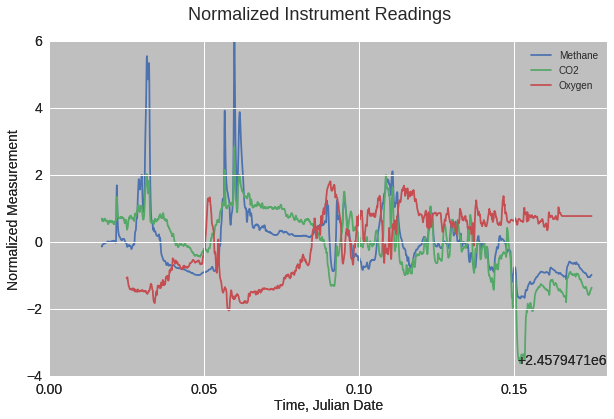

In [14]:
# Let's Break it down a bit more

host = host_subplot(111, axes_class=AA.Axes)
plt.figure(1)

data = [meth_norm[1:], co2_norm[1:], oxy_norm[1:]]
labels = ['Methane', 'CO2', 'Oxygen']
sp.plot_norm(host, plt, x, data, labels, 'Normalized Instrument Readings')

plt.draw()
plt.show()

### Looking at Transects
Now we can recreate each of these types of figures for each transect.

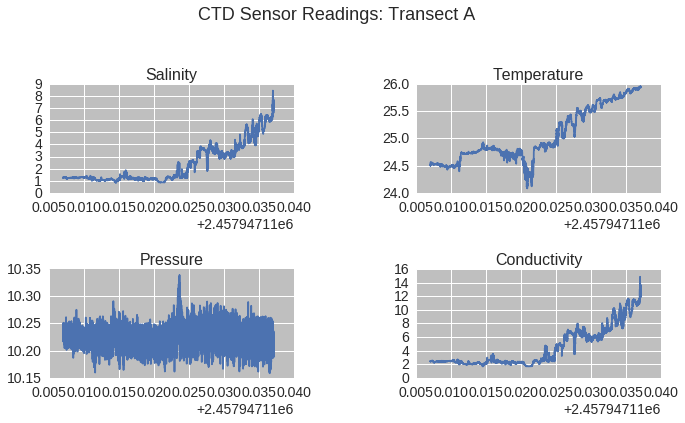

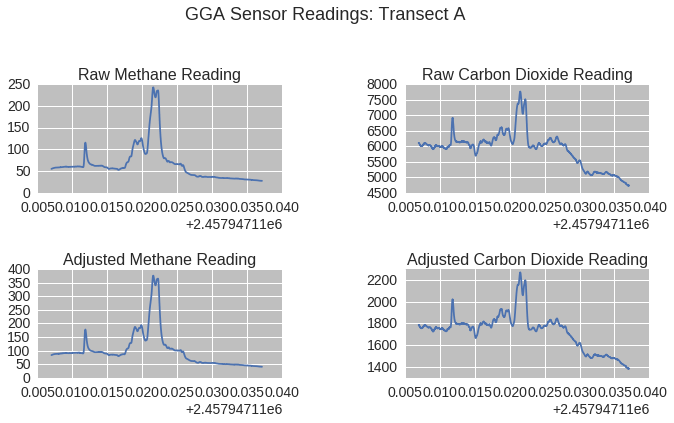

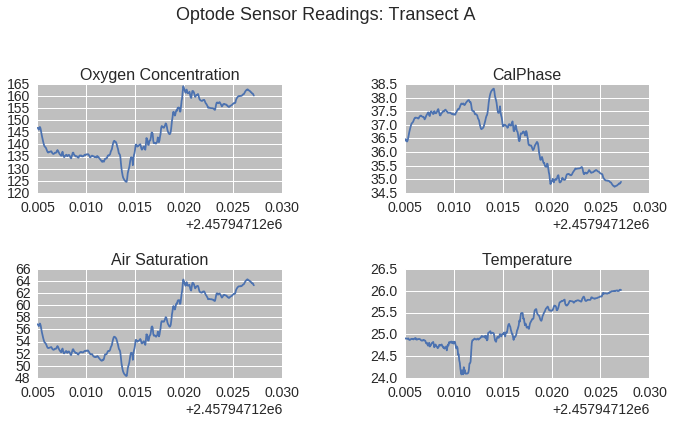

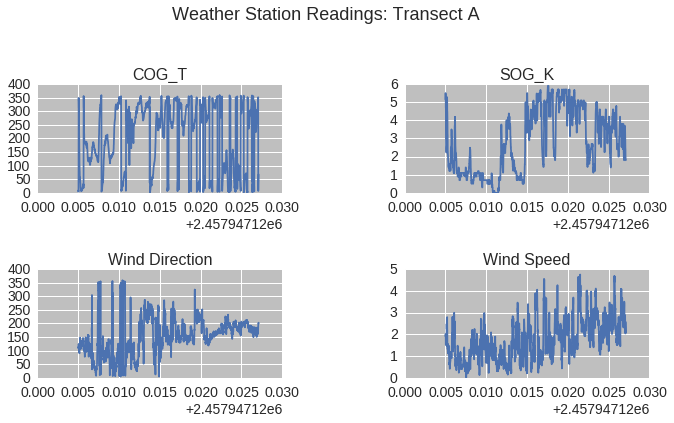

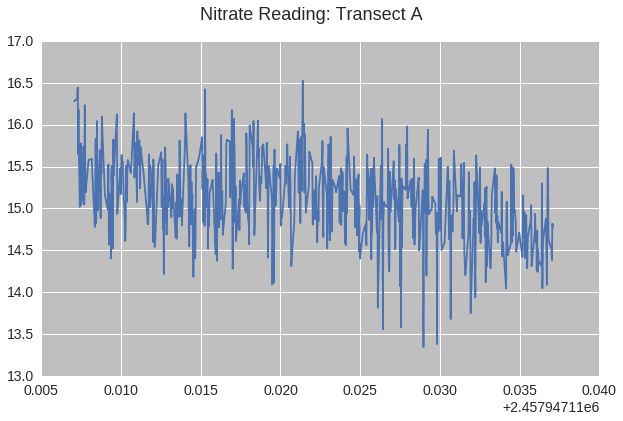

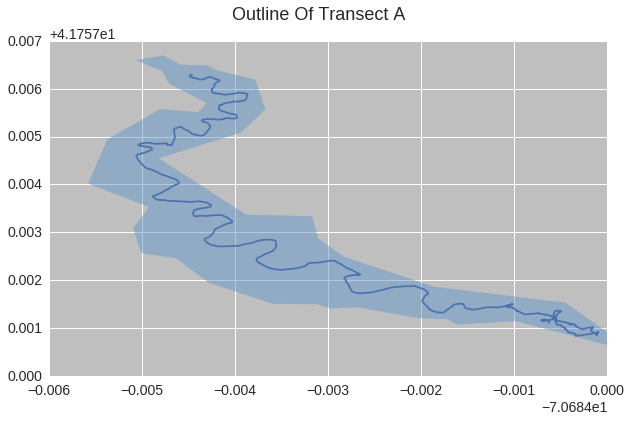

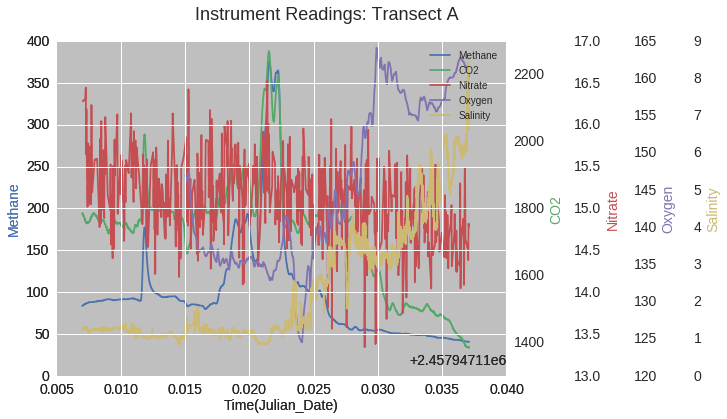

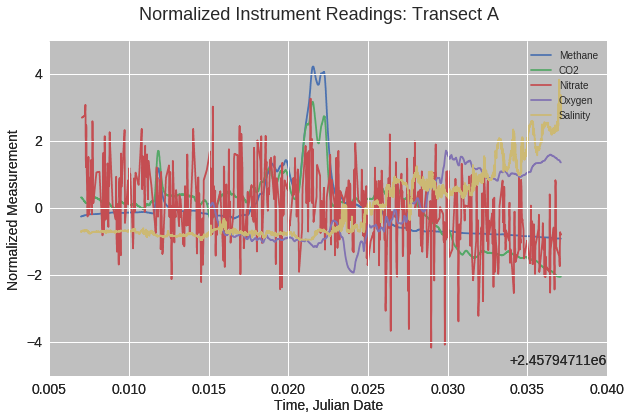

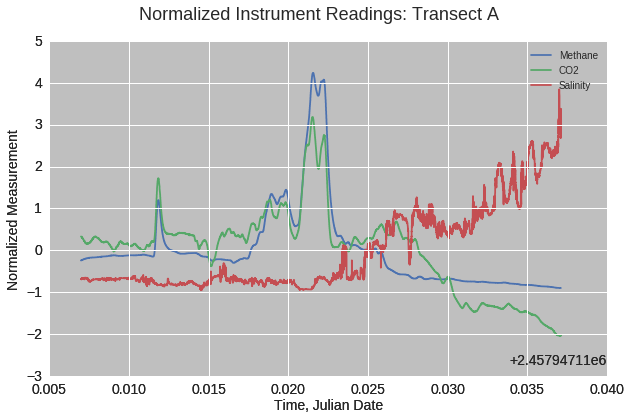

In [15]:
# Transect A
sp.plot_transectsuite(ta, "Transect A")

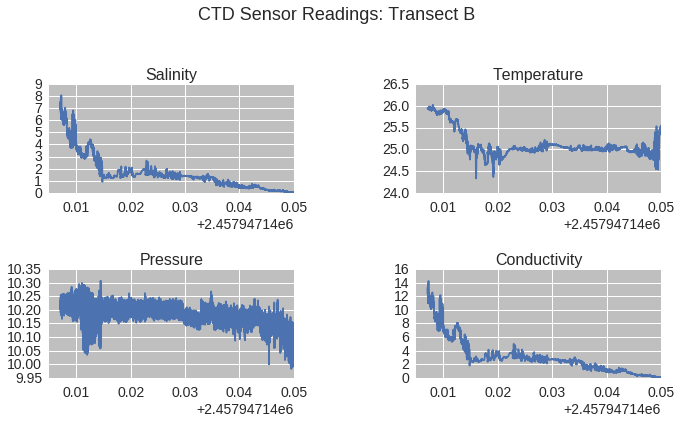

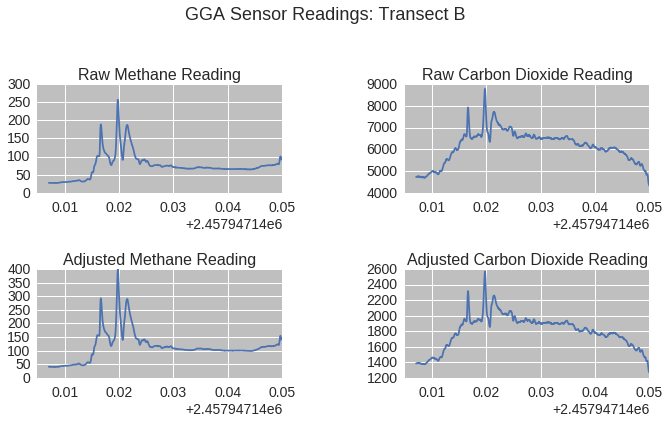

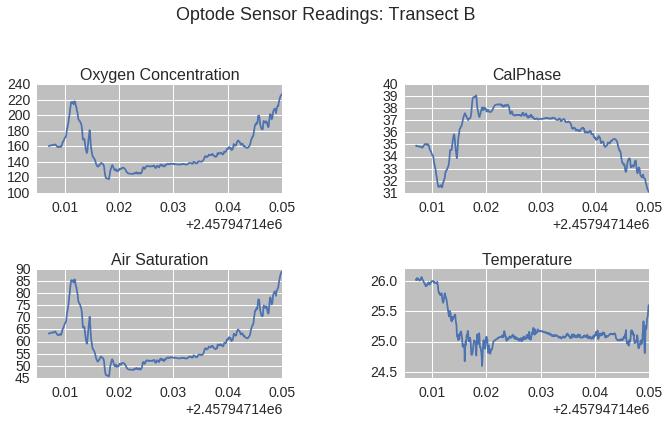

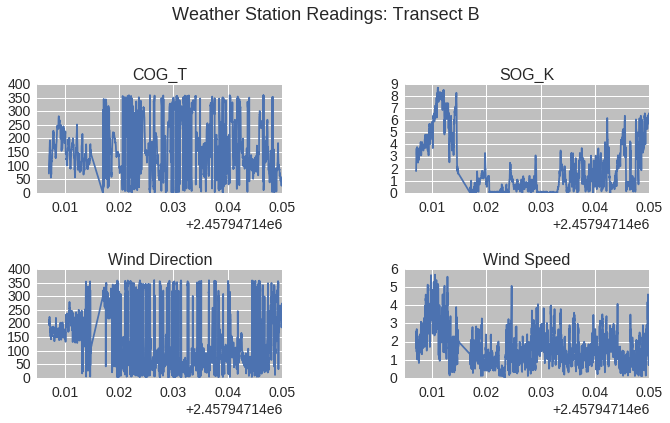

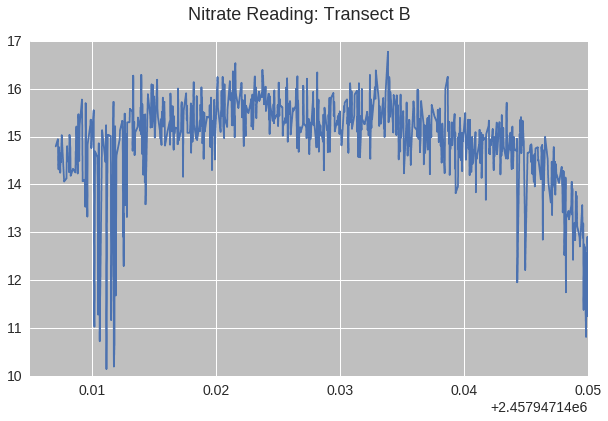

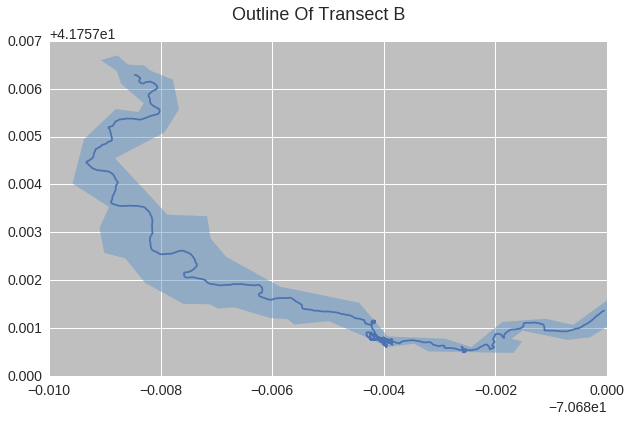

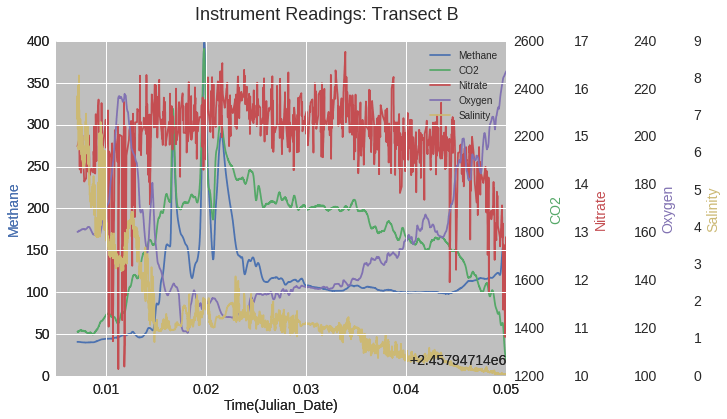

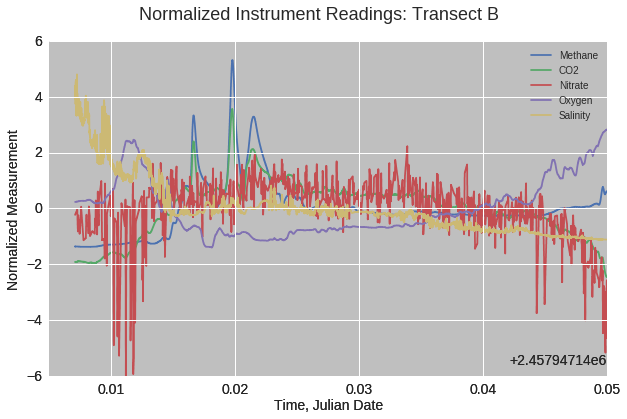

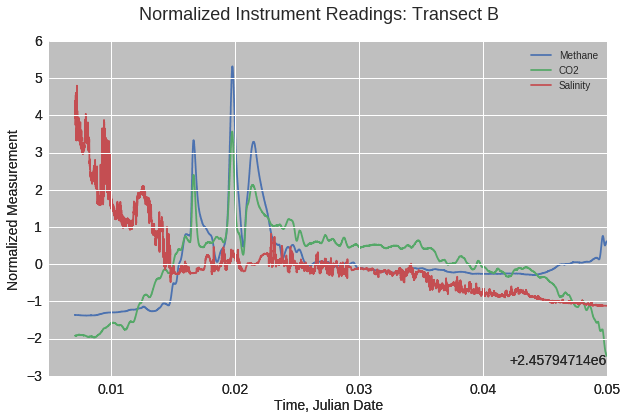

In [16]:
# Transect B
sp.plot_transectsuite(tb, 'Transect B')

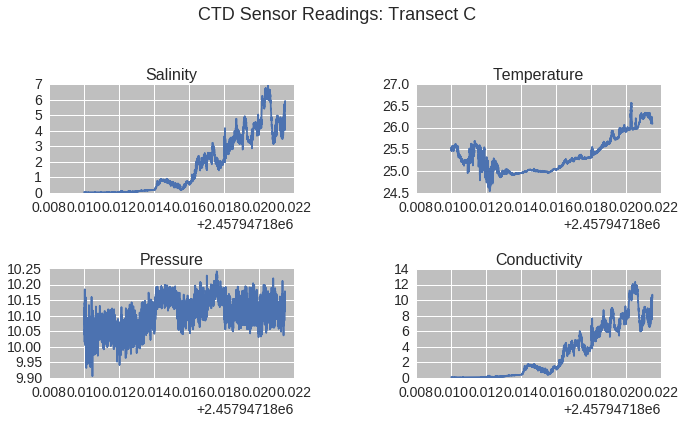

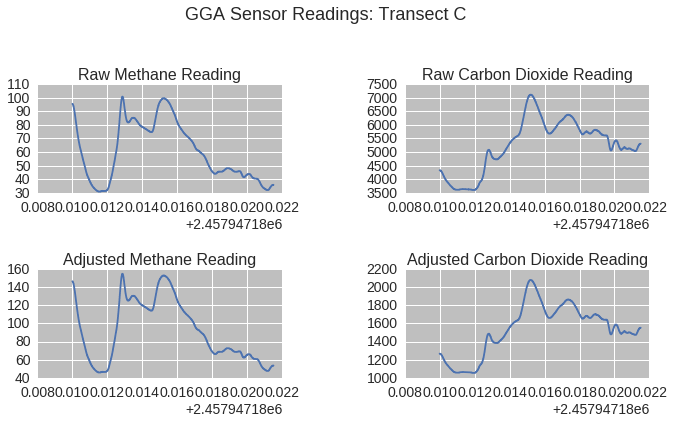

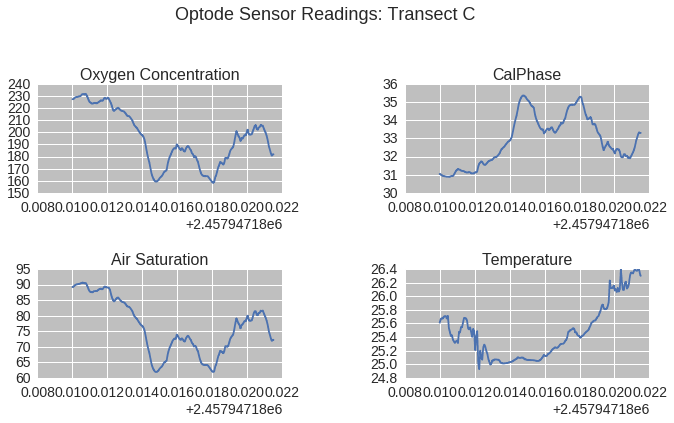

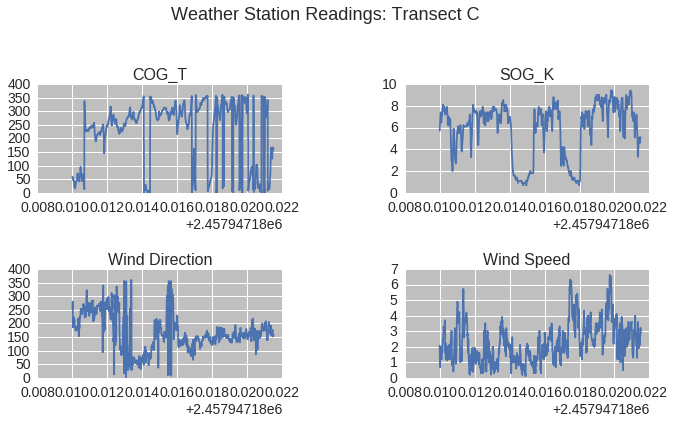

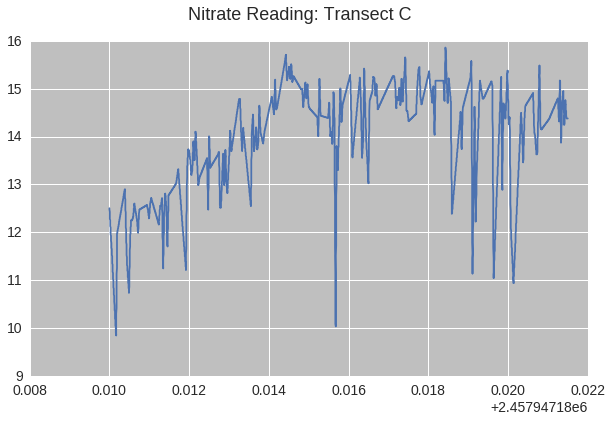

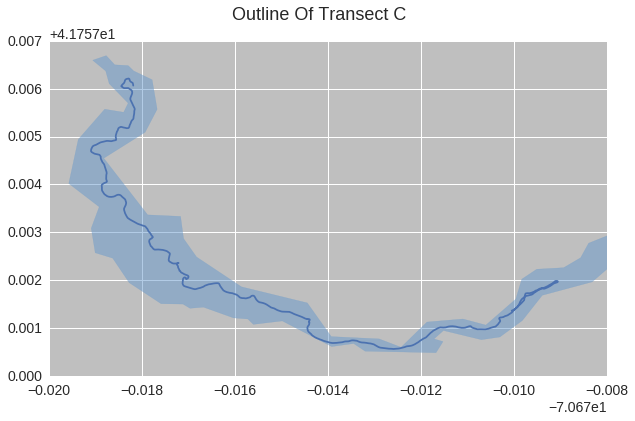

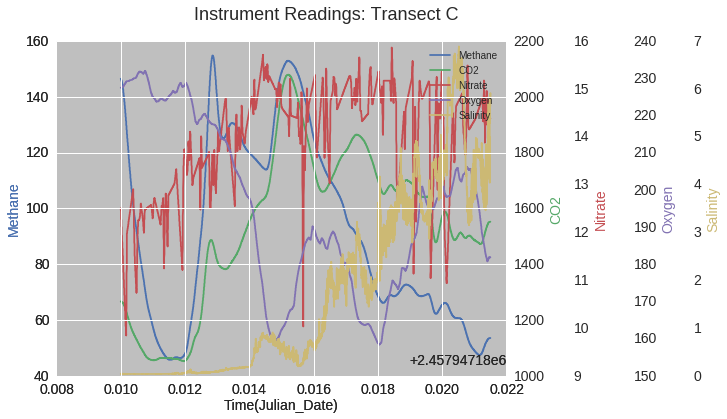

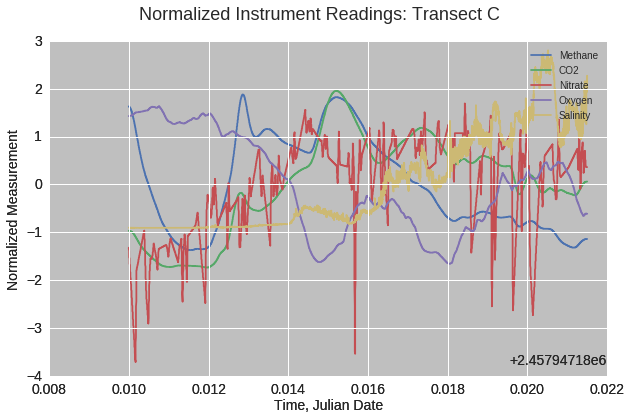

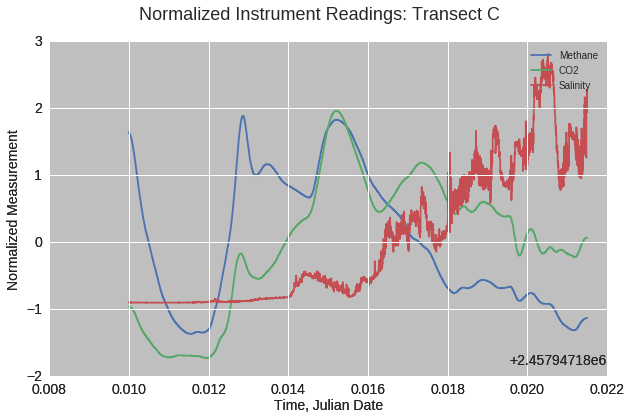

In [17]:
# Transect C
sp.plot_transectsuite(tc, 'Transect C')

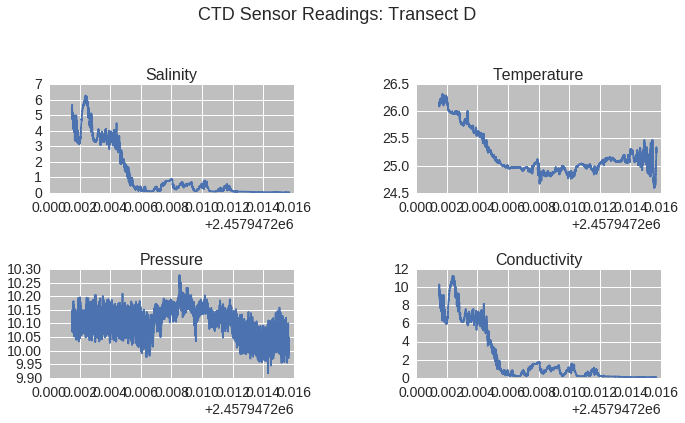

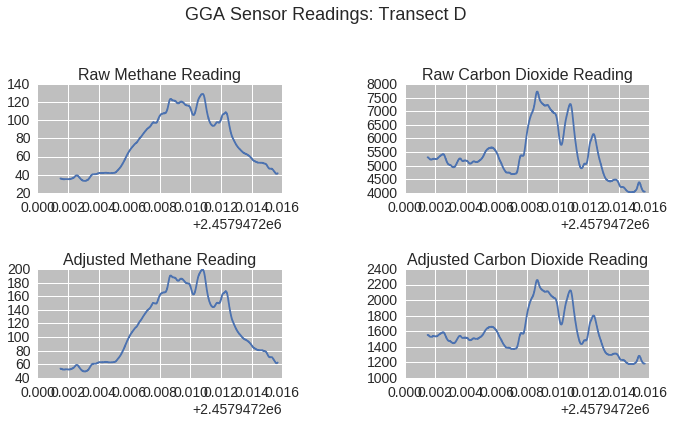

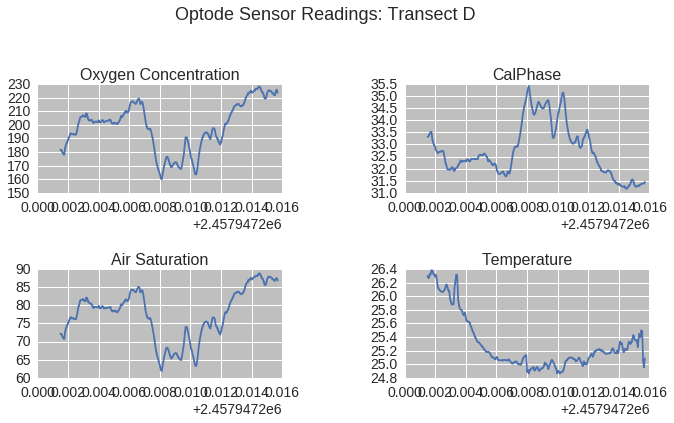

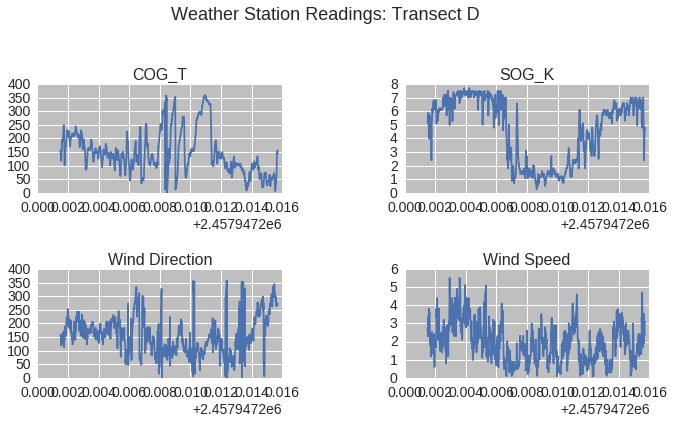

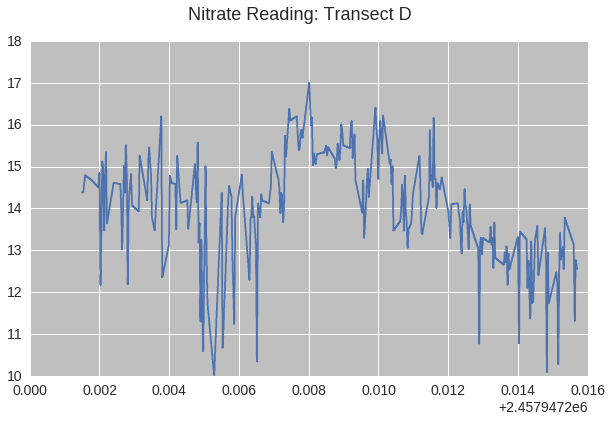

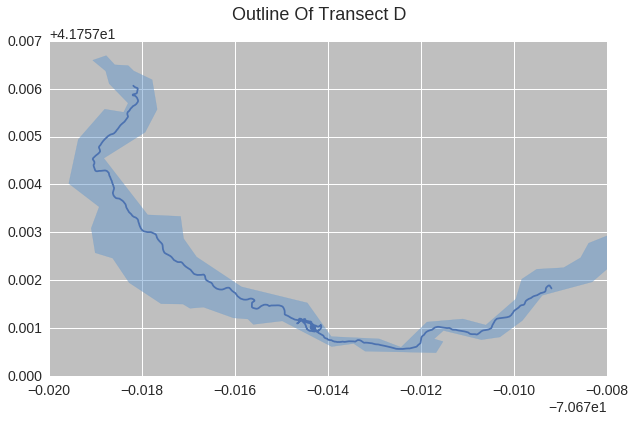

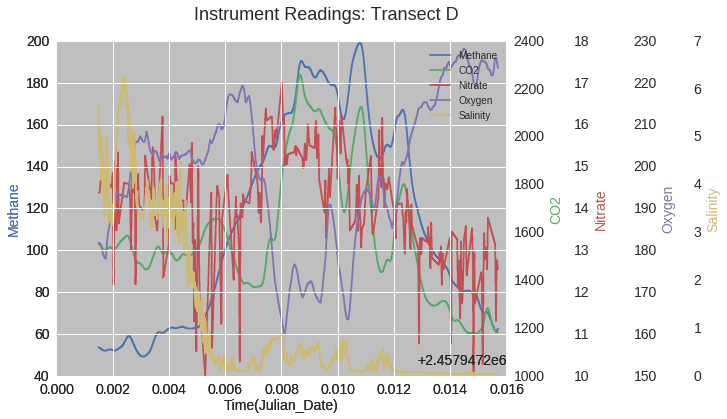

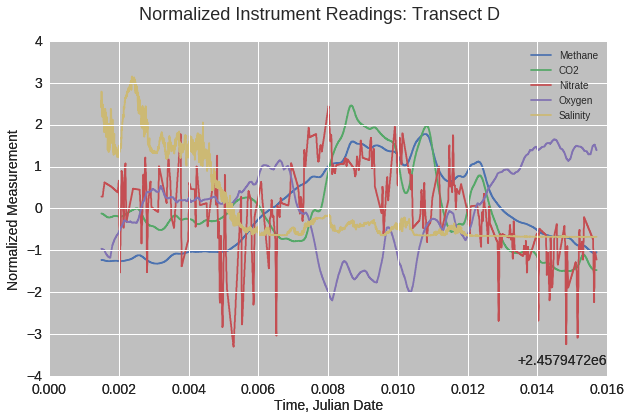

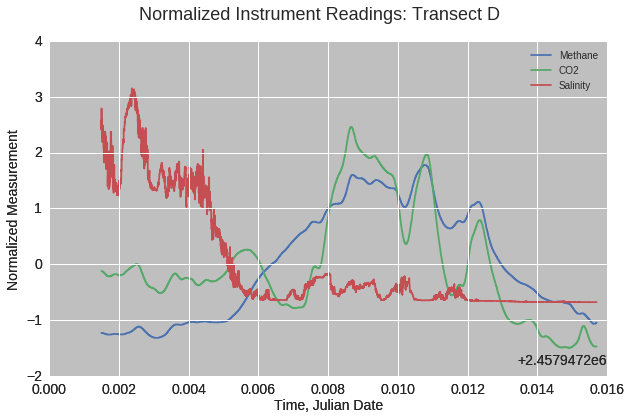

In [18]:
# Transect D
sp.plot_transectsuite(td, 'Transect D')

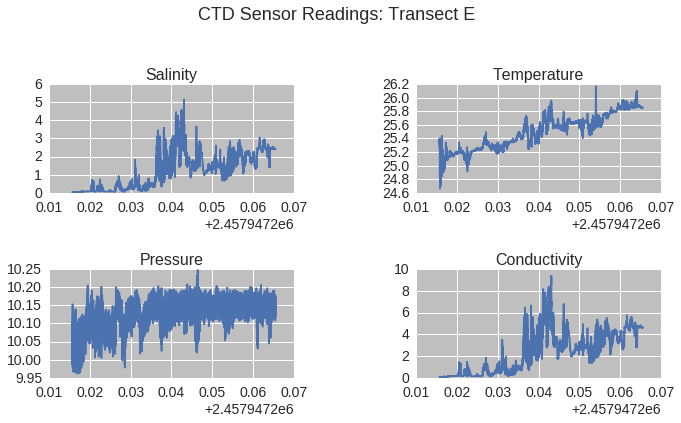

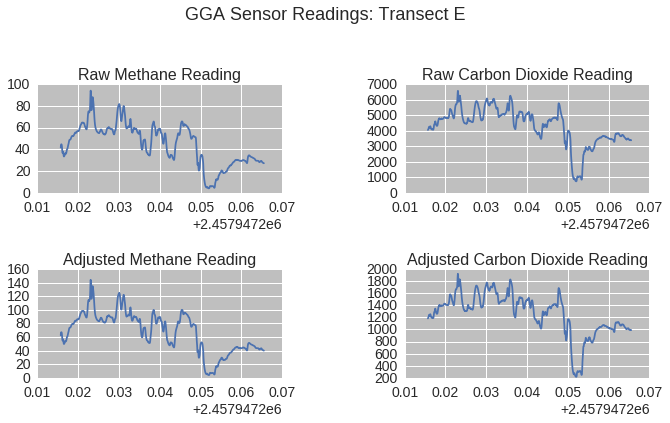

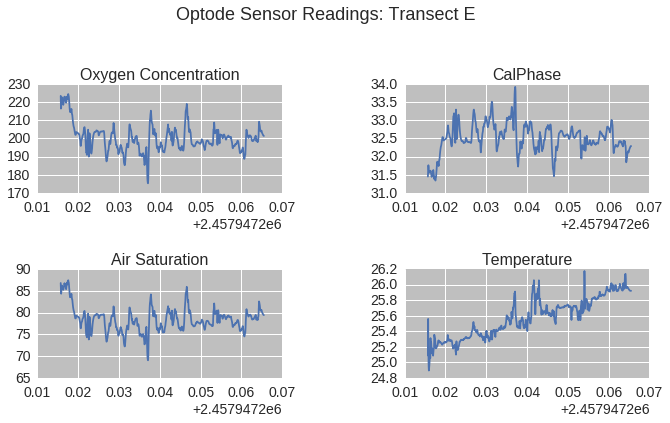

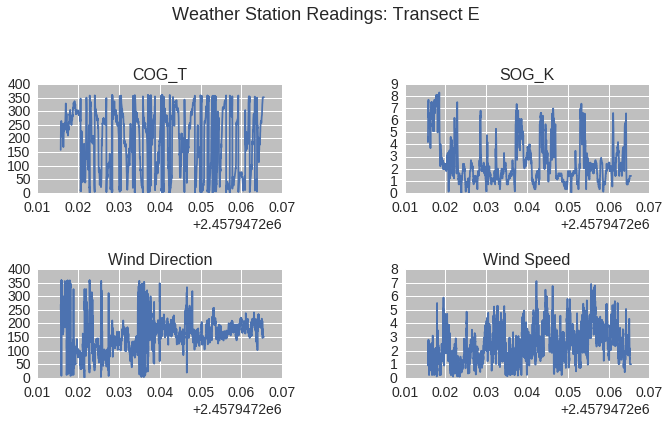

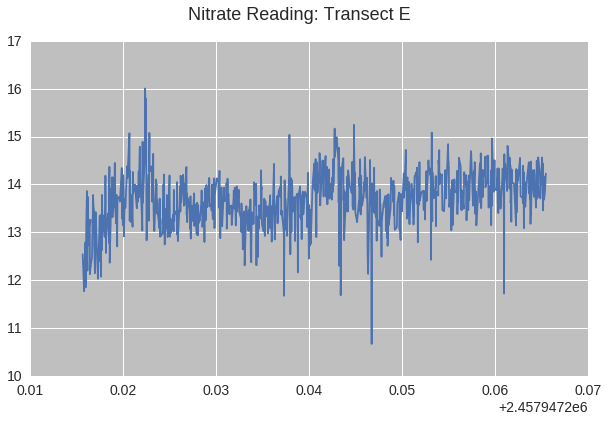

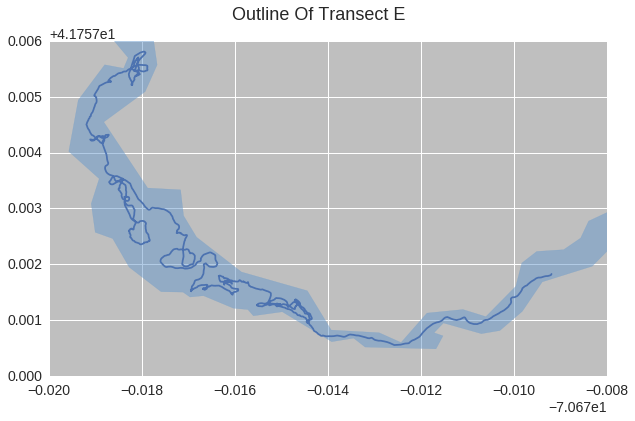

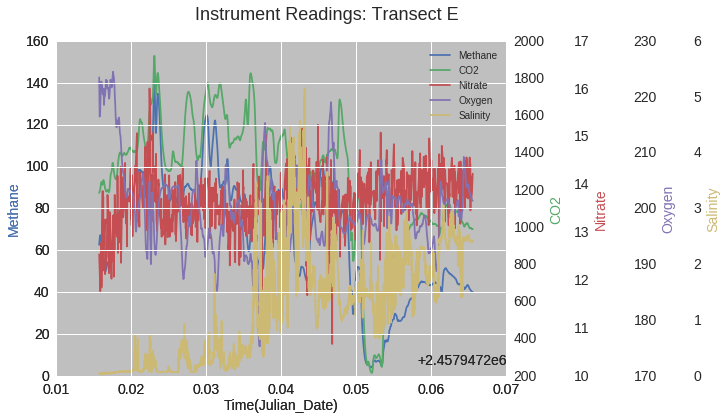

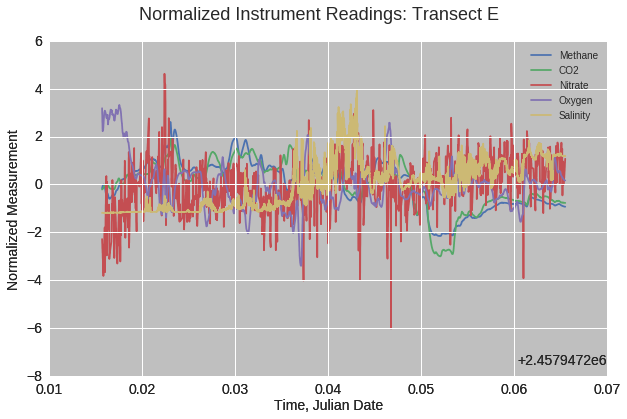

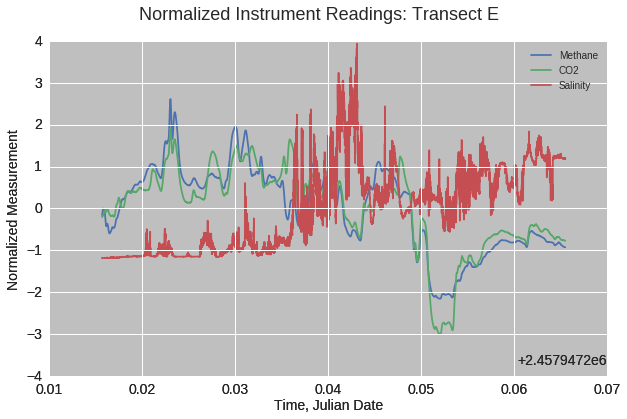

In [19]:
# Transect E
sp.plot_transectsuite(te, 'Transect E')

In [20]:
# Transect F
# sp.plot_transectsuite(tf, 'Transect F')

## Property Versus Property
Another way to look at the relationship between sensors is to plot them against one another. Following the same protoco, I first look at each instrument alone (if providing relevant information), multiple measures against others, and then break down each transect in the same way.

### Instruments

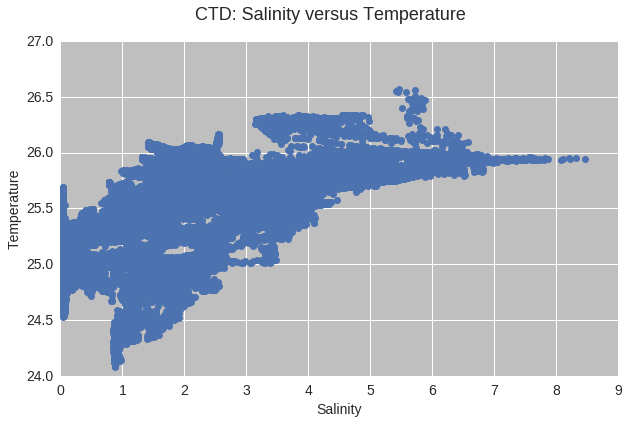

In [21]:
# CTD - let's look at Salinity and Temperature
sp.plot_pvp(ctd['Salinity'], ctd['Temperature'], ['Salinity', 'Temperature'], 'CTD: Salinity versus Temperature')

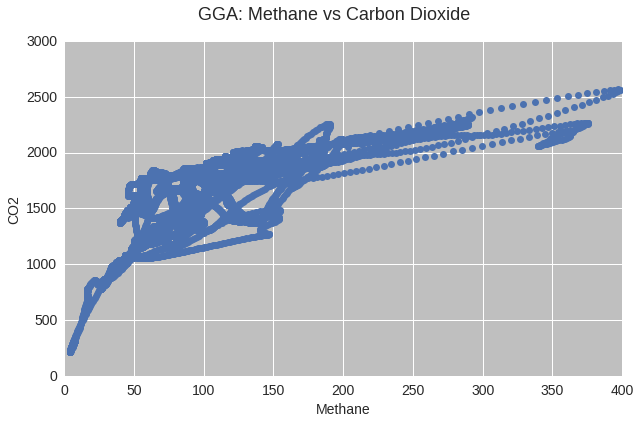

In [22]:
# GGA - let's look at Methane and CO2
sp.plot_pvp(gga['CH4_ppm_adjusted'], gga['CO2_ppm_adjusted'], ['Methane', 'CO2'], 'GGA: Methane vs Carbon Dioxide')

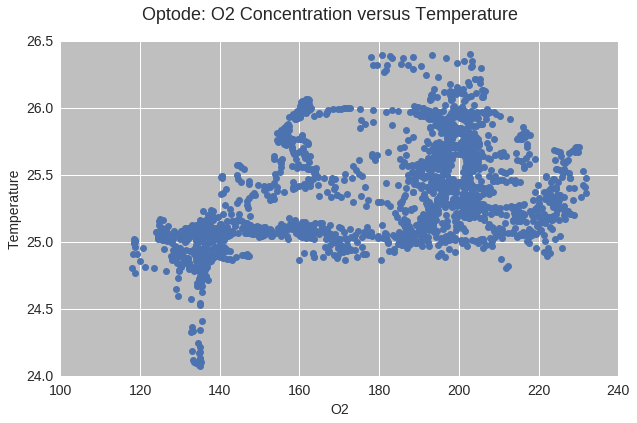

In [23]:
# Optode - let's look at Oxygen Concentration and Temperature

sp.plot_pvp(op['O2Concentration'], op['Temperature'], ['O2', 'Temperature'], 'Optode: O2 Concentration versus Temperature')

### Multiple Sensor Information

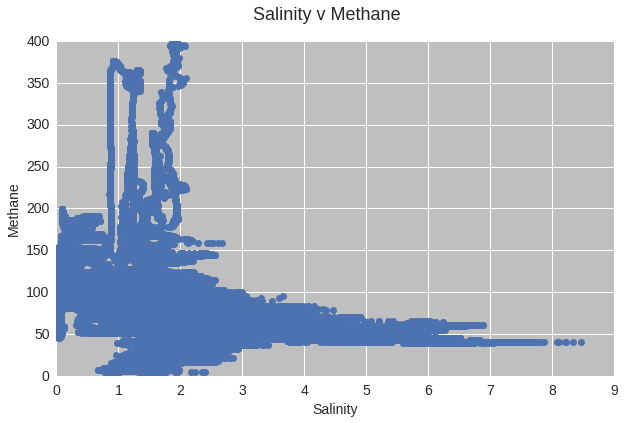

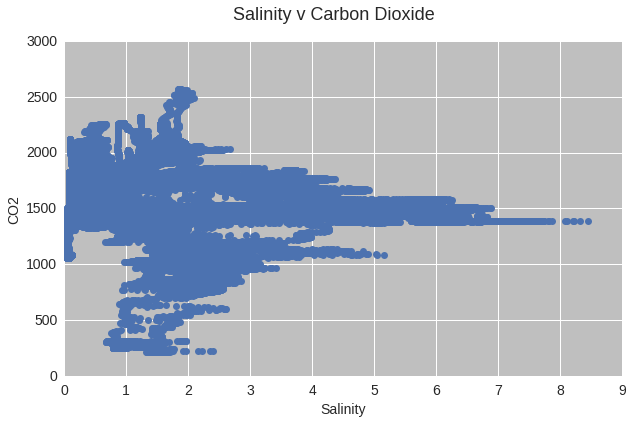

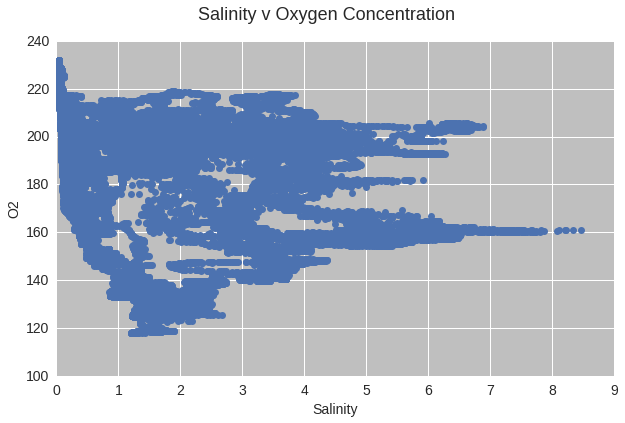

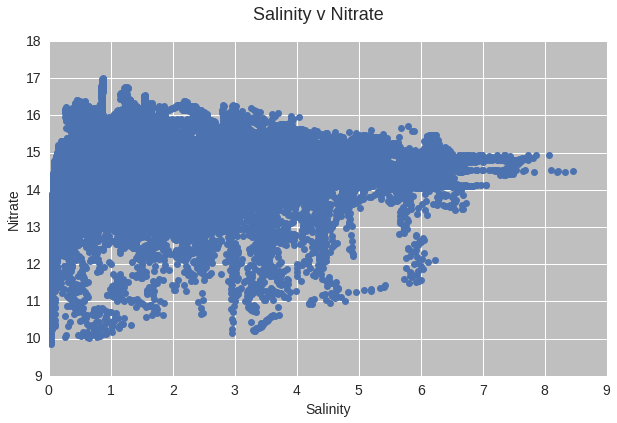

In [24]:
#let's look at salinity, methane, O2, nitrate, carbon dioxide, and temperature, Salinity Along X

sp.plot_pvp(df['ctd']['Salinity'], df['gga']['CH4_ppm_adjusted'], ['Salinity', 'Methane'], 'Salinity v Methane')
sp.plot_pvp(df['ctd']['Salinity'], df['gga']['CO2_ppm_adjusted'], ['Salinity', 'CO2'], 'Salinity v Carbon Dioxide')
sp.plot_pvp(df['ctd']['Salinity'], df['op']['O2Concentration'], ['Salinity', 'O2'], 'Salinity v Oxygen Concentration')
sp.plot_pvp(df['ctd']['Salinity'], df['nitrate']['0.00'], ['Salinity', 'Nitrate'], 'Salinity v Nitrate')

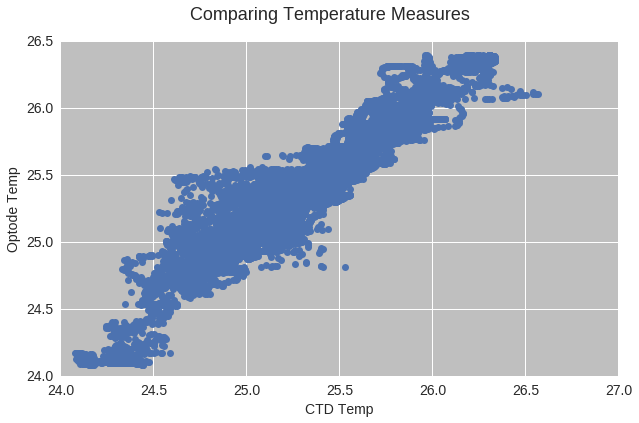

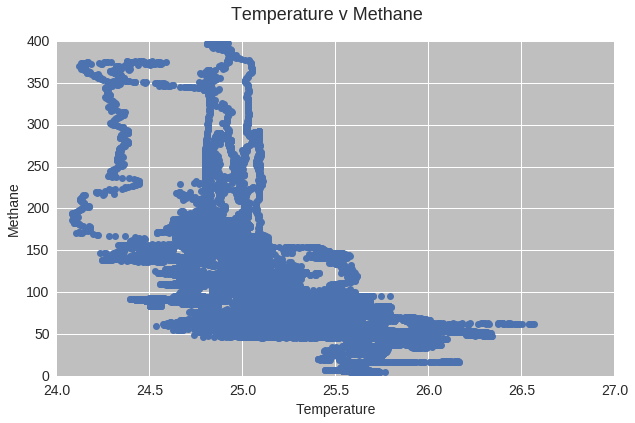

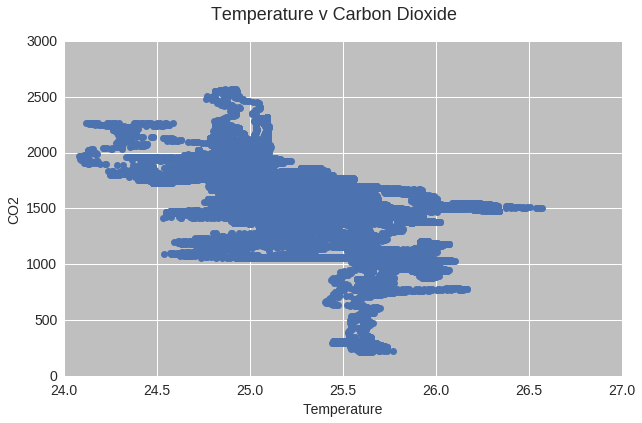

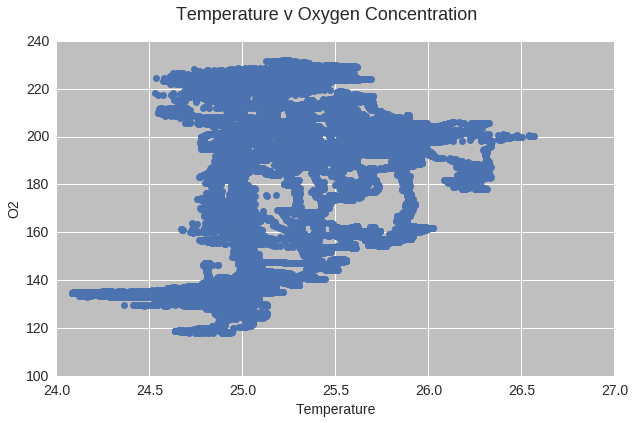

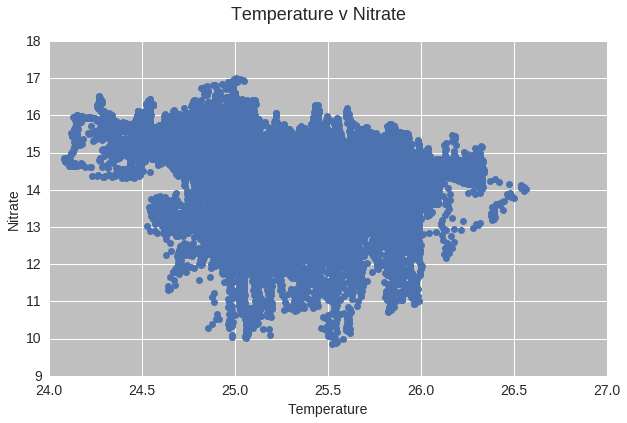

In [25]:
# Now temperature along Xs
sp.plot_pvp(df['ctd']['Temperature'], df['op']['Temperature'], ['CTD Temp', 'Optode Temp'], 'Comparing Temperature Measures')
sp.plot_pvp(df['ctd']['Temperature'], df['gga']['CH4_ppm_adjusted'], ['Temperature', 'Methane'], 'Temperature v Methane')
sp.plot_pvp(df['ctd']['Temperature'], df['gga']['CO2_ppm_adjusted'], ['Temperature', 'CO2'], 'Temperature v Carbon Dioxide')
sp.plot_pvp(df['ctd']['Temperature'], df['op']['O2Concentration'], ['Temperature', 'O2'], 'Temperature v Oxygen Concentration')
sp.plot_pvp(df['ctd']['Temperature'], df['nitrate']['0.00'], ['Temperature', 'Nitrate'], 'Temperature v Nitrate')

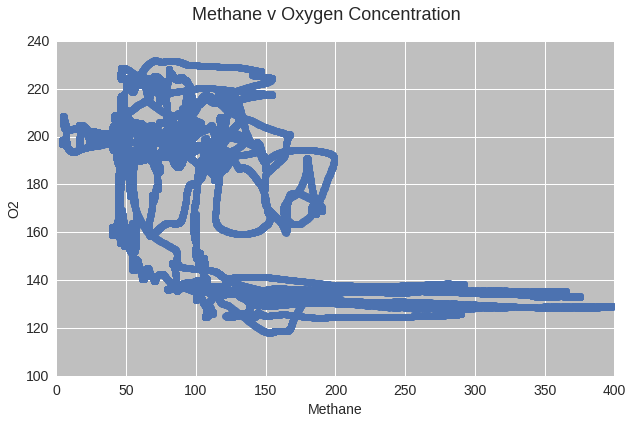

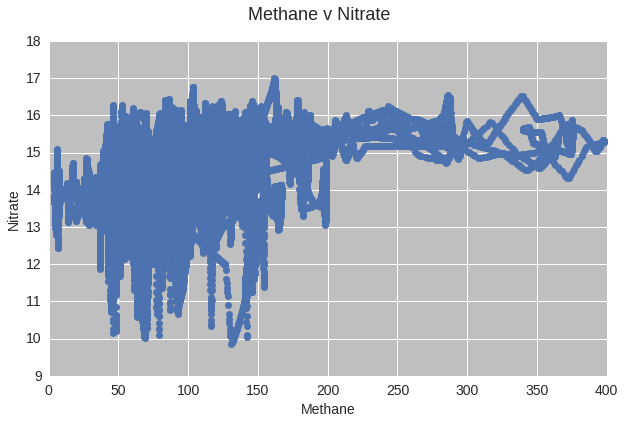

In [26]:
# Methane along x
sp.plot_pvp(df['gga']['CH4_ppm_adjusted'], df['op']['O2Concentration'], ['Methane', 'O2'], 'Methane v Oxygen Concentration')
sp.plot_pvp(df['gga']['CH4_ppm_adjusted'], df['nitrate']['0.00'], ['Methane', 'Nitrate'], 'Methane v Nitrate')

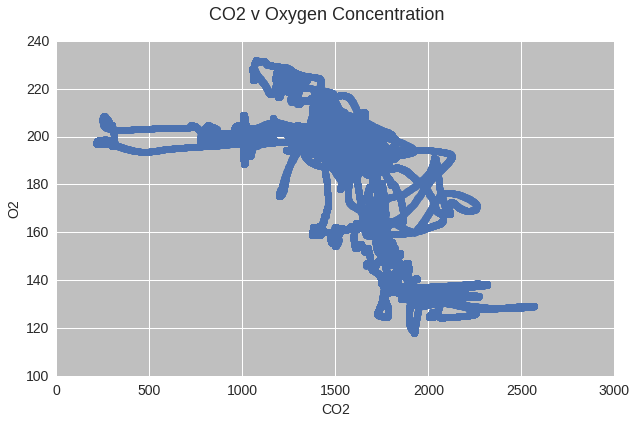

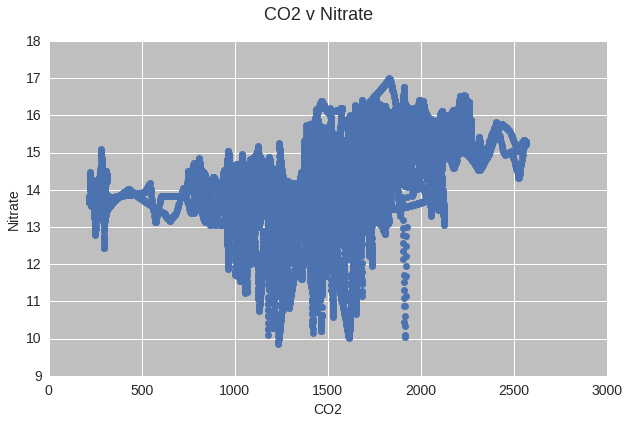

In [27]:
# CO2 along X
sp.plot_pvp(df['gga']['CO2_ppm_adjusted'], df['op']['O2Concentration'], ['CO2', 'O2'], 'CO2 v Oxygen Concentration')
sp.plot_pvp(df['gga']['CO2_ppm_adjusted'], df['nitrate']['0.00'], ['CO2', 'Nitrate'], 'CO2 v Nitrate')

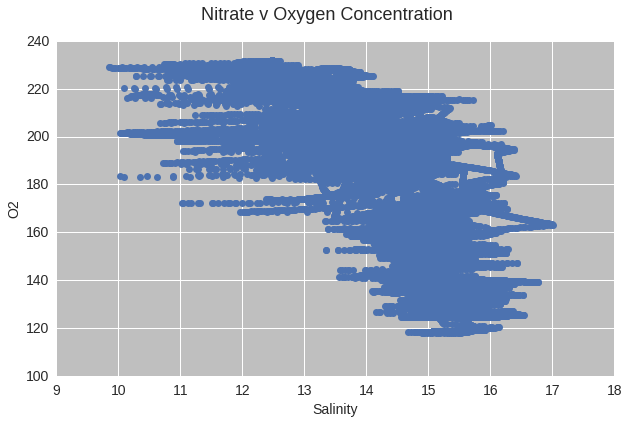

In [28]:
# Nitrate along X
sp.plot_pvp(df['nitrate']['0.00'], df['op']['O2Concentration'], ['Salinity', 'O2'], 'Nitrate v Oxygen Concentration')

### Looking at Transects
Now, we do the following comparisons, but along the transect division

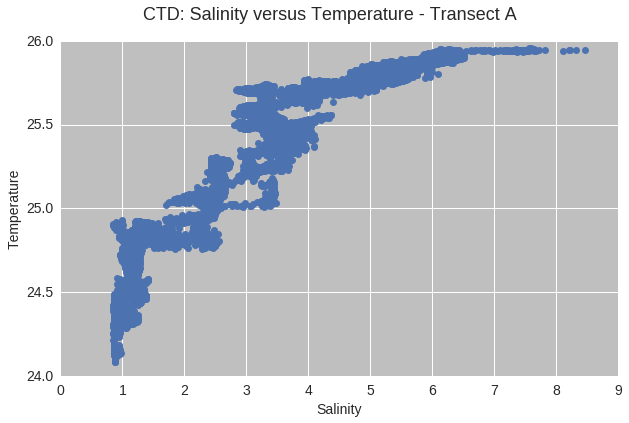

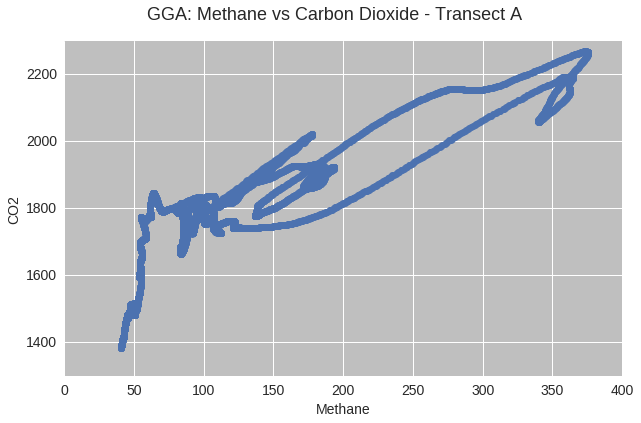

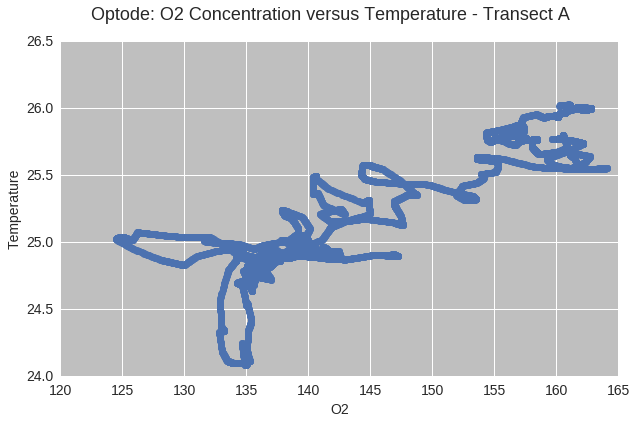

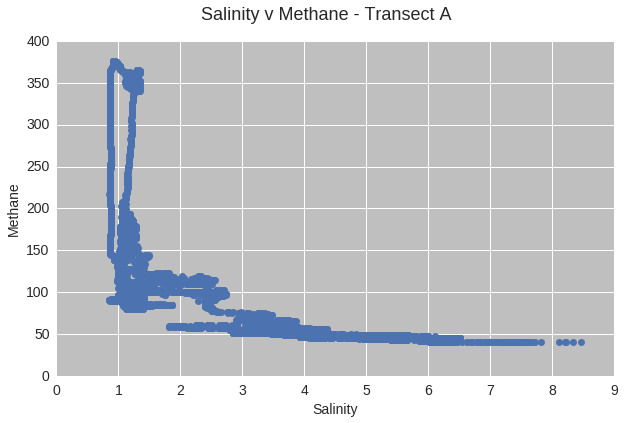

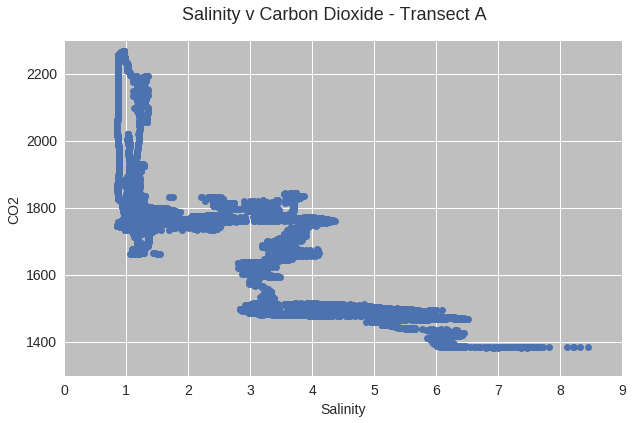

...

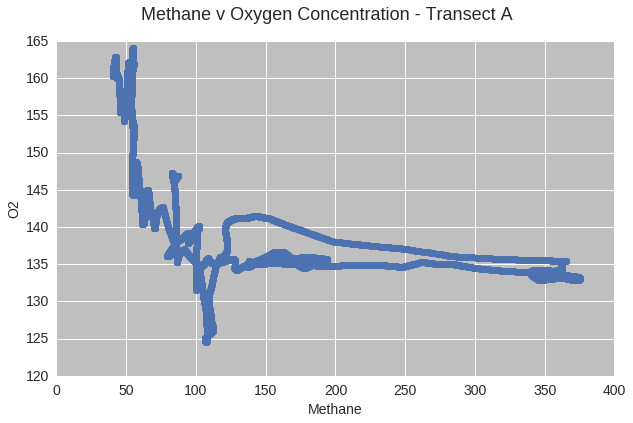

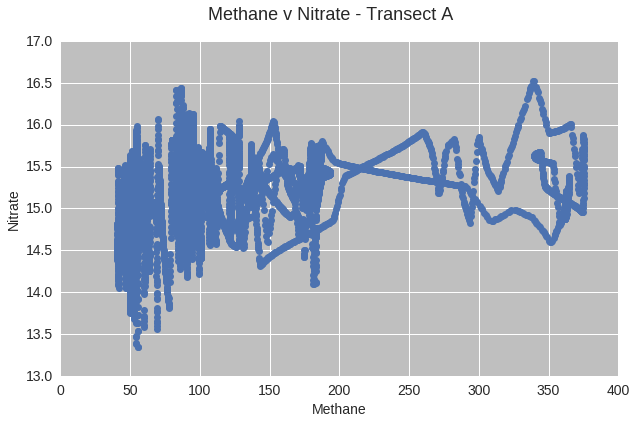

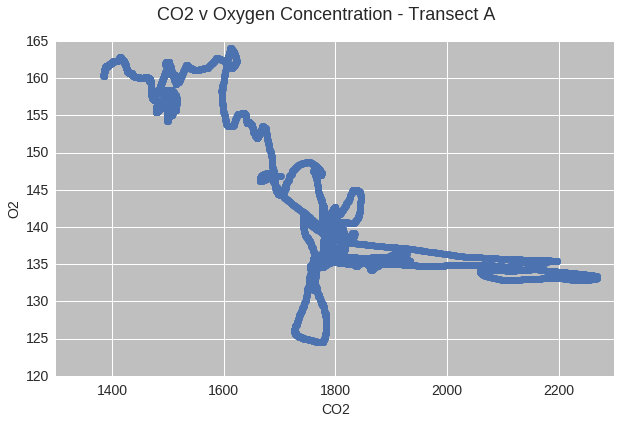

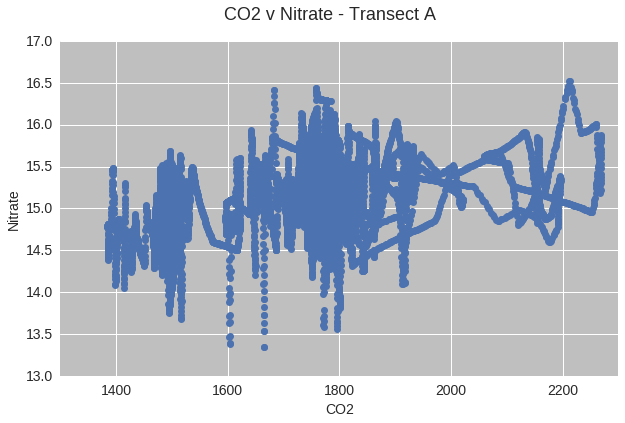

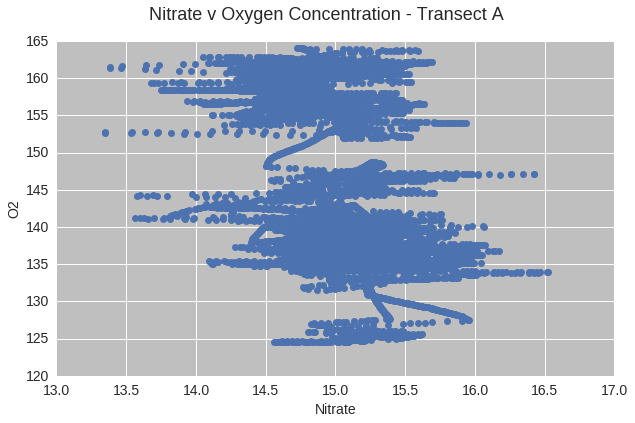

In [29]:
sp.plot_pvptransect(ta, "Transect A")

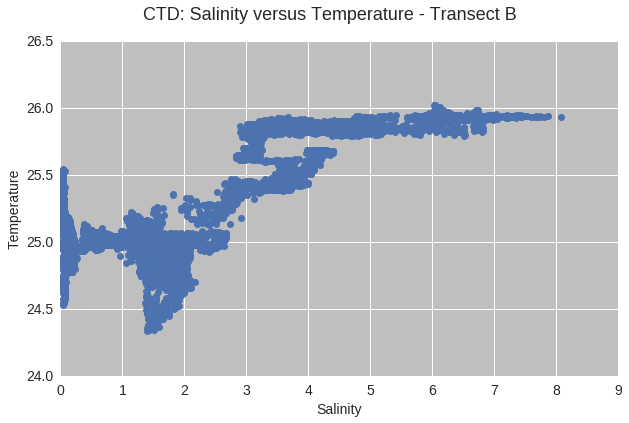

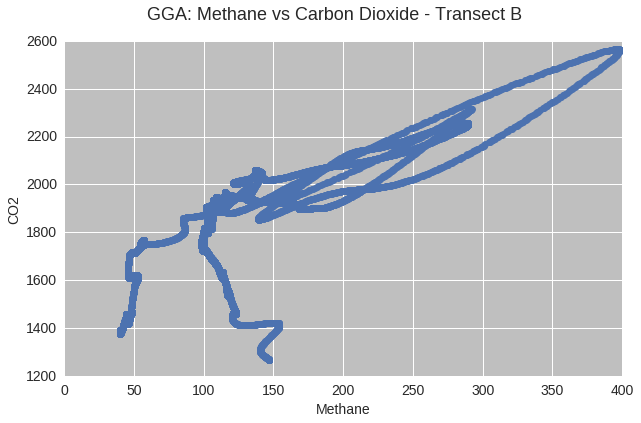

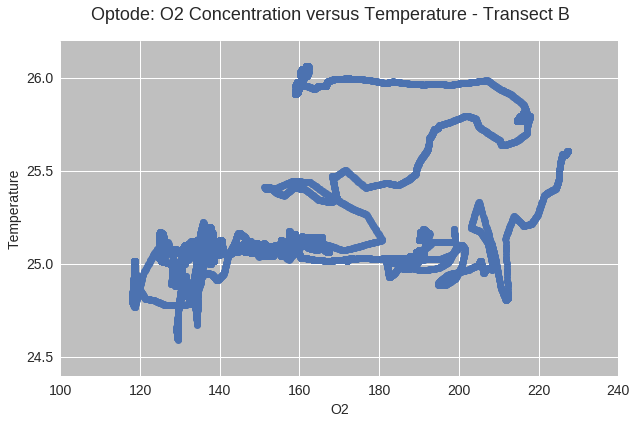

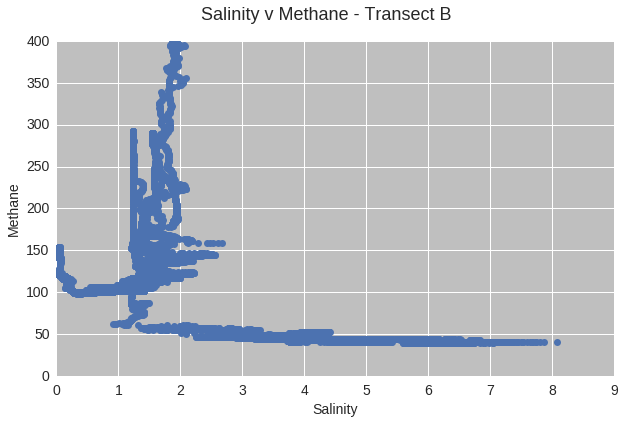

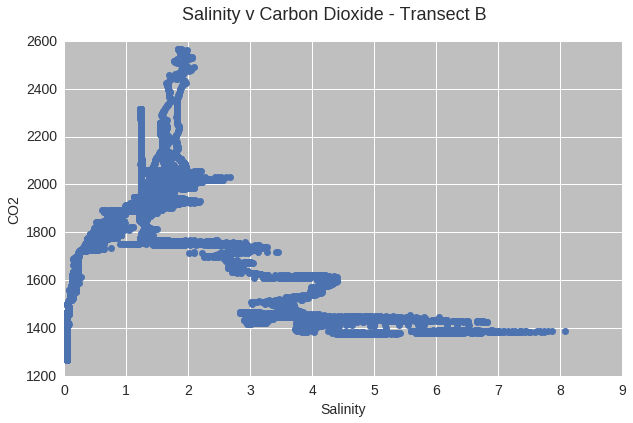

...

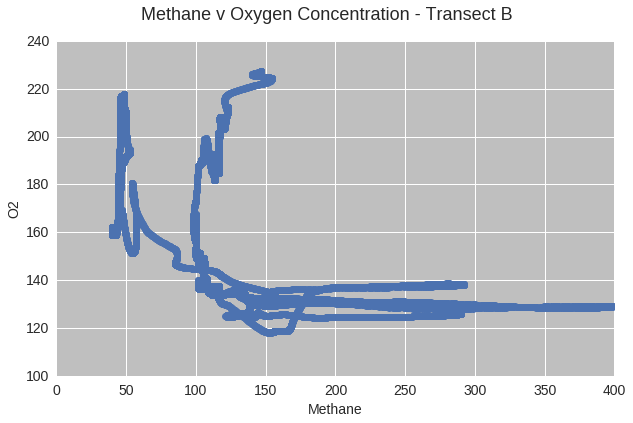

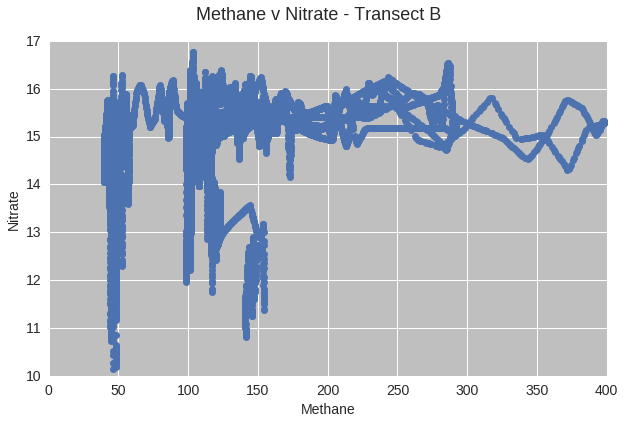

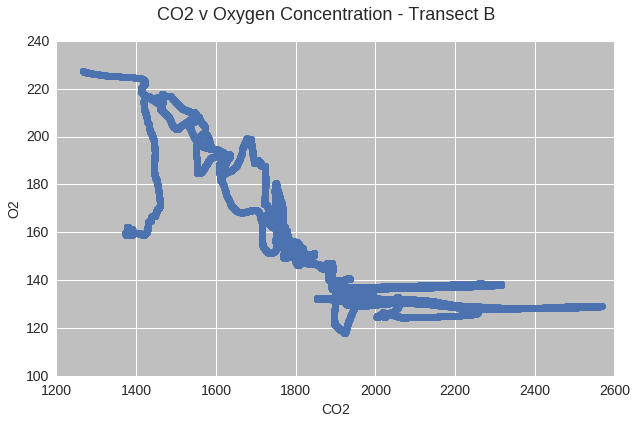

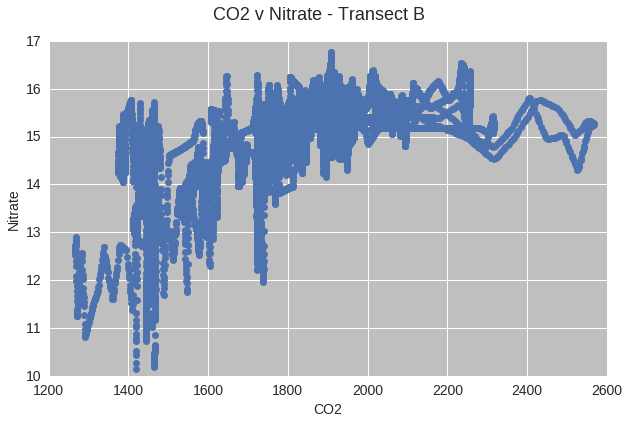

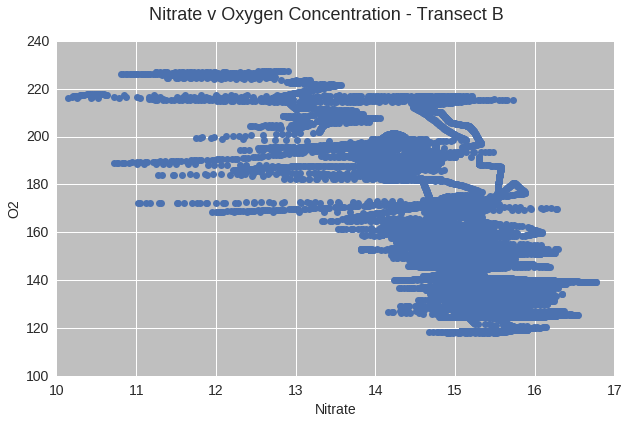

In [30]:
sp.plot_pvptransect(tb, "Transect B")

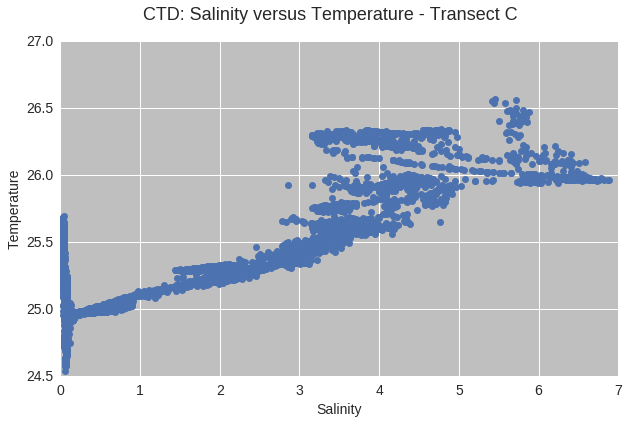

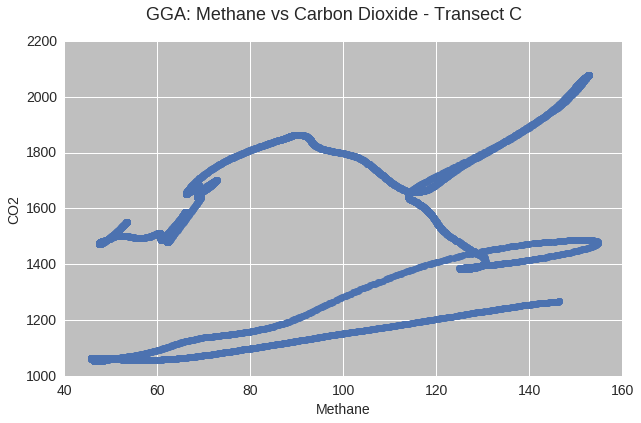

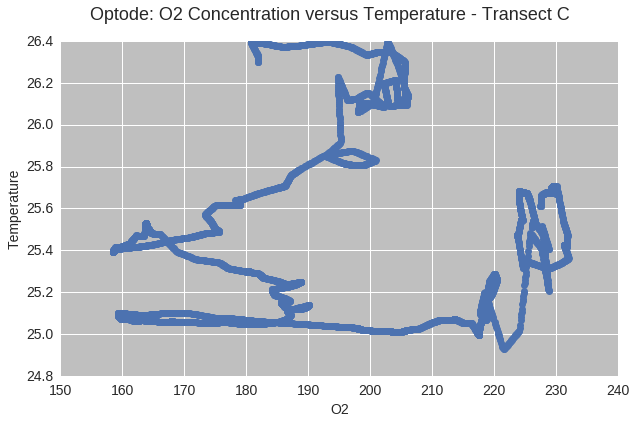

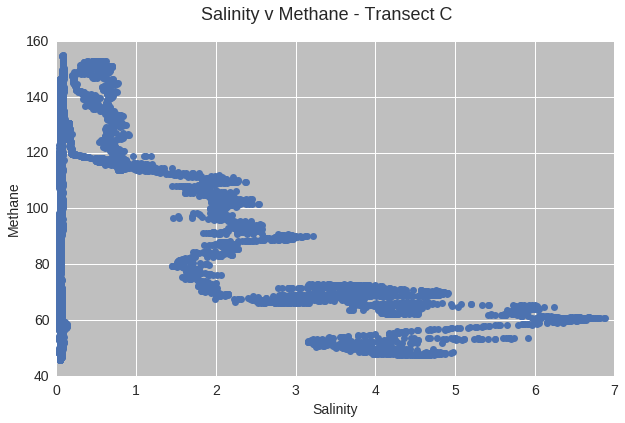

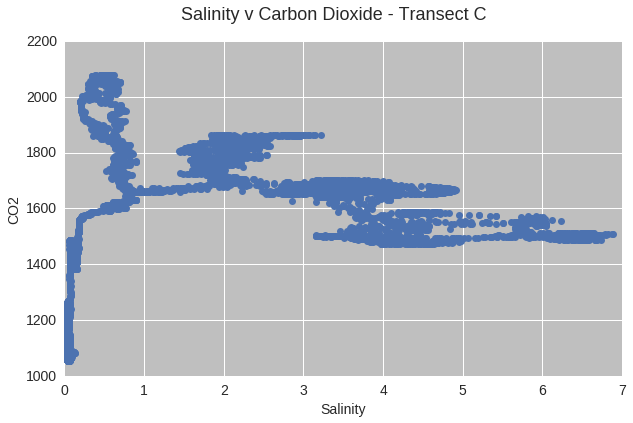

...

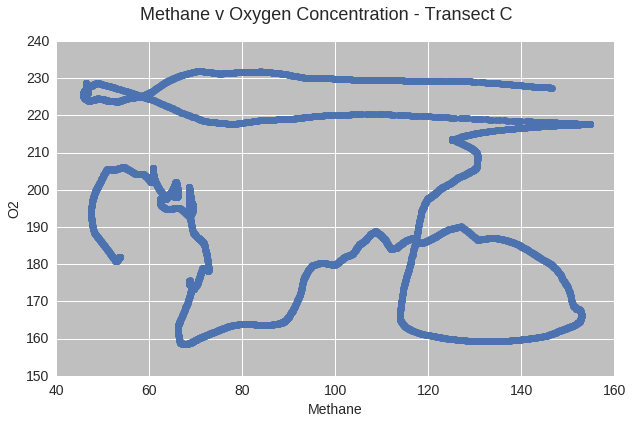

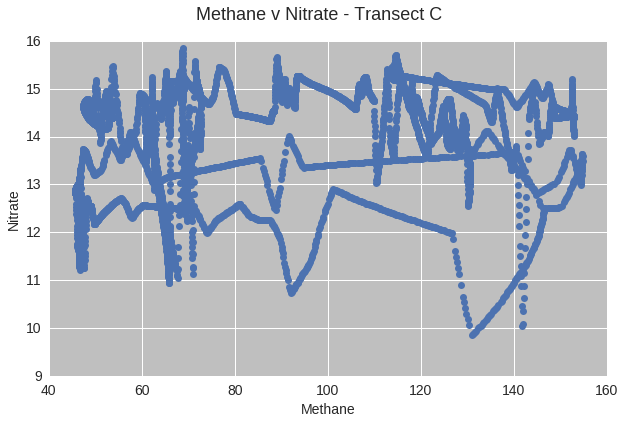

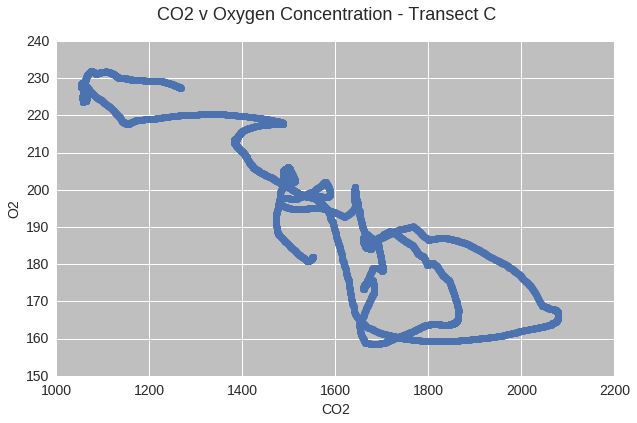

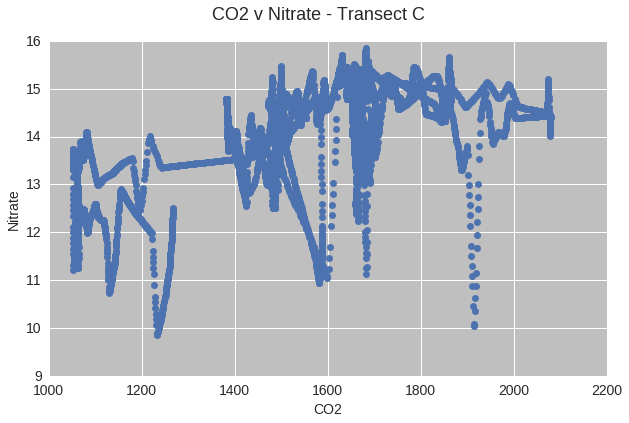

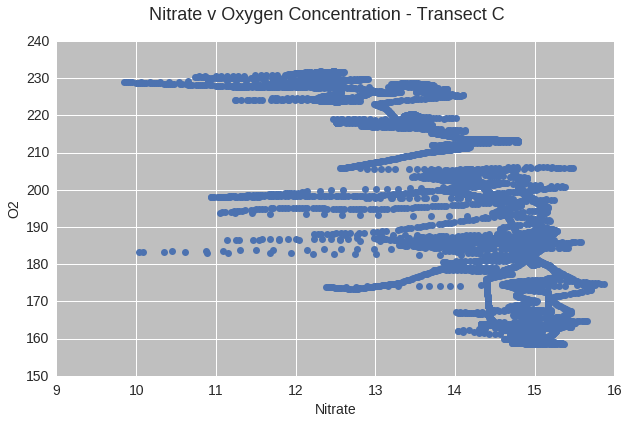

In [31]:
sp.plot_pvptransect(tc, "Transect C")

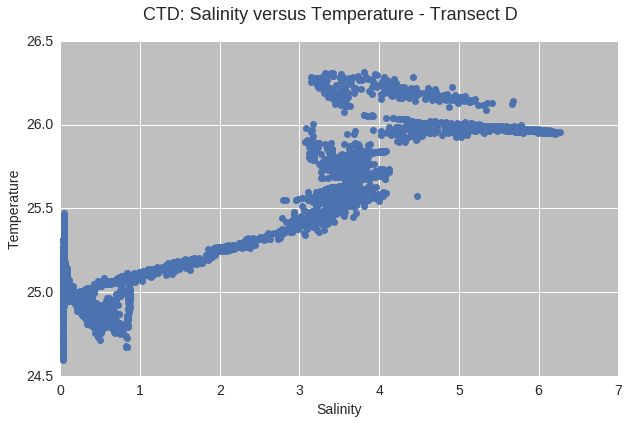

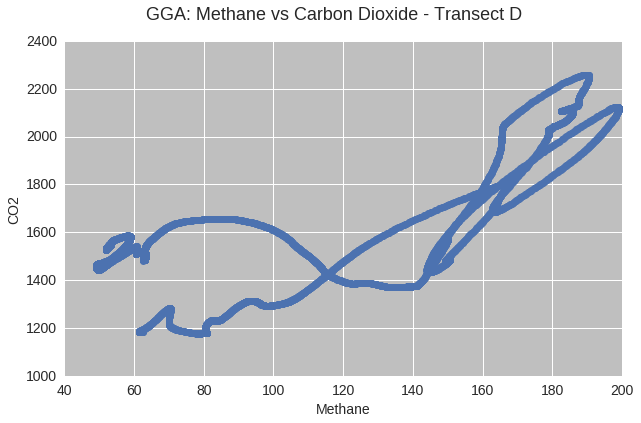

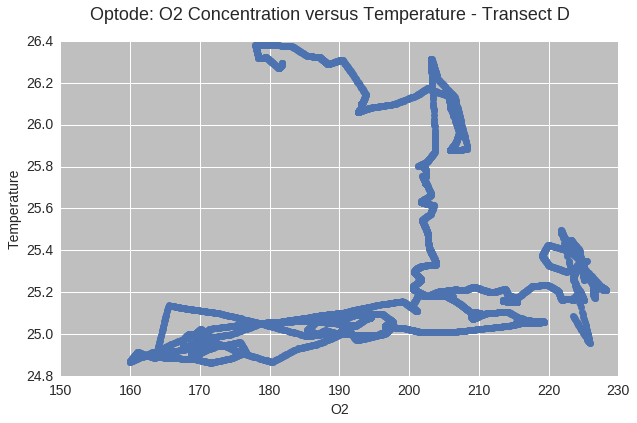

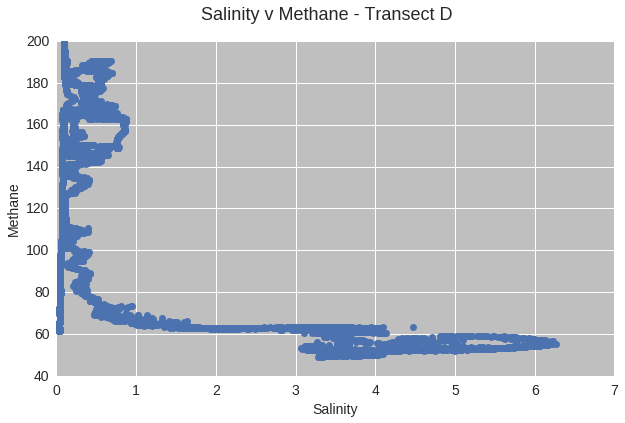

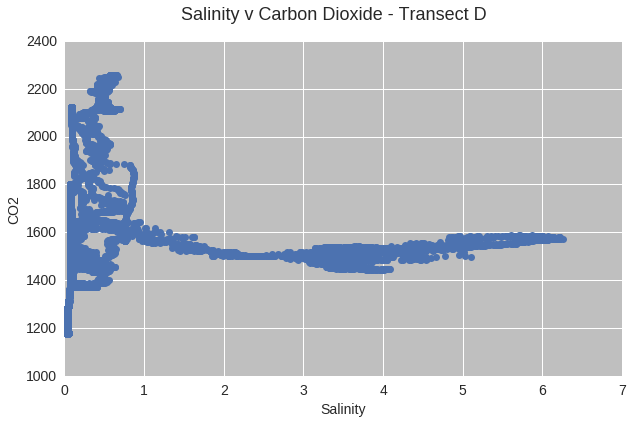

...

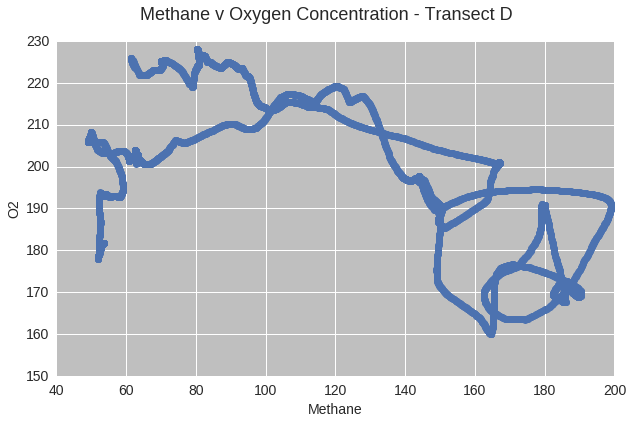

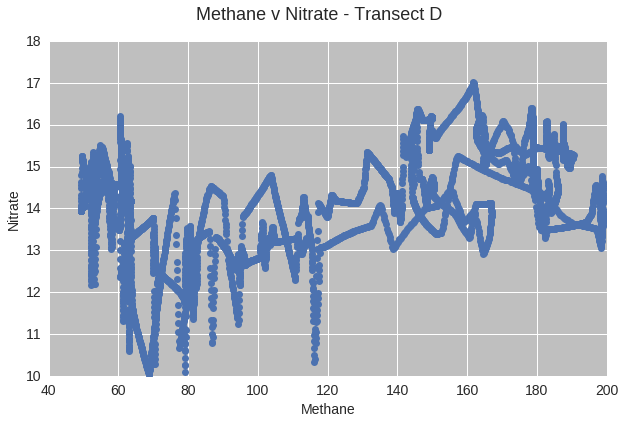

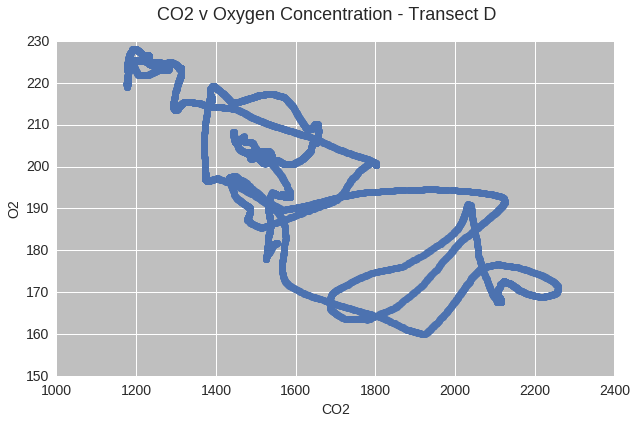

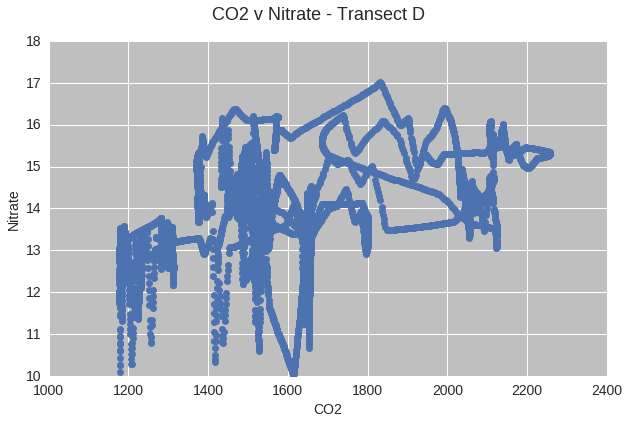

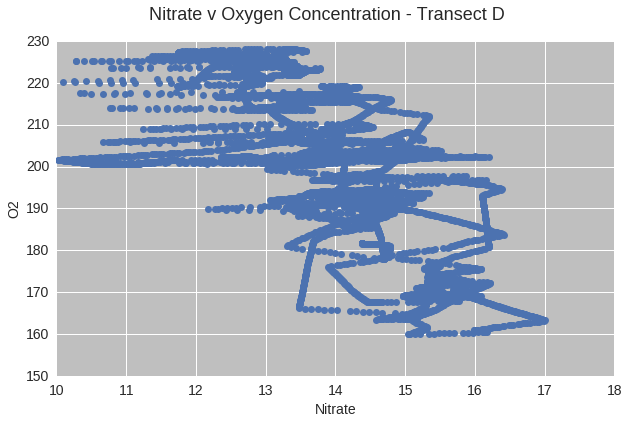

In [32]:
sp.plot_pvptransect(td, "Transect D")

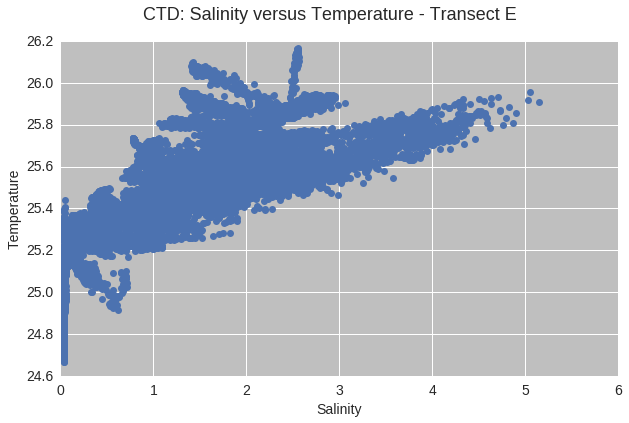

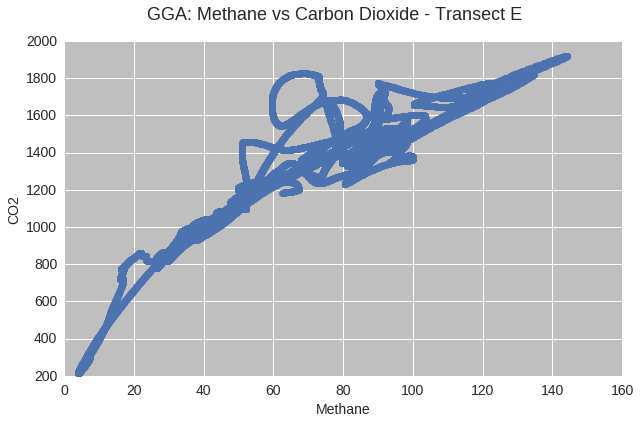

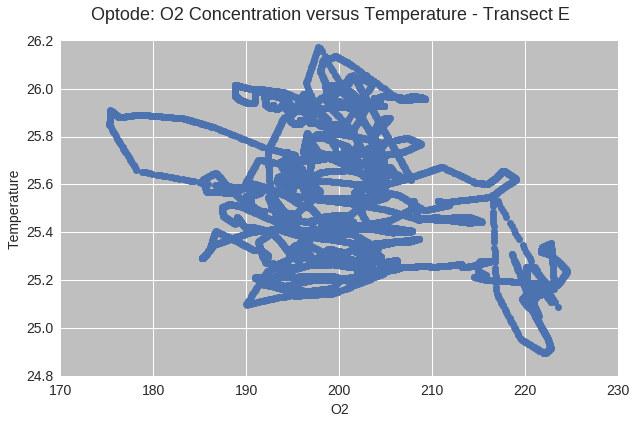

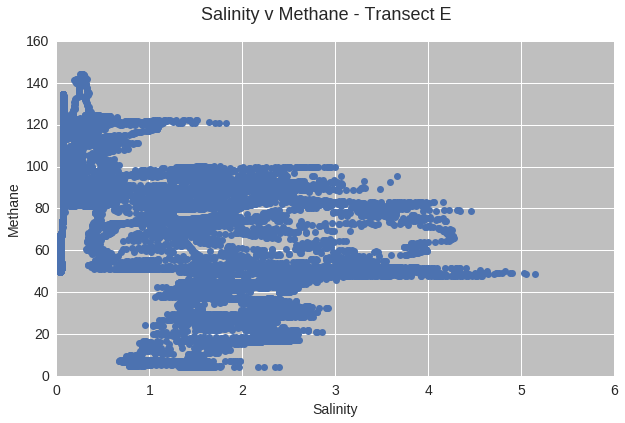

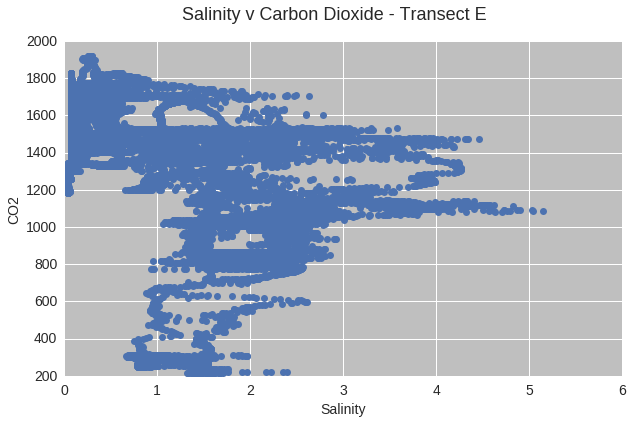

...

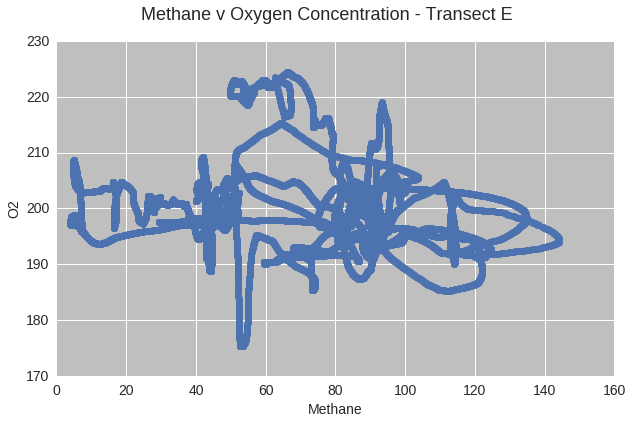

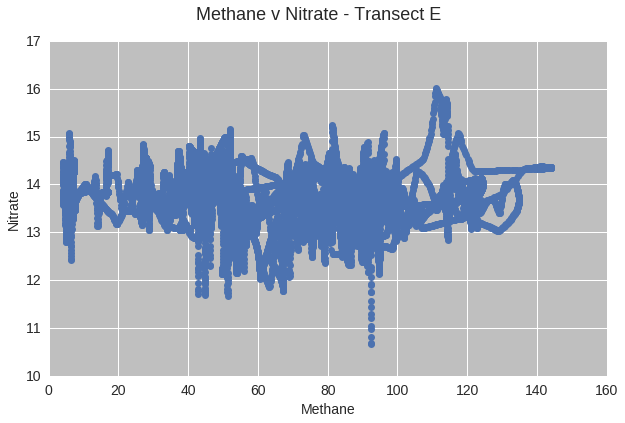

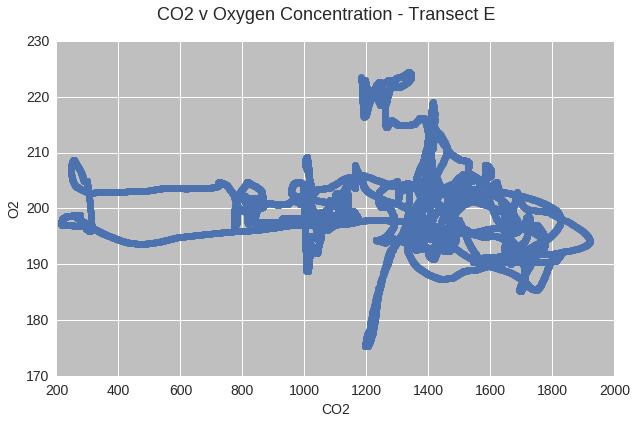

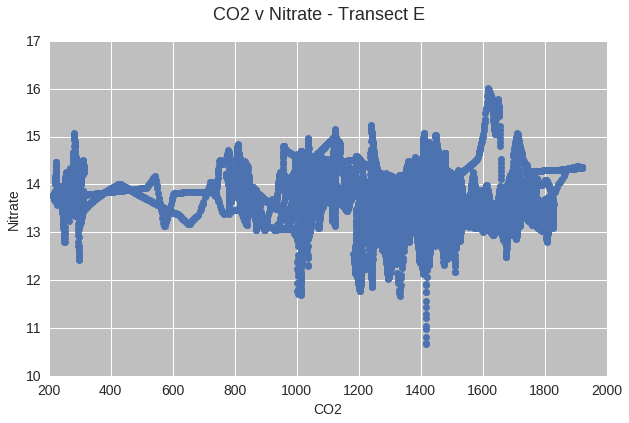

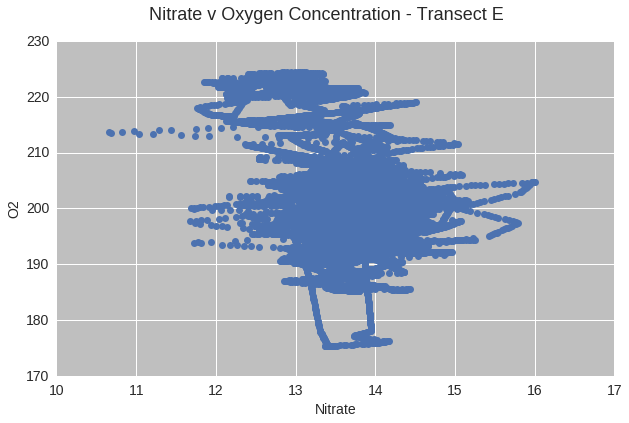

In [33]:
sp.plot_pvptransect(te, "Transect E")

## Spatial Relationships
Now, let's look at data in relation to the measurement location. I will focus on Salinity, Temperature, Methane, CO2, O2, and nitrate.

### All Data - Across all Transects

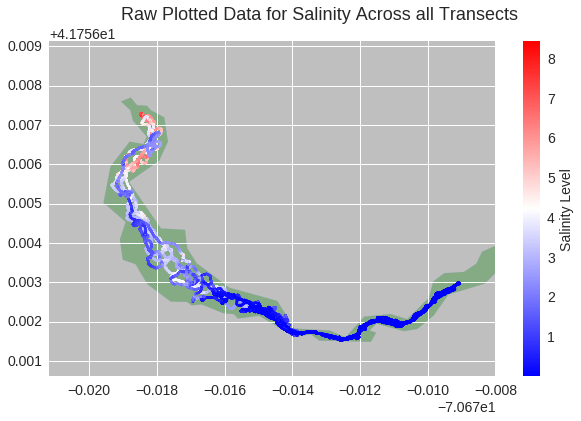

In [34]:
# Salinity
x = df['airmar']['lon_mod'][1:]
y = df['airmar']['lat_mod'][1:]
data = df['ctd']['Salinity'][1:]
bins = 50
label = 'Salinity Level'
title = 'Salinity Across all Transects'

sp.plot_rawspatial(x, y, data, label, title)
# sp.plot_bilinearinterp(x, y, data, bins, label, title)
# sp.plot_contours(x, y, data, bins, label, title)

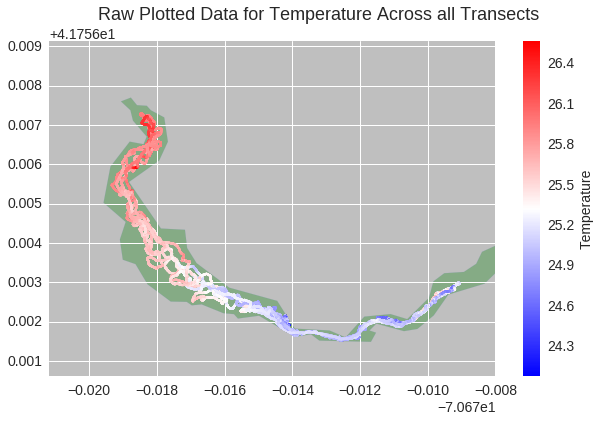

In [35]:
# Temperature
x = df['airmar']['lon_mod'][1:]
y = df['airmar']['lat_mod'][1:]
data = df['ctd']['Temperature'][1:]
bins = 100
label = 'Temperature'
title = 'Temperature Across all Transects'

sp.plot_rawspatial(x, y, data, label, title)
# sp.plot_bilinearinterp(x, y, data, bins, label, title)
# sp.plot_contours(x, y, data, bins, label, title)

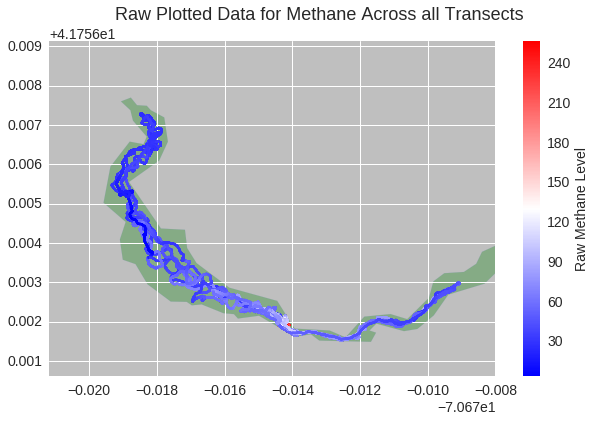

In [36]:
#Methane
x = df['airmar']['lon_mod'][1:]
y = df['airmar']['lat_mod'][1:]
data = df['gga']['CH4_ppm'][1:]
bins = 50
label = 'Raw Methane Level'
title = 'Methane Across all Transects'

sp.plot_rawspatial(x, y, data, label, title)
# sp.plot_bilinearinterp(x, y, data, bins, label, title)
# sp.plot_contours(x, y, data, bins, label, title)

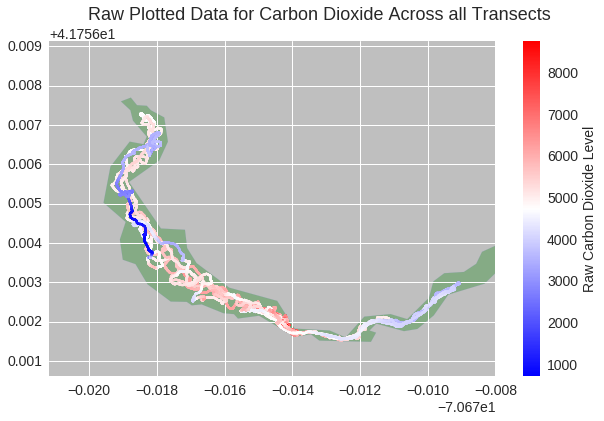

In [37]:
#CO2
x = df['airmar']['lon_mod'][1:]
y = df['airmar']['lat_mod'][1:]
data = df['gga']['CO2_ppm'][1:]
bins = 50
label = 'Raw Carbon Dioxide Level'
title = 'Carbon Dioxide Across all Transects'

sp.plot_rawspatial(x, y, data, label, title)
# sp.plot_bilinearinterp(x, y, data, bins, label, title)
# sp.plot_contours(x, y, data, bins, label, title)

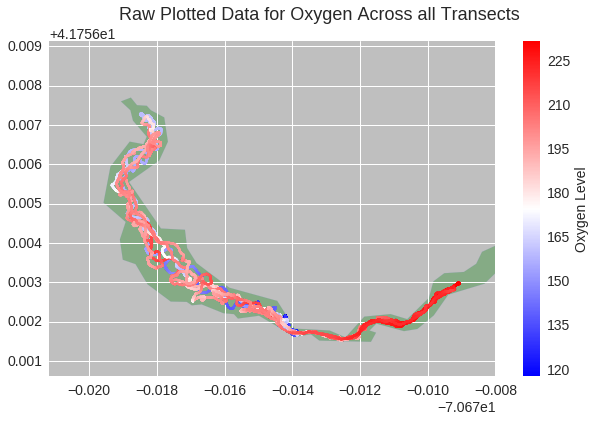

In [38]:
#Oxygen
x = df['airmar']['lon_mod'][1:]
y = df['airmar']['lat_mod'][1:]
data = df['op']['O2Concentration'][1:]
bins = 50
label = 'Oxygen Level'
title = 'Oxygen Across all Transects'

sp.plot_rawspatial(x, y, data, label, title)
# sp.plot_bilinearinterp(x, y, data, bins, label, title)
# sp.plot_contours(x, y, data, bins, label, title)

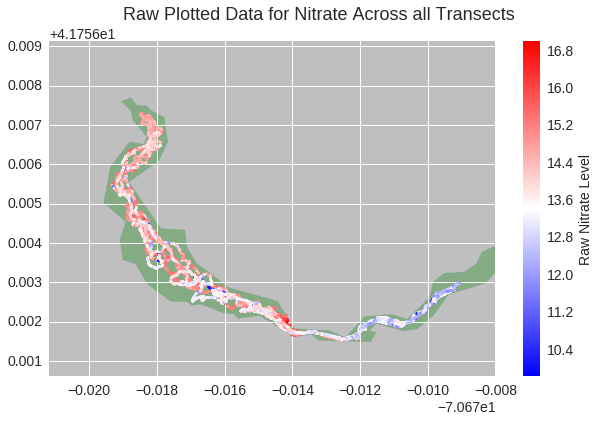

In [39]:
#Nitrate
x = df['airmar']['lon_mod'][1:]
y = df['airmar']['lat_mod'][1:]
data = df['nitrate']['0.00'][1:]
bins = 50
label = 'Raw Nitrate Level'
title = 'Nitrate Across all Transects'

sp.plot_rawspatial(x, y, data, label, title)
# sp.plot_bilinearinterp(x, y, data, bins, label, title)
# sp.plot_contours(x, y, data, bins, label, title)

### Each Transect, as a Standalone
First, let's look at each transect as an independent measurement. Later we will regulate the scales and can compare the transects directly against each other.

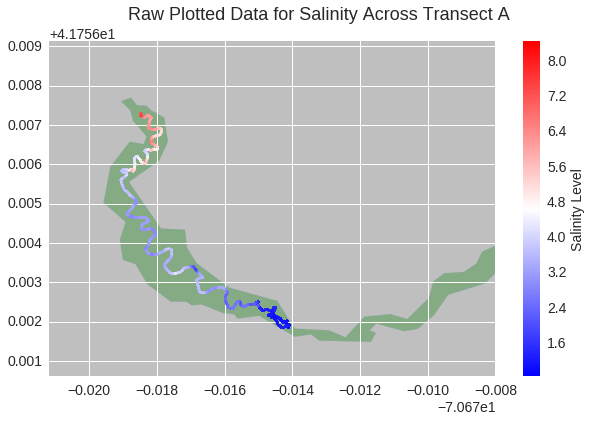

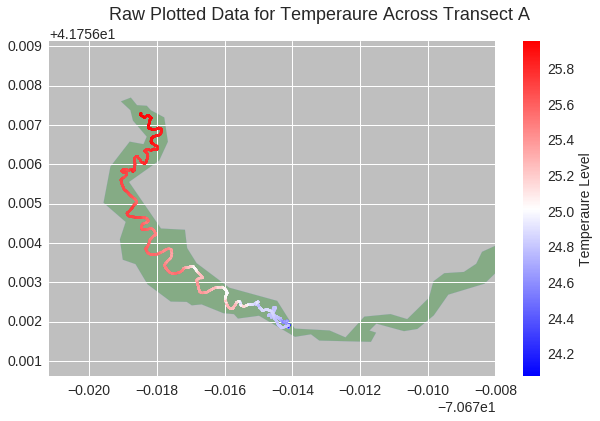

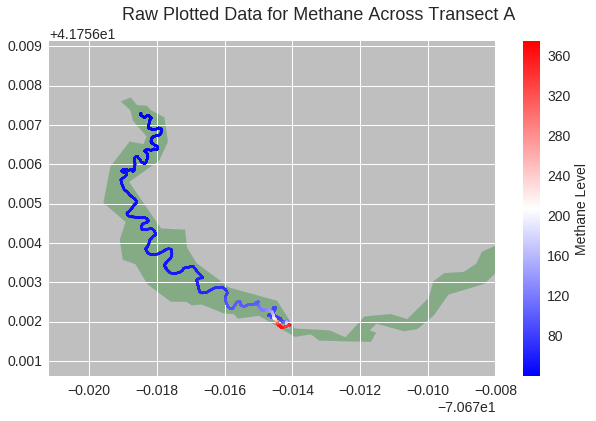

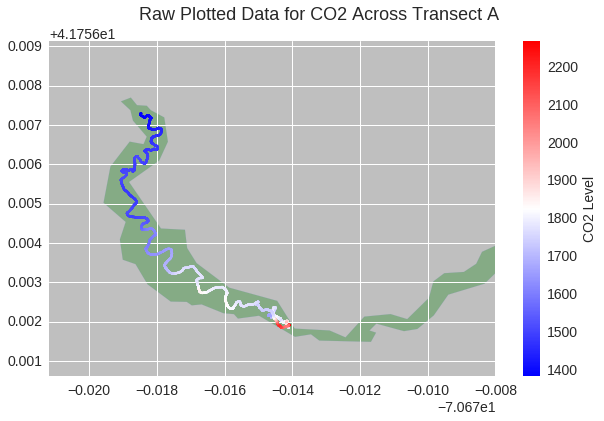

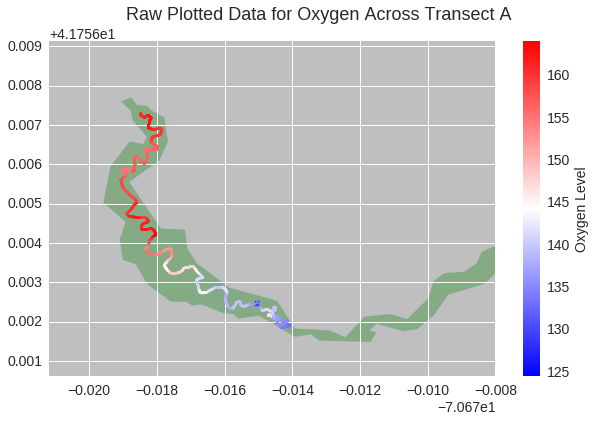

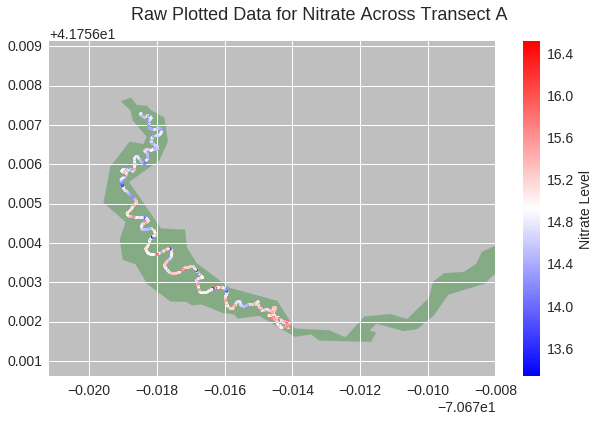

In [41]:
# Transect A
sp.plot_interptransects(ta, 'Transect A', 50)

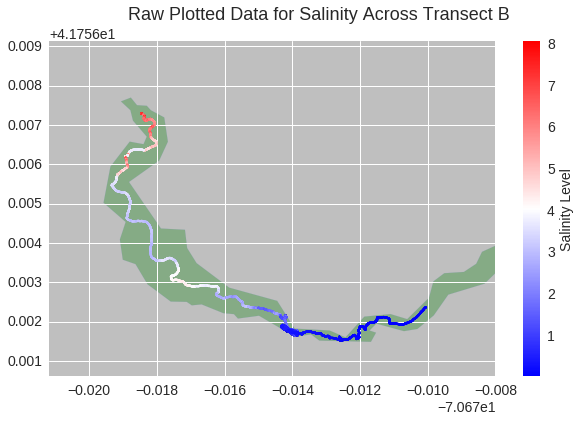

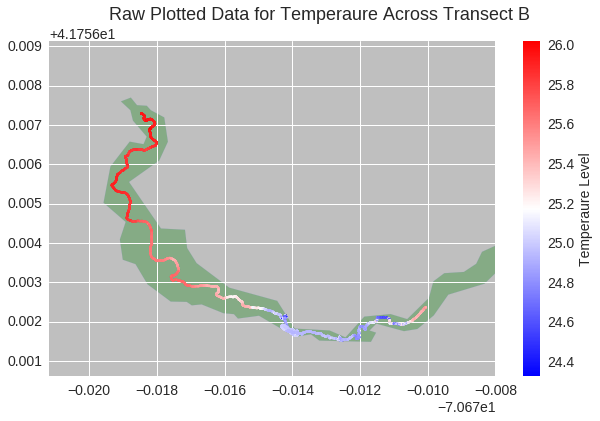

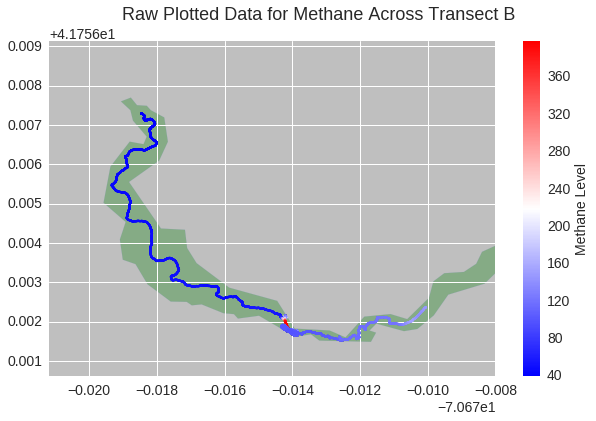

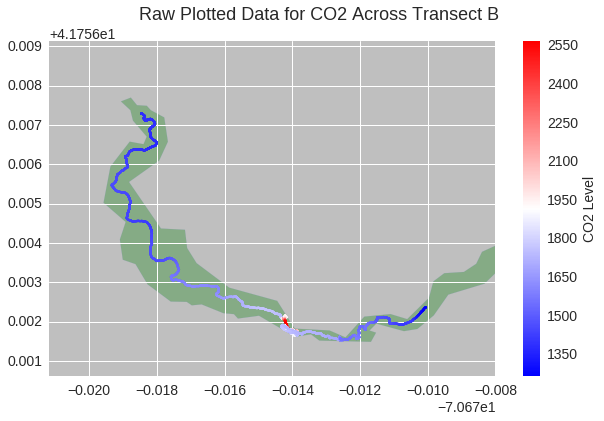

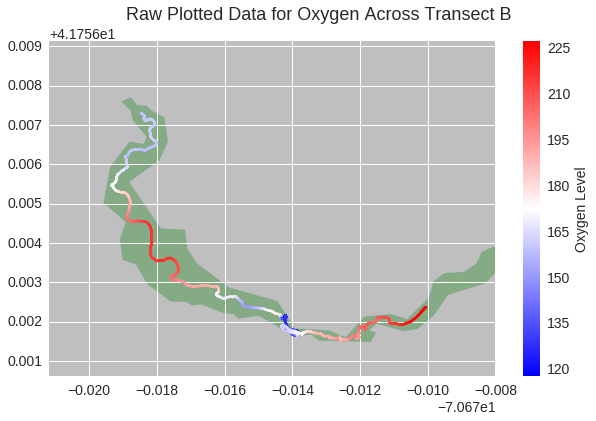

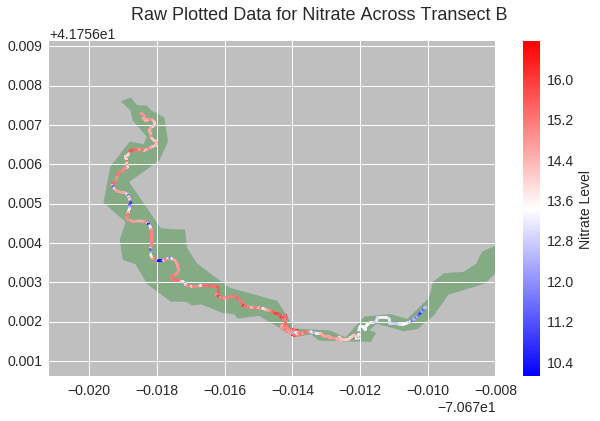

In [42]:
# Transect B
sp.plot_interptransects(tb, 'Transect B', 50)

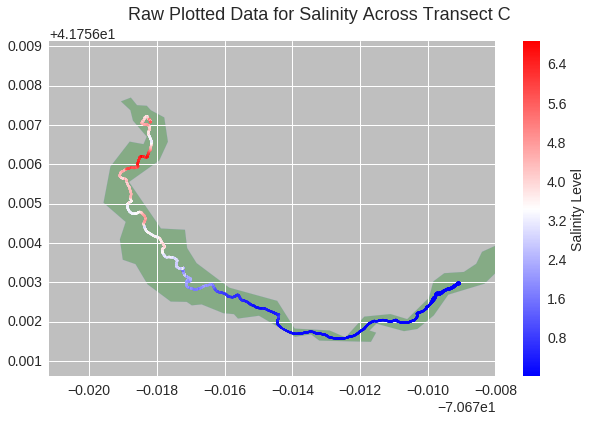

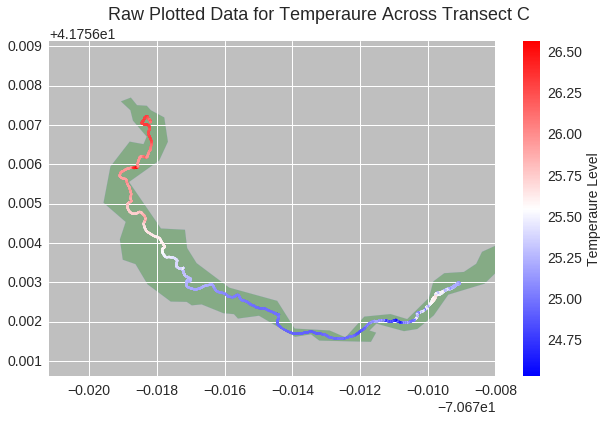

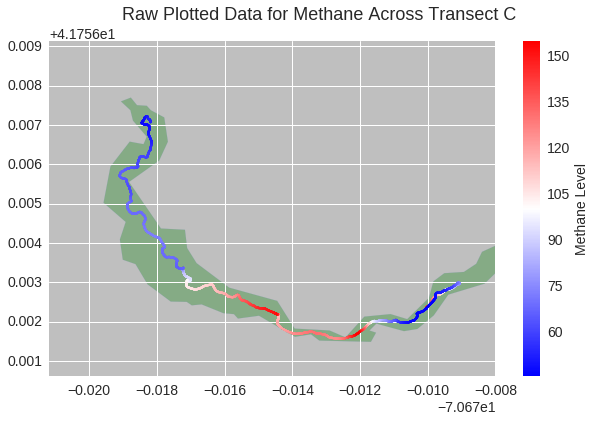

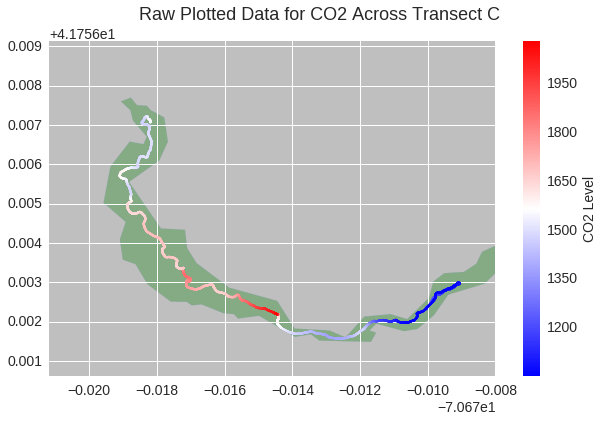

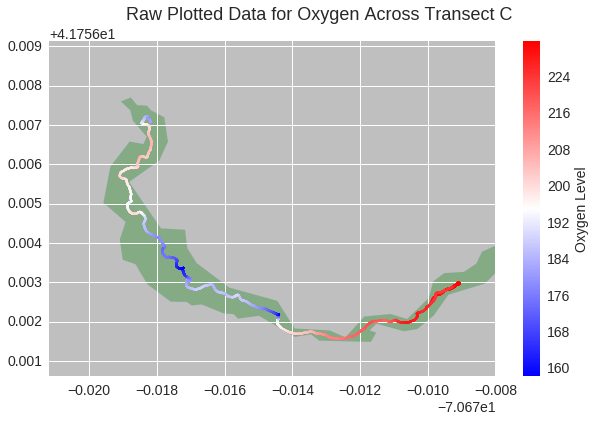

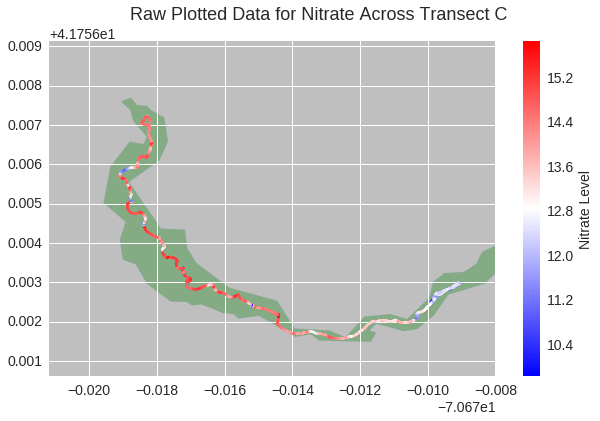

In [43]:
# Transect C
sp.plot_interptransects(tc, 'Transect C', 50)

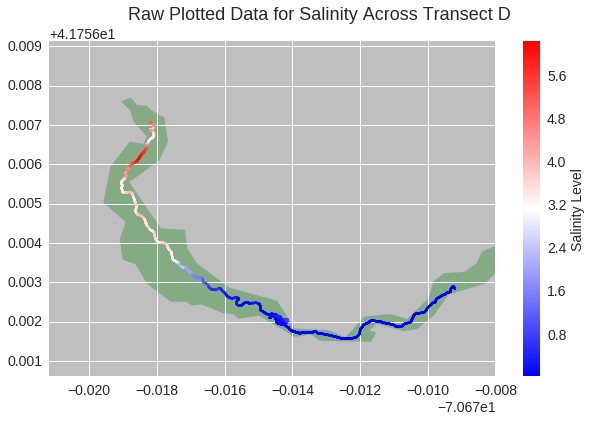

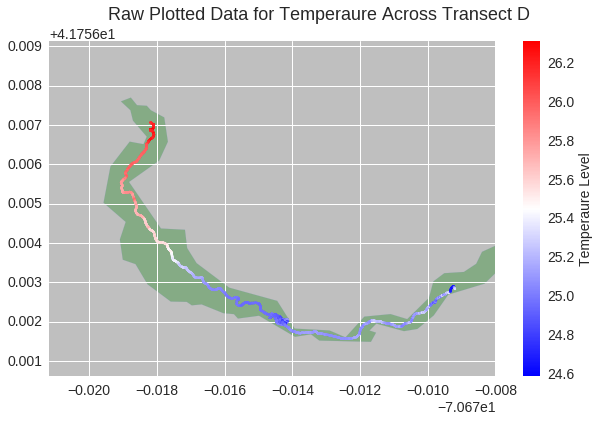

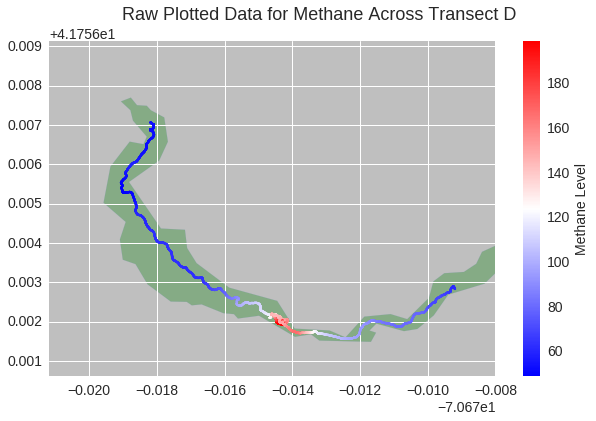

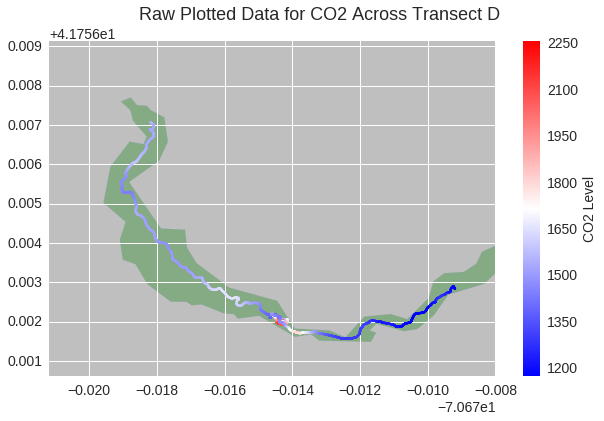

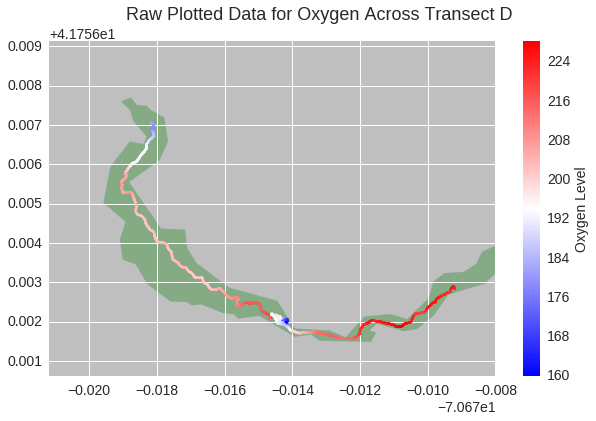

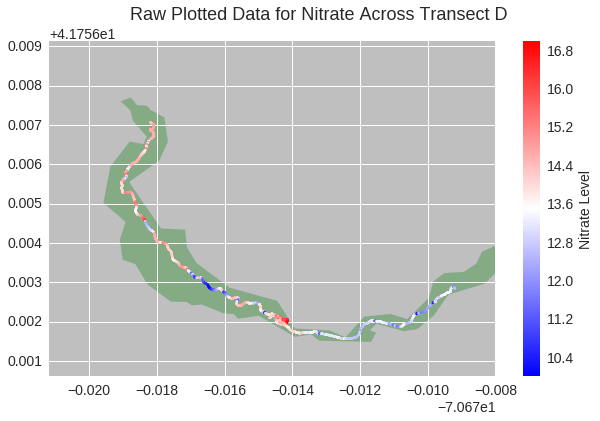

In [44]:
# Transect D
sp.plot_interptransects(td, 'Transect D', 50)

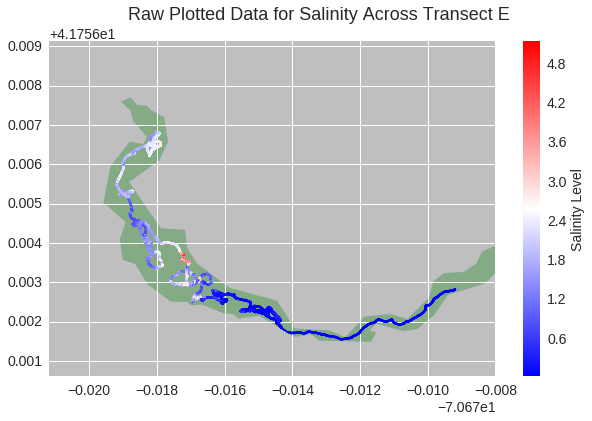

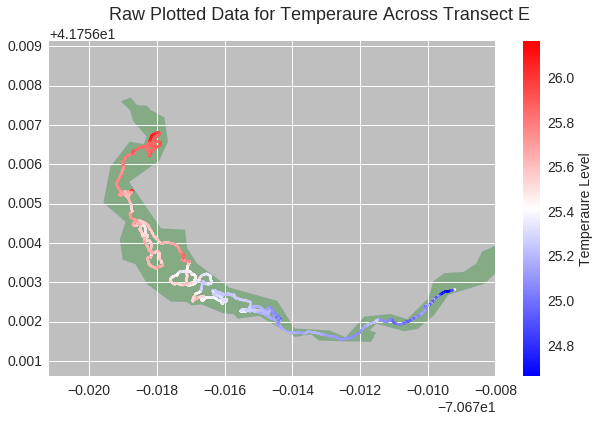

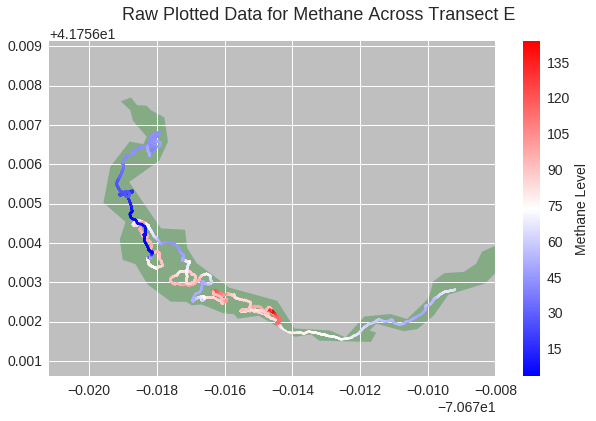

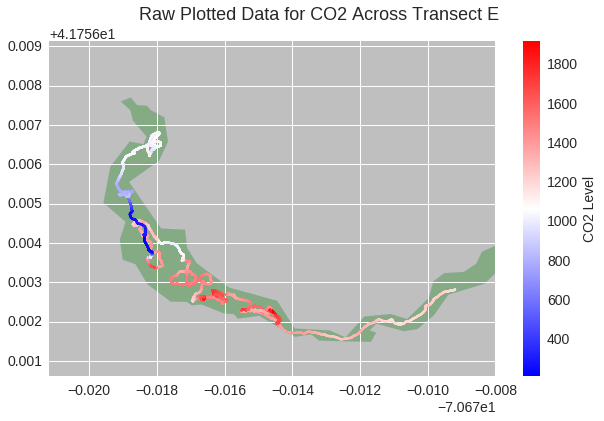

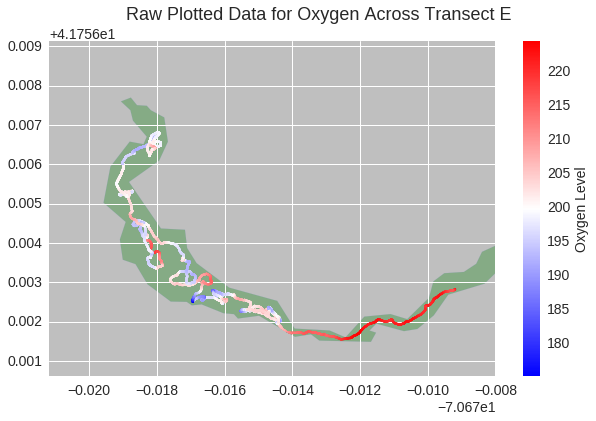

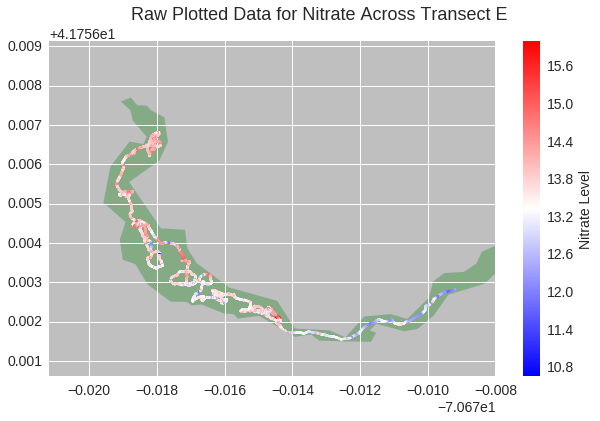

In [45]:
# Transect E
sp.plot_interptransects(te, 'Transect E', 50)

### Comparing Across Transects

[]

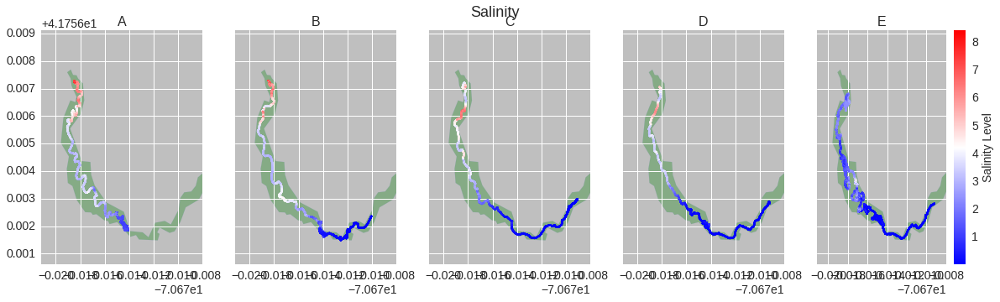

In [46]:
polys  = shapefile.Reader('./GIS_Data/River.shp')
poly = polys.iterShapes().next().__geo_interface__

t = [ta, tb, tc, td, te]
labels = ['A', 'B', 'C', 'D', 'E']
cmin = df['ctd']['Salinity'].min()
cmax = df['ctd']['Salinity'].max()

fig, axs = plt.subplots(1,5, figsize=(20,5), sharex='row', sharey='row')
fig.suptitle('Salinity', fontsize=18)
axs = np.array(axs)

cmap = plt.cm.bwr

for i in range(len(axs.reshape(-1))):
    axs[i].add_patch(PolygonPatch(poly, fc='green', ec="#6688cc", alpha=0.3, zorder=0))
    axs[i].axis(xmin=-70.691185, ymin=41.756619, xmax=-70.678, ymax=41.765134)
    axs[i].set_title(labels[i])
    points = axs[i].scatter(t[i]['airmar']['lon_mod'], 
                            t[i]['airmar']['lat_mod'], 
                            c=t[i]['ctd']['Salinity'], 
                            s=5, 
                            alpha=1.0, 
                            lw=0, 
                            cmap=cmap, 
                            vmin=cmin, 
                            vmax=cmax)

cbar = fig.colorbar(points)
cbar.set_label('Salinity Level')
cbar.set_clim(vmin=cmin, vmax=cmax)

plt.plot()

[]

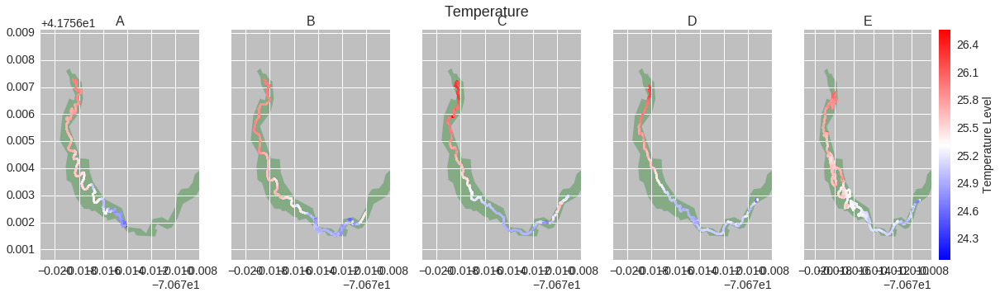

In [47]:
polys  = shapefile.Reader('./GIS_Data/River.shp')
poly = polys.iterShapes().next().__geo_interface__

t = [ta, tb, tc, td, te]
labels = ['A', 'B', 'C', 'D', 'E']
cmin = df['ctd']['Temperature'].min()
cmax = df['ctd']['Temperature'].max()

fig, axs = plt.subplots(1,5, figsize=(20,5), sharex='row', sharey='row')
fig.suptitle('Temperature', fontsize=18)
axs = np.array(axs)

cmap = plt.cm.bwr

for i in range(len(axs.reshape(-1))):
    axs[i].add_patch(PolygonPatch(poly, fc='green', ec="#6688cc", alpha=0.3, zorder=0))
    axs[i].axis(xmin=-70.691185, ymin=41.756619, xmax=-70.678, ymax=41.765134)
    axs[i].set_title(labels[i])
    points = axs[i].scatter(t[i]['airmar']['lon_mod'], 
                            t[i]['airmar']['lat_mod'], 
                            c=t[i]['ctd']['Temperature'], 
                            s=5, 
                            alpha=1.0, 
                            lw=0, 
                            cmap=cmap, 
                            vmin=cmin, 
                            vmax=cmax)

cbar = fig.colorbar(points)
cbar.set_label('Temperature Level')
cbar.set_clim(vmin=cmin, vmax=cmax)

plt.plot()

[]

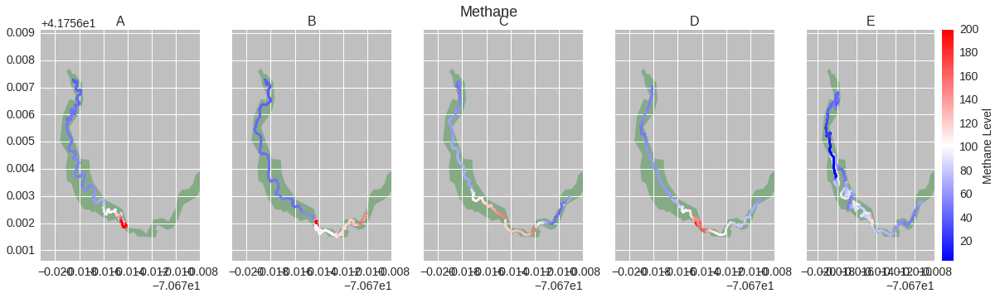

In [48]:
polys  = shapefile.Reader('./GIS_Data/River.shp')
poly = polys.iterShapes().next().__geo_interface__

t = [ta, tb, tc, td, te]
labels = ['A', 'B', 'C', 'D', 'E']
cmin = df['gga']['CH4_ppm_adjusted'].min()
cmax = 200#df['gga']['CH4_ppm_adjusted'].max()

fig, axs = plt.subplots(1,5, figsize=(20,5), sharex='row', sharey='row')
fig.suptitle('Methane', fontsize=18)
axs = np.array(axs)

cmap = plt.cm.bwr

for i in range(len(axs.reshape(-1))):
    axs[i].add_patch(PolygonPatch(poly, fc='green', ec="#6688cc", alpha=0.3, zorder=0))
    axs[i].axis(xmin=-70.691185, ymin=41.756619, xmax=-70.678, ymax=41.765134)
    axs[i].set_title(labels[i])
    points = axs[i].scatter(t[i]['airmar']['lon_mod'], 
                            t[i]['airmar']['lat_mod'], 
                            c=t[i]['gga']['CH4_ppm_adjusted'], 
                            s=5, 
                            alpha=1.0, 
                            lw=0, 
                            cmap=cmap, 
                            vmin=cmin, 
                            vmax=cmax)

cbar = fig.colorbar(points)
cbar.set_label('Methane Level')
cbar.set_clim(vmin=cmin, vmax=cmax)

plt.plot()

[]

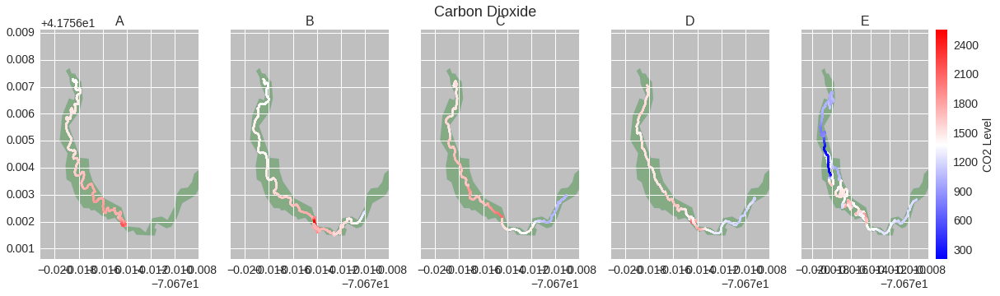

In [49]:
polys  = shapefile.Reader('./GIS_Data/River.shp')
poly = polys.iterShapes().next().__geo_interface__

t = [ta, tb, tc, td, te]
labels = ['A', 'B', 'C', 'D', 'E']
cmin = df['gga']['CO2_ppm_adjusted'].min()
cmax = df['gga']['CO2_ppm_adjusted'].max()

fig, axs = plt.subplots(1,5, figsize=(20,5), sharex='row', sharey='row')
fig.suptitle('Carbon Dioxide', fontsize=18)
axs = np.array(axs)

cmap = plt.cm.bwr

for i in range(len(axs.reshape(-1))):
    axs[i].add_patch(PolygonPatch(poly, fc='green', ec="#6688cc", alpha=0.3, zorder=0))
    axs[i].axis(xmin=-70.691185, ymin=41.756619, xmax=-70.678, ymax=41.765134)
    axs[i].set_title(labels[i])
    points = axs[i].scatter(t[i]['airmar']['lon_mod'], 
                            t[i]['airmar']['lat_mod'], 
                            c=t[i]['gga']['CO2_ppm_adjusted'], 
                            s=5, 
                            alpha=1.0, 
                            lw=0, 
                            cmap=cmap, 
                            vmin=cmin, 
                            vmax=cmax)

cbar = fig.colorbar(points)
cbar.set_label('CO2 Level')
cbar.set_clim(vmin=cmin, vmax=cmax)

plt.plot()

[]

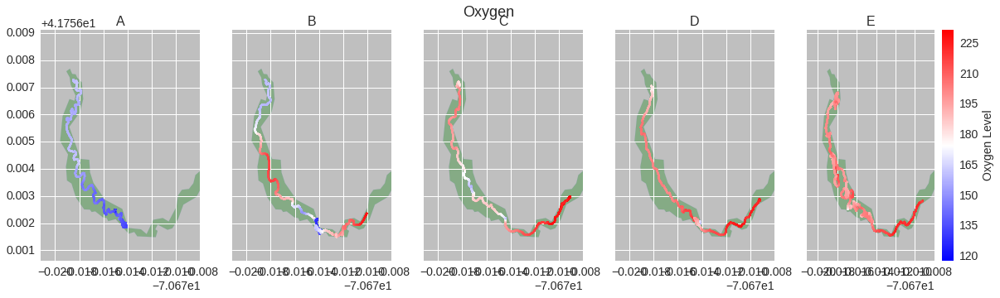

In [50]:
polys  = shapefile.Reader('./GIS_Data/River.shp')
poly = polys.iterShapes().next().__geo_interface__

t = [ta, tb, tc, td, te]
labels = ['A', 'B', 'C', 'D', 'E']
cmin = df['op']['O2Concentration'].min()
cmax = df['op']['O2Concentration'].max()

fig, axs = plt.subplots(1,5, figsize=(20,5), sharex='row', sharey='row')
fig.suptitle('Oxygen', fontsize=18)
axs = np.array(axs)

cmap = plt.cm.bwr

for i in range(len(axs.reshape(-1))):
    axs[i].add_patch(PolygonPatch(poly, fc='green', ec="#6688cc", alpha=0.3, zorder=0))
    axs[i].axis(xmin=-70.691185, ymin=41.756619, xmax=-70.678, ymax=41.765134)
    axs[i].set_title(labels[i])
    points = axs[i].scatter(t[i]['airmar']['lon_mod'], 
                            t[i]['airmar']['lat_mod'], 
                            c=t[i]['op']['O2Concentration'], 
                            s=5, 
                            alpha=1.0, 
                            lw=0, 
                            cmap=cmap, 
                            vmin=cmin, 
                            vmax=cmax)

cbar = fig.colorbar(points)
cbar.set_label('Oxygen Level')
cbar.set_clim(vmin=cmin, vmax=cmax)

plt.plot()

[]

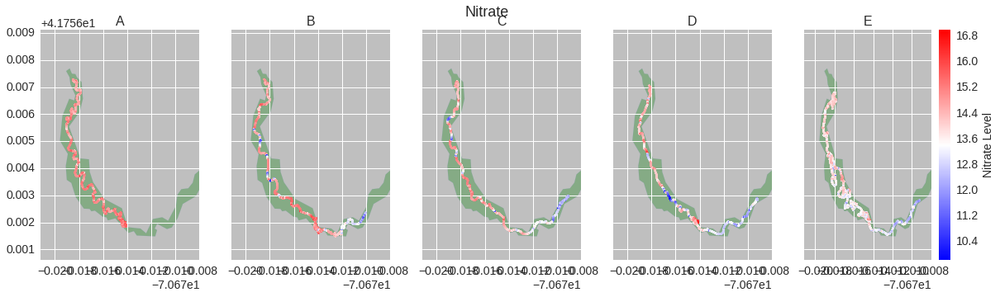

In [51]:
polys  = shapefile.Reader('./GIS_Data/River.shp')
poly = polys.iterShapes().next().__geo_interface__

t = [ta, tb, tc, td, te]
labels = ['A', 'B', 'C', 'D', 'E']
cmin = df['nitrate']['0.00'].min()
cmax = df['nitrate']['0.00'].max()

fig, axs = plt.subplots(1,5, figsize=(20,5), sharex='row', sharey='row')
fig.suptitle('Nitrate', fontsize=18)
axs = np.array(axs)

cmap = plt.cm.bwr

for i in range(len(axs.reshape(-1))):
    axs[i].add_patch(PolygonPatch(poly, fc='green', ec="#6688cc", alpha=0.3, zorder=0))
    axs[i].axis(xmin=-70.691185, ymin=41.756619, xmax=-70.678, ymax=41.765134)
    axs[i].set_title(labels[i])
    points = axs[i].scatter(t[i]['airmar']['lon_mod'], 
                            t[i]['airmar']['lat_mod'], 
                            c=t[i]['nitrate']['0.00'], 
                            s=5, 
                            alpha=1.0, 
                            lw=0, 
                            cmap=cmap, 
                            vmin=cmin, 
                            vmax=cmax)

cbar = fig.colorbar(points)
cbar.set_label('Nitrate Level')
cbar.set_clim(vmin=cmin, vmax=cmax)

plt.plot()

/home/vpreston/anaconda2/lib/python2.7/site-packages/matplotlib/figure.py:1744: UserWarning: This figure includes Axes that are not compatible with tight_layout, so its results might be incorrect.
  warnings.warn("This figure includes Axes that are not "


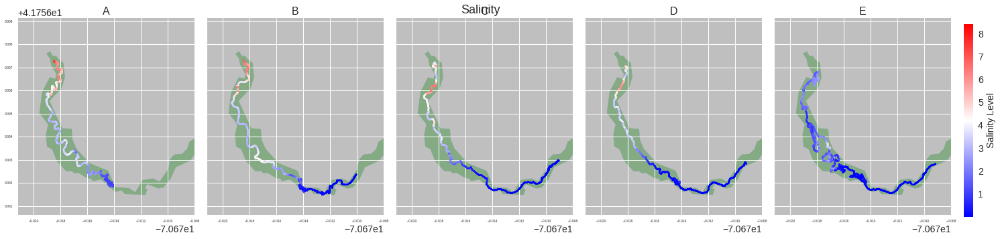

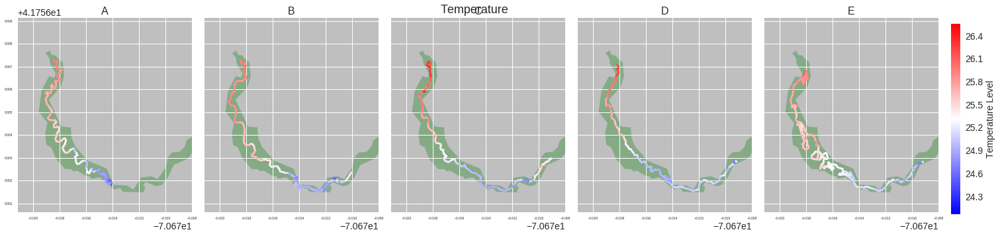

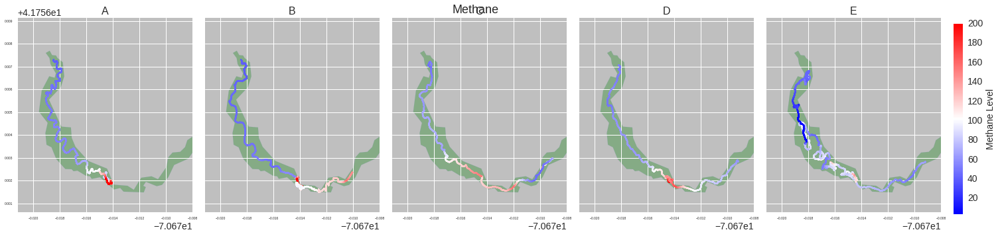

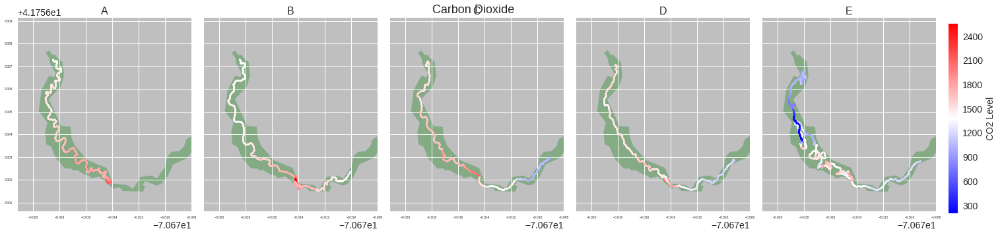

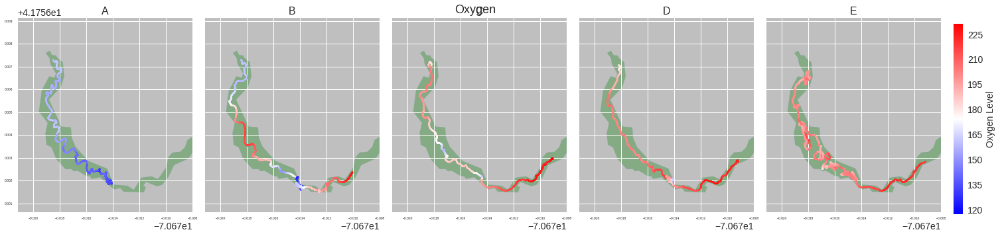

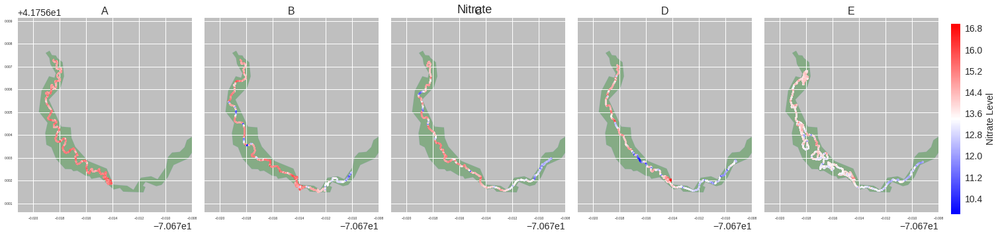

In [52]:
reload(sp)
sp.plot_master(df, ta, tb, tc, td, te)
##### NB! Methane scale manually cuts the huge outlier spikes in the data, for clearer trend illustration

## Spatial Analysis
Now, let's look at other ways to slice the information and diplay it!

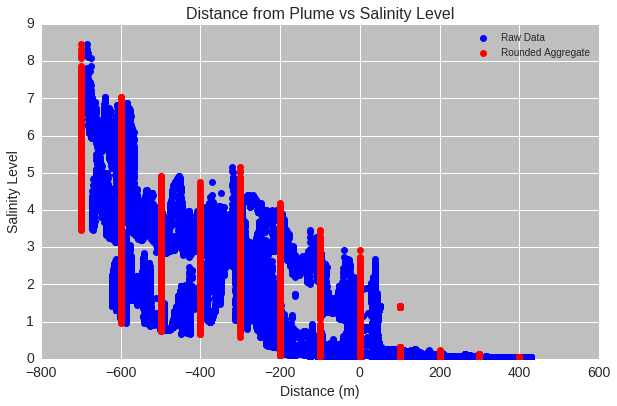

In [53]:
# Let's plot sensor readings as a relationship with distance from the plume!

x = df['airmar']['distance'][1:]
y = df['ctd']['Salinity'][1:]
plt.plot(x, y, 'bo', label='Raw Data')

x = df['airmar']['distance'][1:].apply(lambda x: round(x,-2))
plt.plot(x, y, 'ro', label='Rounded Aggregate')

plt.title('Distance from Plume vs Salinity Level')
plt.xlabel('Distance (m)')
plt.ylabel('Salinity Level')
plt.legend()

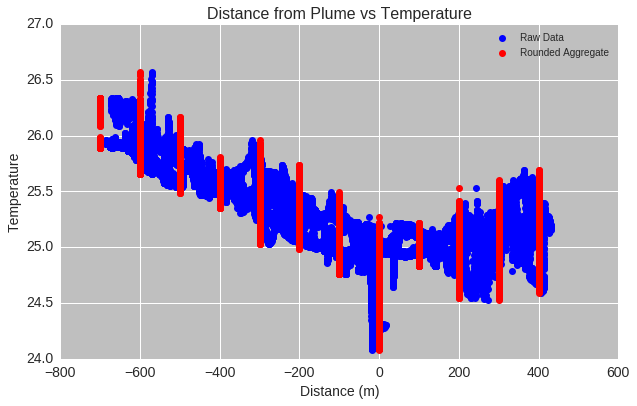

In [54]:
x = df['airmar']['distance'][1:]
y = df['ctd']['Temperature'][1:]
plt.plot(x, y, 'bo', label='Raw Data')

x = df['airmar']['distance'][1:].apply(lambda x: round(x,-2))
plt.plot(x, y, 'ro', label='Rounded Aggregate')

plt.title('Distance from Plume vs Temperature')
plt.xlabel('Distance (m)')
plt.ylabel('Temperature')
plt.legend()

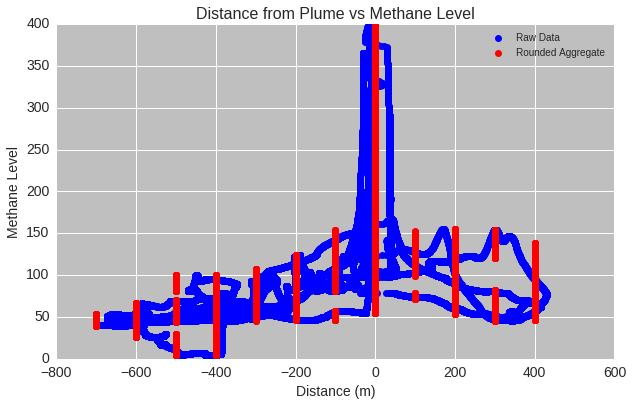

In [55]:
x = df['airmar']['distance'][1:]
y = df['gga']['CH4_ppm_adjusted'][1:]
plt.plot(x, y, 'bo', label='Raw Data')

x = df['airmar']['distance'][1:].apply(lambda x: round(x,-2))
plt.plot(x, y, 'ro', label='Rounded Aggregate')

plt.title('Distance from Plume vs Methane Level')
plt.xlabel('Distance (m)')
plt.ylabel('Methane Level')
plt.legend()

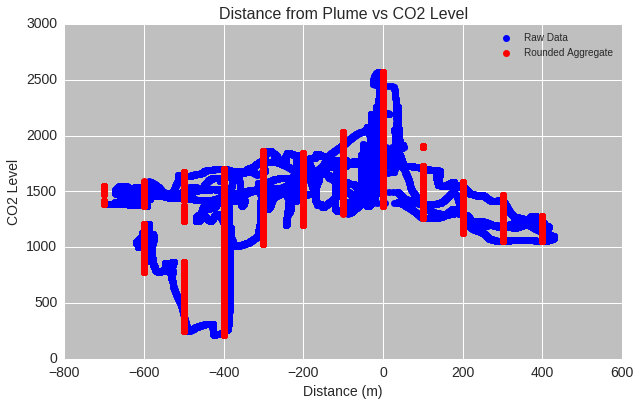

In [56]:
x = df['airmar']['distance'][1:]
y = df['gga']['CO2_ppm_adjusted'][1:]
plt.plot(x, y, 'bo', label='Raw Data')

x = df['airmar']['distance'][1:].apply(lambda x: round(x,-2))
plt.plot(x, y, 'ro', label='Rounded Aggregate')

plt.title('Distance from Plume vs CO2 Level')
plt.xlabel('Distance (m)')
plt.ylabel( 'CO2 Level')
plt.legend()

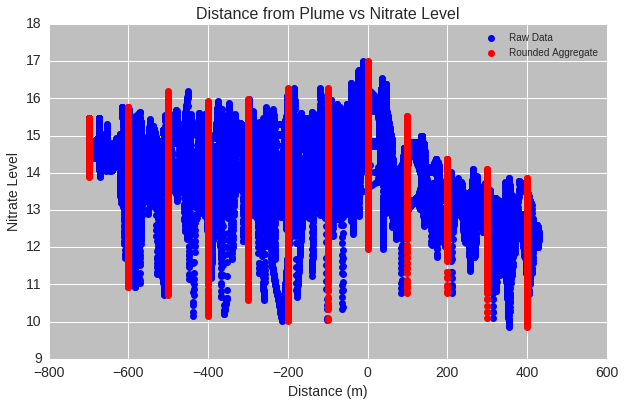

In [57]:
x = df['airmar']['distance'][1:]
y = df['nitrate']['0.00'][1:]
plt.plot(x, y, 'bo', label='Raw Data')

x = df['airmar']['distance'][1:].apply(lambda x: round(x,-2))
plt.plot(x, y, 'ro', label='Rounded Aggregate')

plt.title('Distance from Plume vs Nitrate Level')
plt.xlabel('Distance (m)')
plt.ylabel('Nitrate Level')
plt.legend()

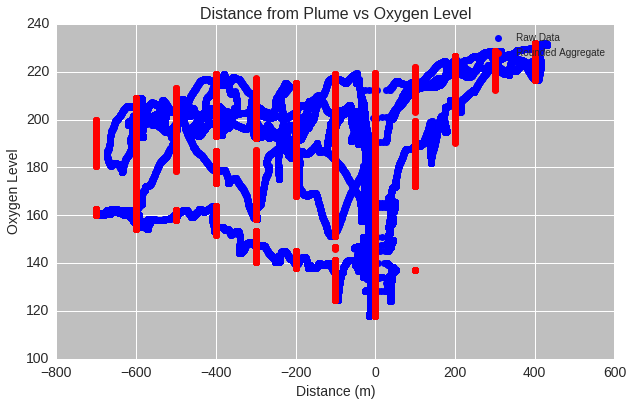

In [58]:
x = df['airmar']['distance'][1:]
y = df['op']['O2Concentration'][1:]
plt.plot(x, y, 'bo', label='Raw Data')

x = df['airmar']['distance'][1:].apply(lambda x: round(x,-2))
plt.plot(x, y, 'ro', label='Rounded Aggregate')

plt.title('Distance from Plume vs Oxygen Level')
plt.xlabel('Distance (m)')
plt.ylabel('Oxygen Level')
plt.legend()

So, what does this look like if we break this down along transects?

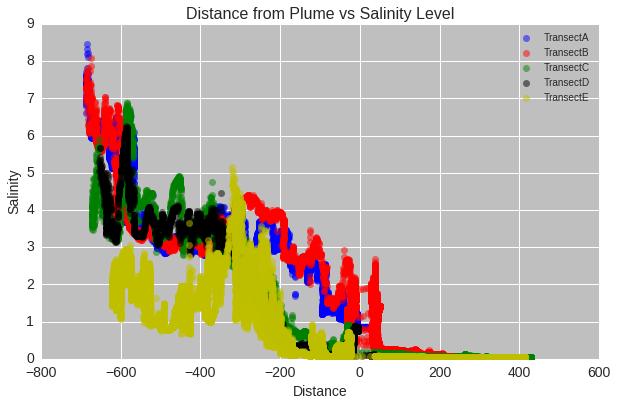

In [59]:
sp.plot_pvp_transect(ta, tb, tc, td, te, 
                     ['airmar', 'ctd'], 
                     ['distance', 'Salinity'], 
                     ['Distance', 'Salinity'], 
                     'Distance from Plume vs Salinity Level')


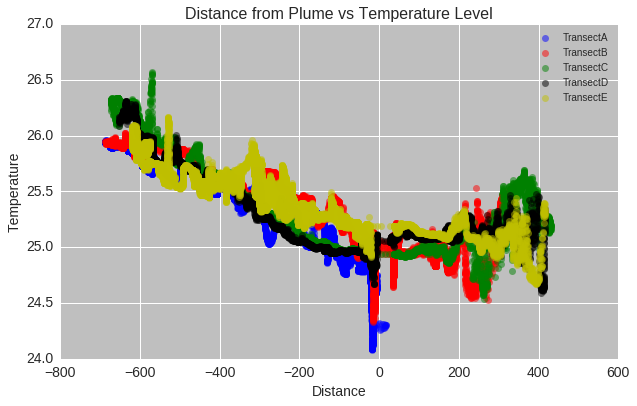

In [60]:
sp.plot_pvp_transect(ta, tb, tc, td, te, 
                     ['airmar', 'ctd'], 
                     ['distance', 'Temperature'], 
                     ['Distance', 'Temperature'], 
                     'Distance from Plume vs Temperature Level')

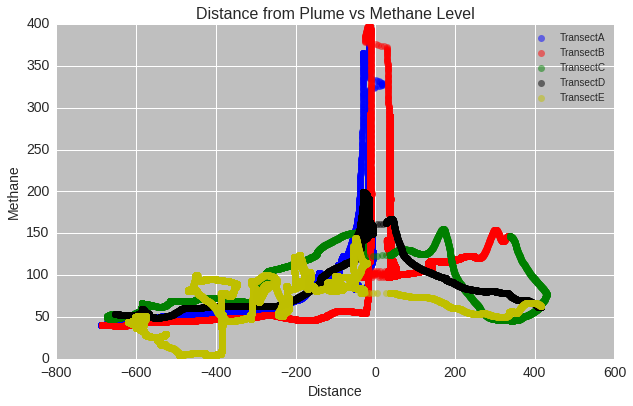

In [61]:
sp.plot_pvp_transect(ta, tb, tc, td, te, 
                     ['airmar', 'gga'], 
                     ['distance', 'CH4_ppm_adjusted'], 
                     ['Distance', 'Methane'], 
                     'Distance from Plume vs Methane Level')

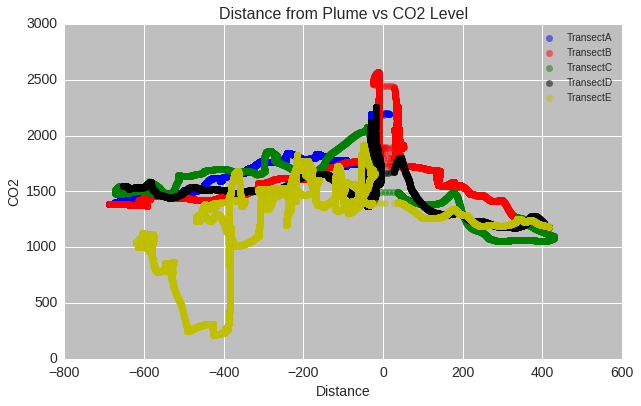

In [62]:
sp.plot_pvp_transect(ta, tb, tc, td, te, 
                     ['airmar', 'gga'], 
                     ['distance', 'CO2_ppm_adjusted'], 
                     ['Distance', 'CO2'], 
                     'Distance from Plume vs CO2 Level')

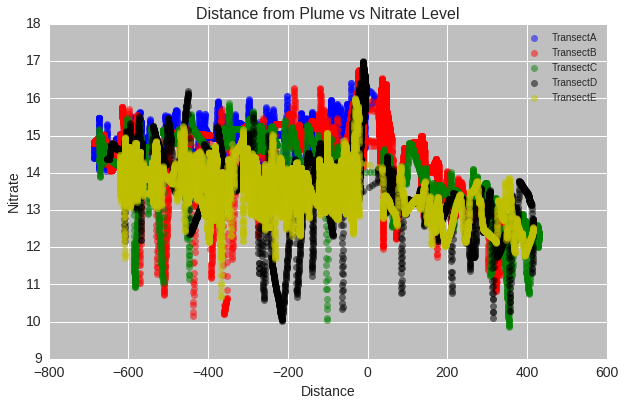

In [63]:
sp.plot_pvp_transect(ta, tb, tc, td, te, 
                     ['airmar', 'nitrate'], 
                     ['distance', '0.00'], 
                     ['Distance', 'Nitrate'], 
                     'Distance from Plume vs Nitrate Level')

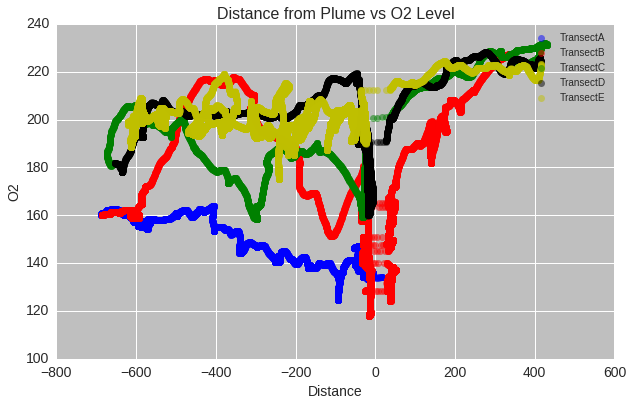

In [64]:
sp.plot_pvp_transect(ta, tb, tc, td, te, 
                     ['airmar', 'op'], 
                     ['distance', 'O2Concentration'], 
                     ['Distance', 'O2'], 
                     'Distance from Plume vs O2 Level')

And now let's look at those proporty graphs again, with the transects, and then the distance in mind!

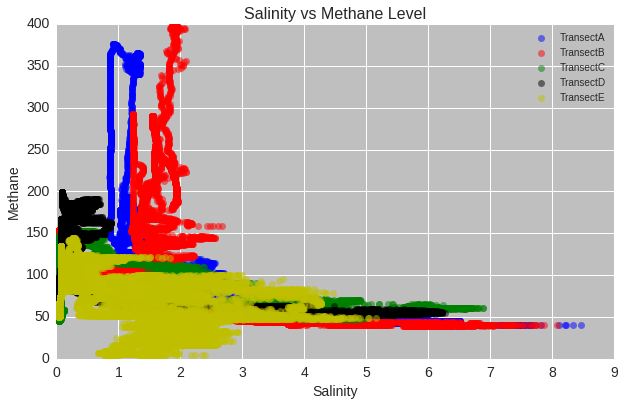

In [65]:
sp.plot_pvp_transect(ta, tb, tc, td, te, 
                     ['ctd', 'gga'], 
                     ['Salinity', 'CH4_ppm_adjusted'], 
                     ['Salinity', 'Methane'], 
                     'Salinity vs Methane Level')

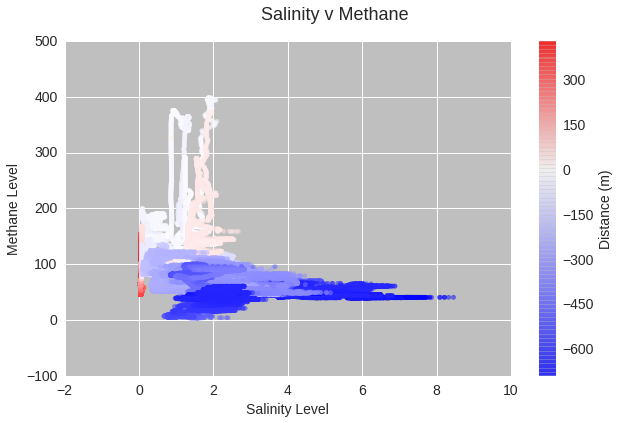

In [66]:
x = df['ctd']['Salinity'][1:]
y = df['gga']['CH4_ppm_adjusted'][1:]
c=df['airmar']['distance'][1:]
sp.plot_pvp_distance(x, y, c, ['Salinity Level','Methane Level'], 'Salinity v Methane')

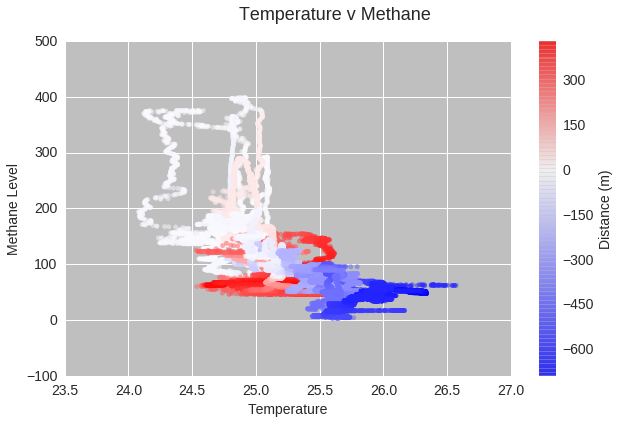

In [67]:
x = df['ctd']['Temperature'][1:]
y = df['gga']['CH4_ppm_adjusted'][1:]
c=df['airmar']['distance'][1:]
sp.plot_pvp_distance(x, y, c, ['Temperature','Methane Level'], 'Temperature v Methane')

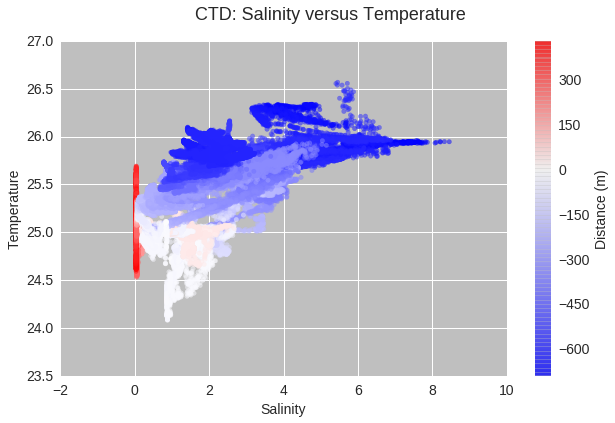

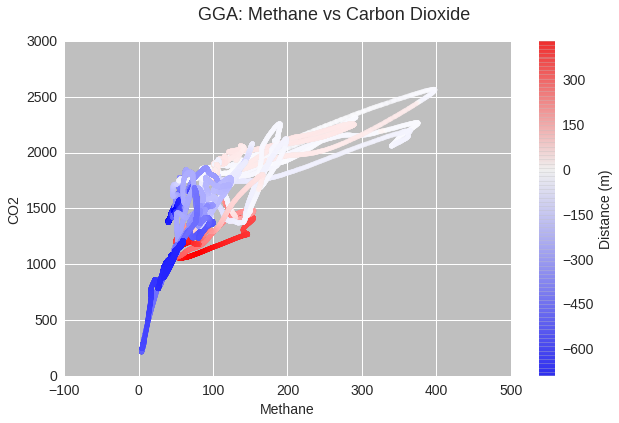

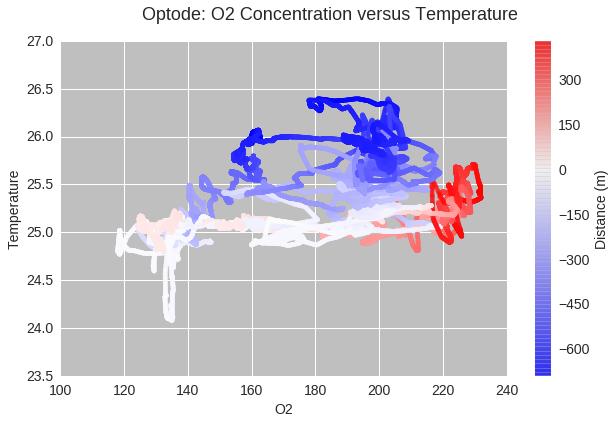

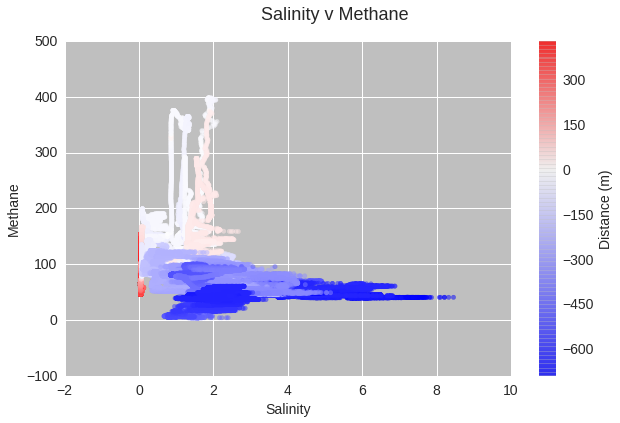

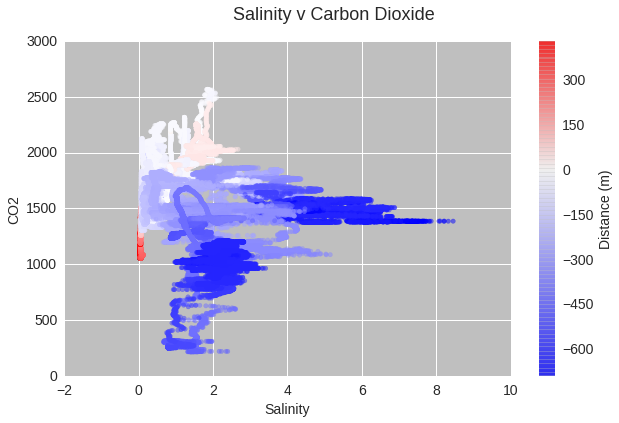

...

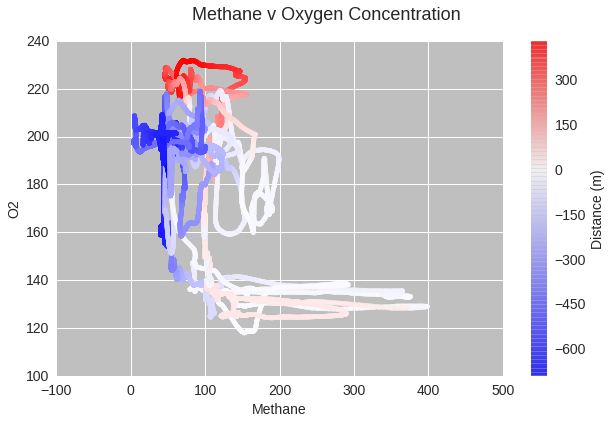

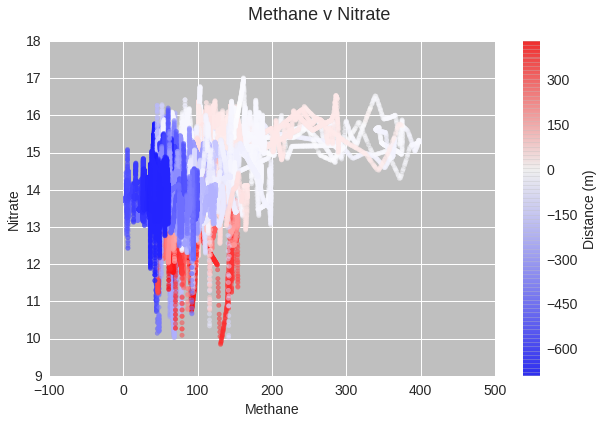

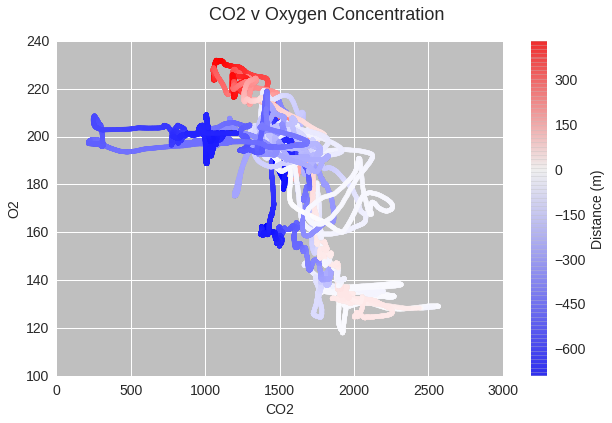

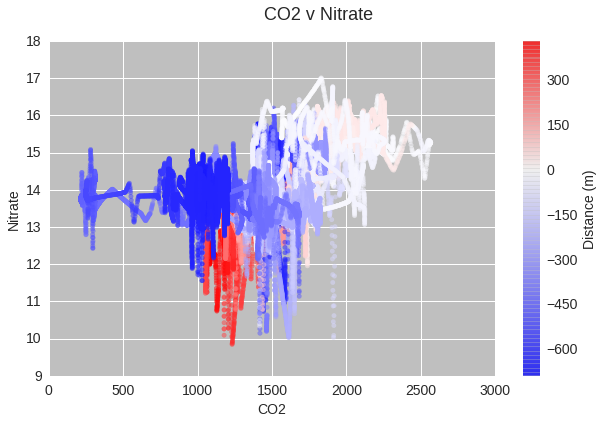

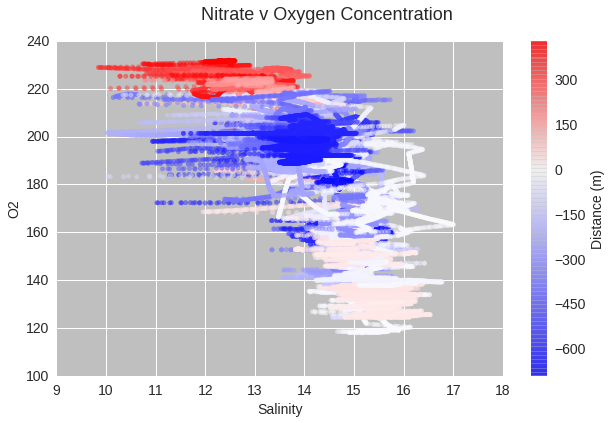

In [68]:
sp.plot_pvpseries(df)

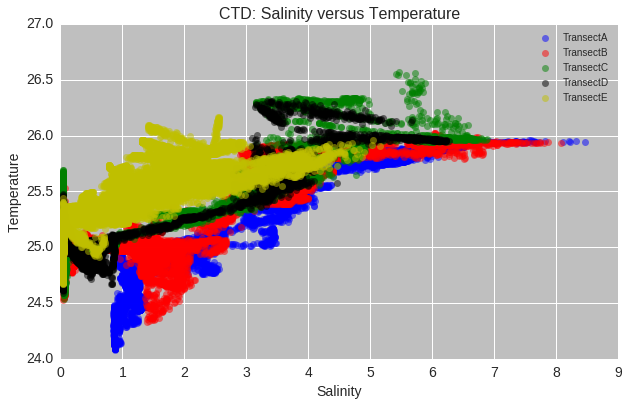

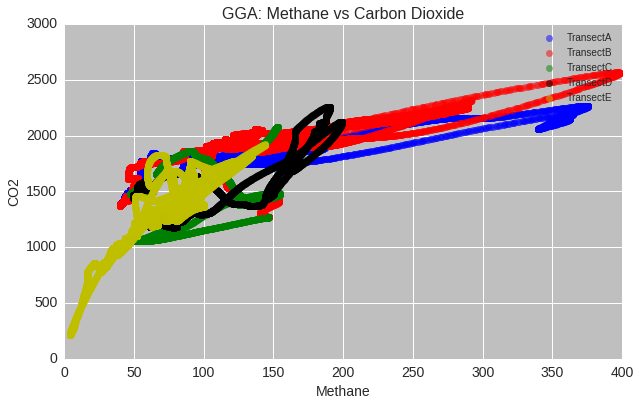

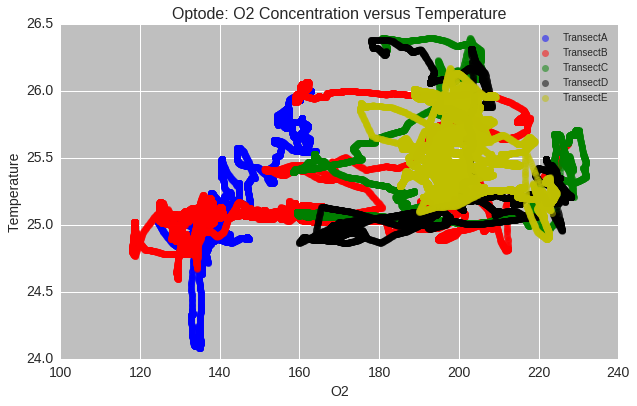

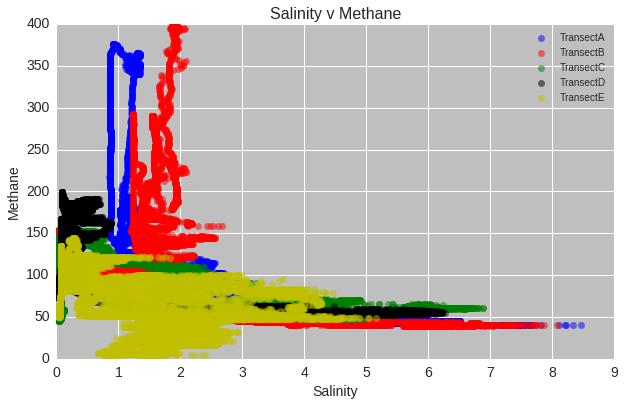

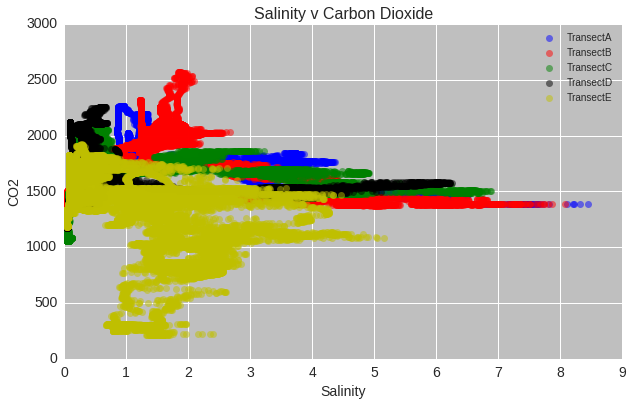

...

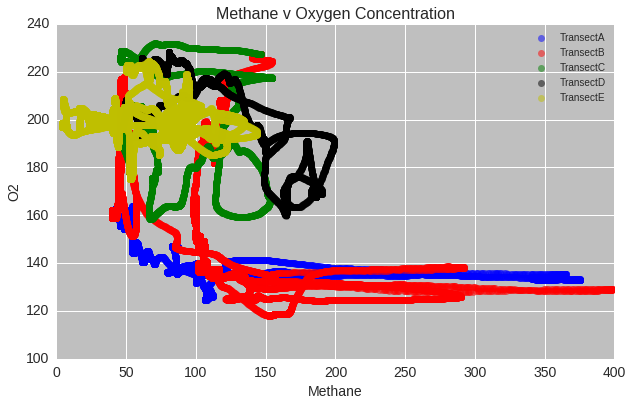

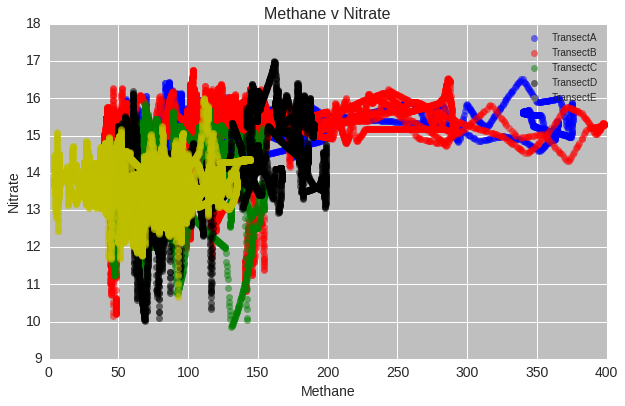

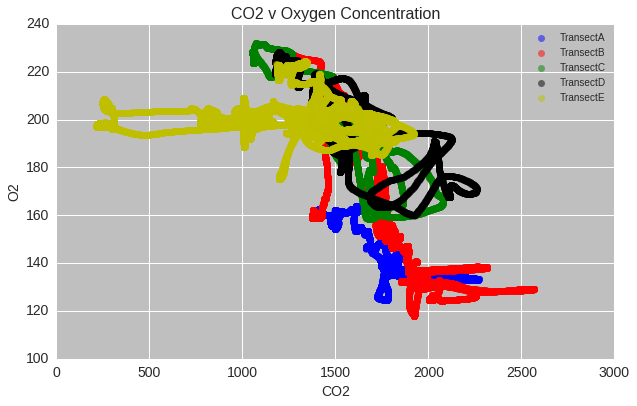

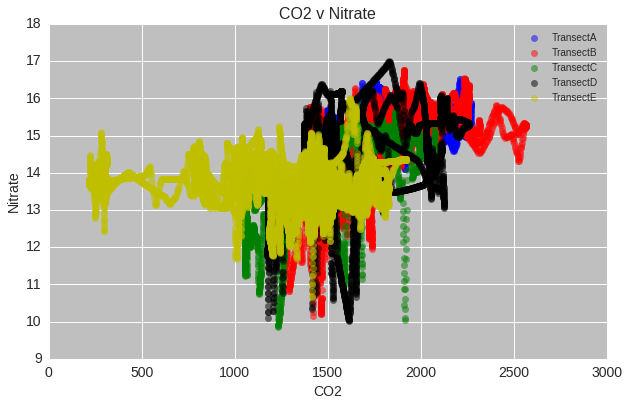

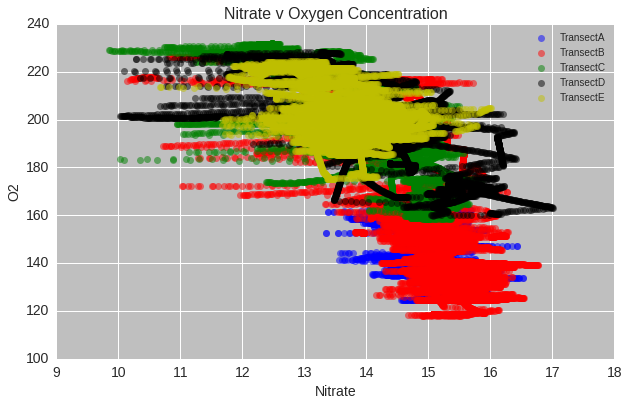

In [69]:
sp.plot_pvpseriestransect(ta, tb, tc, td, te)

Let's clean the data further, and calculate the averages of every 5 meters and see what that looks like!

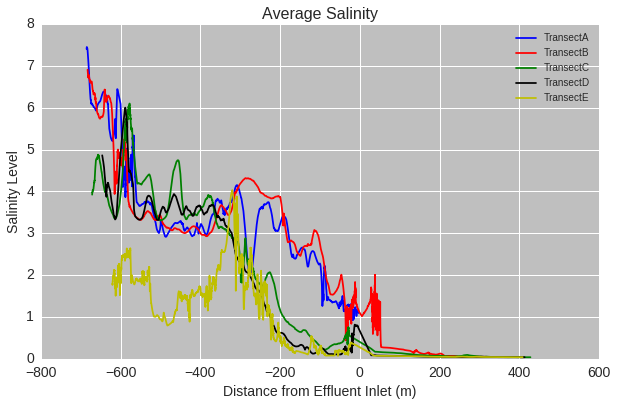

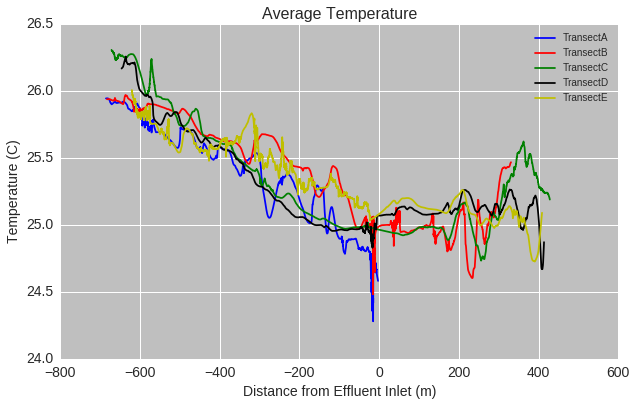

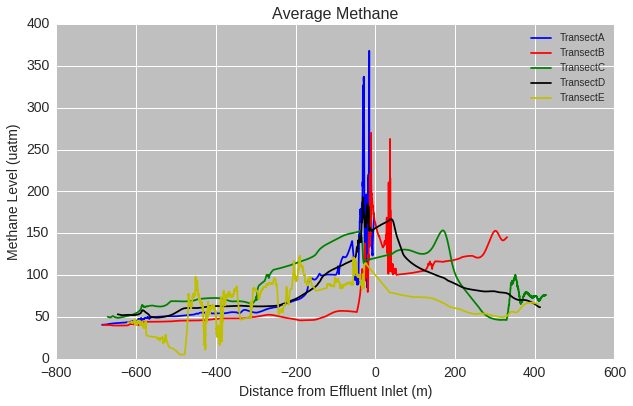

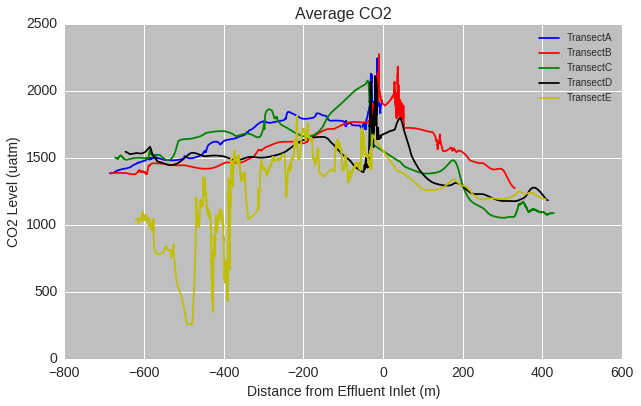

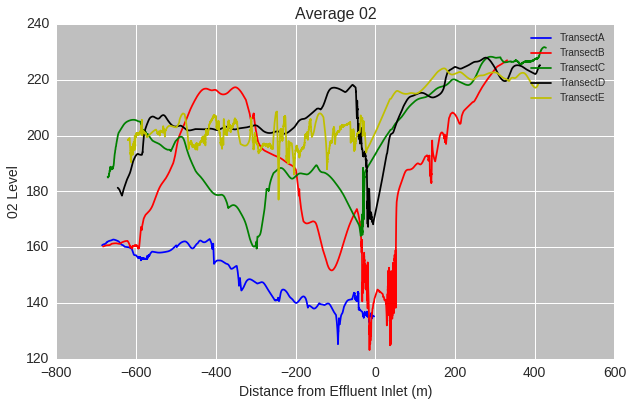

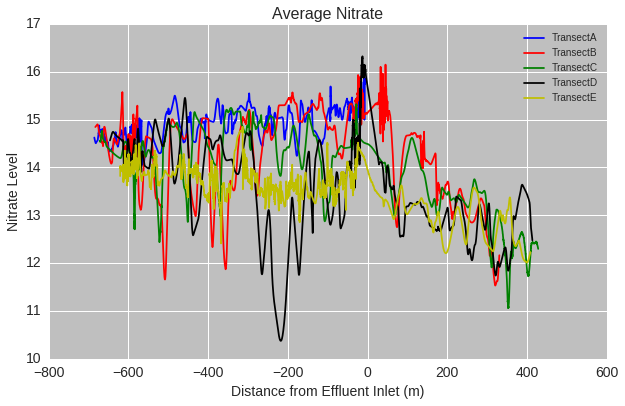

In [70]:
sp.plot_averages(ta, tb, tc, td, te, 60)

## Sorting Categories and Changing Data Displays
After meeting on August 16 to review the data, several suggestions were made for new figures and some data adjustments. These are done below.

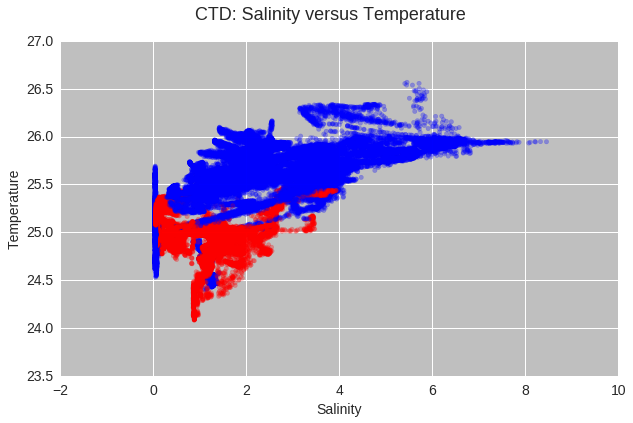

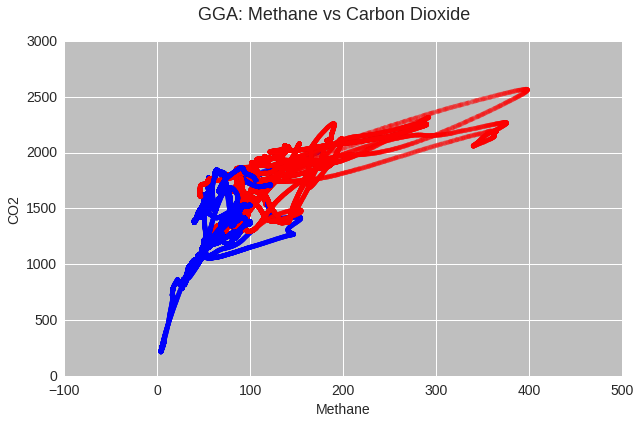

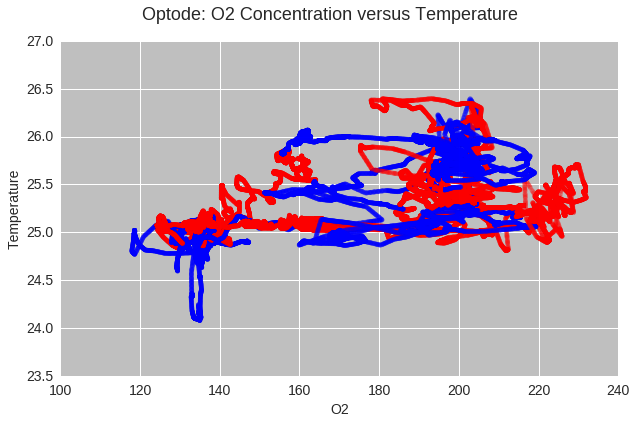

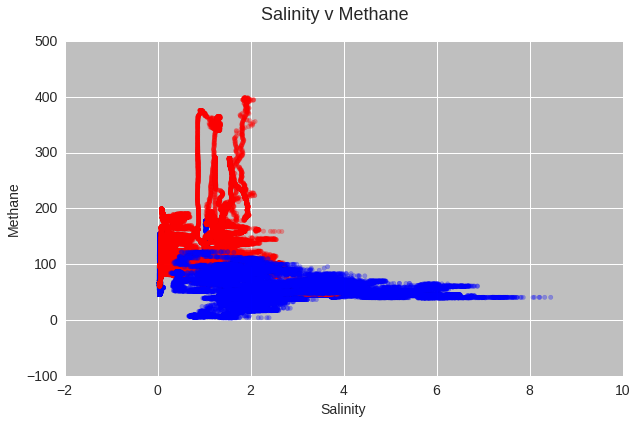

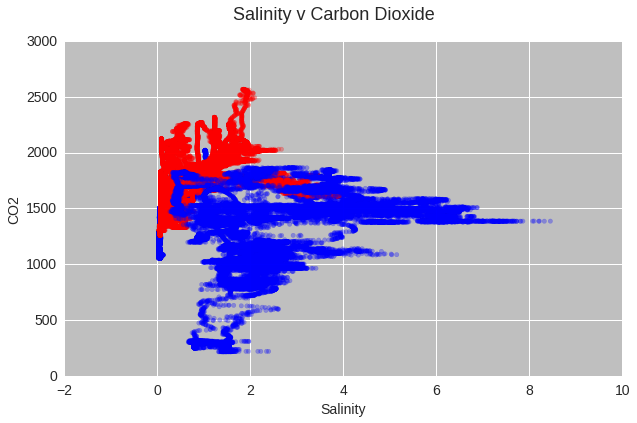

...

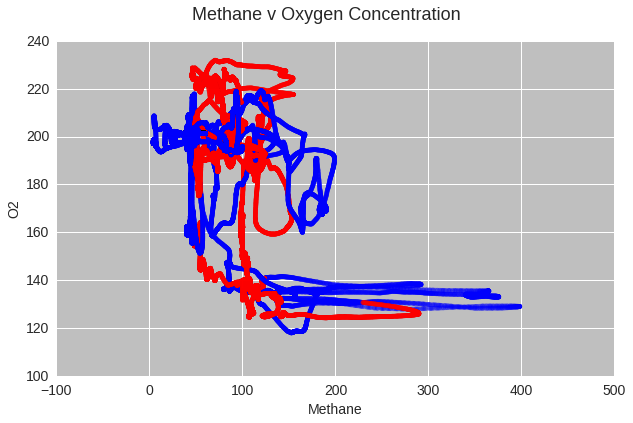

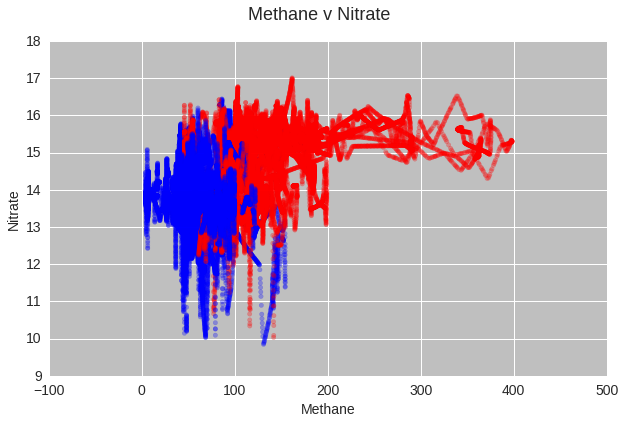

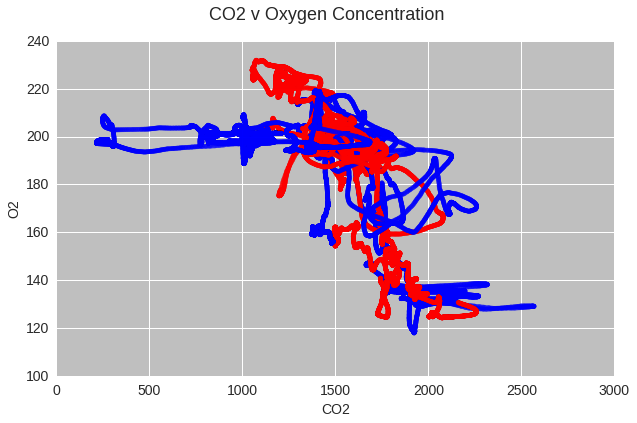

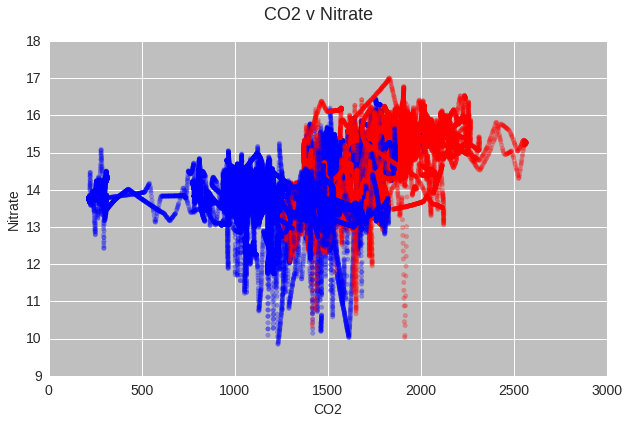

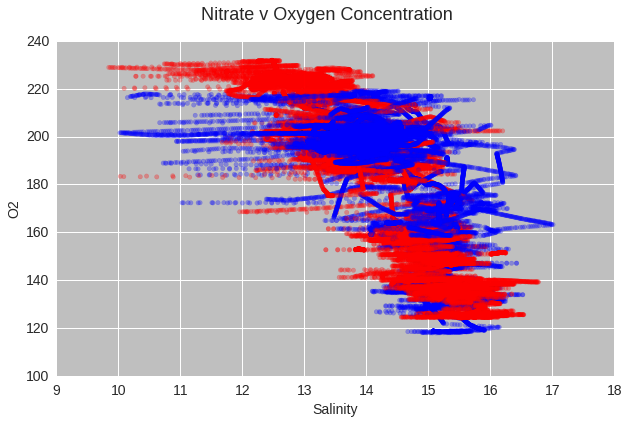

In [71]:
# Let's create the property graphs again, but sorting by whether the points are within a certain range of the plume

sp.plot_pvprange(df)

Let's also make some more large-grid graphs which seperate out transects. And show distance, and categories. 

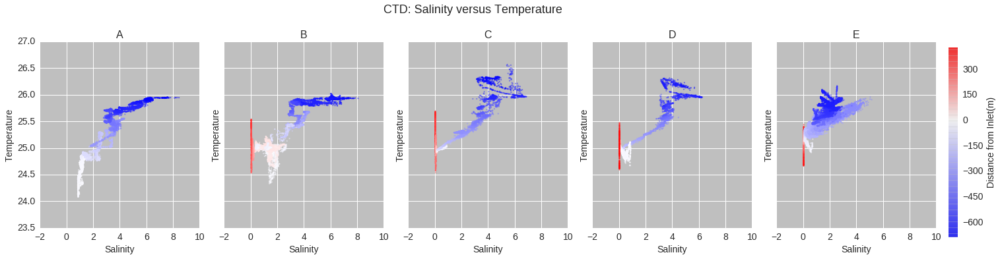

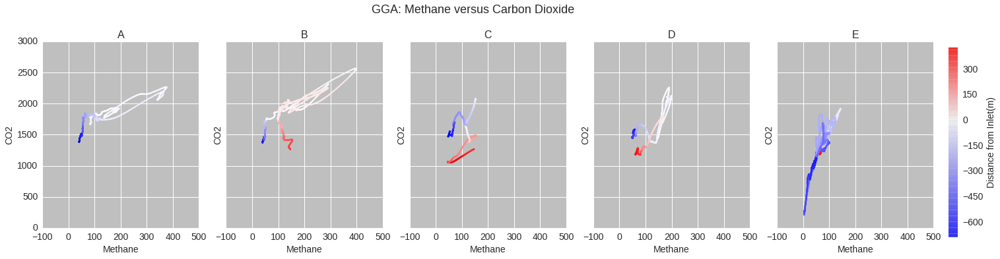

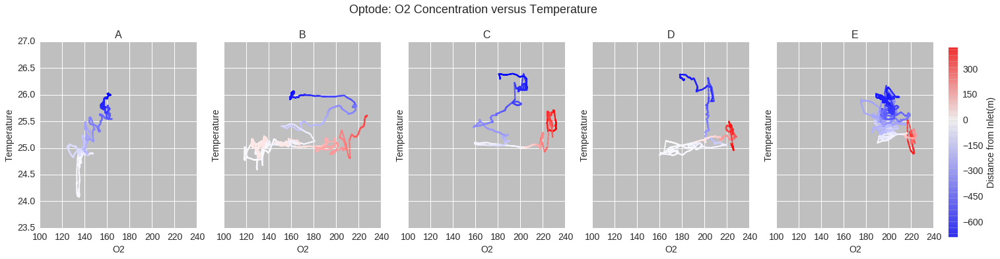

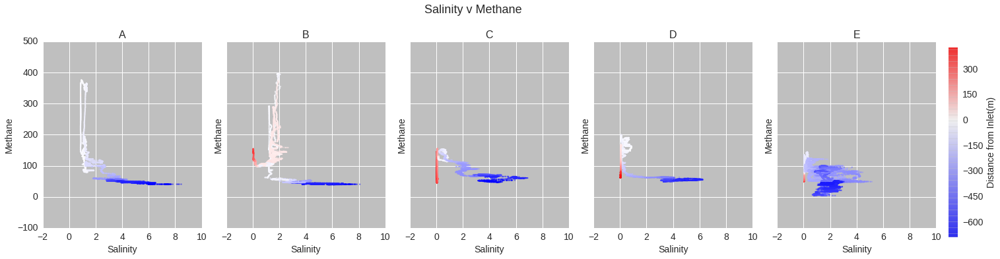

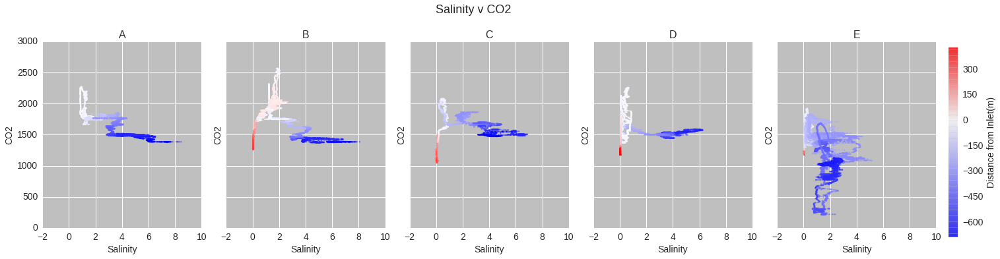

...

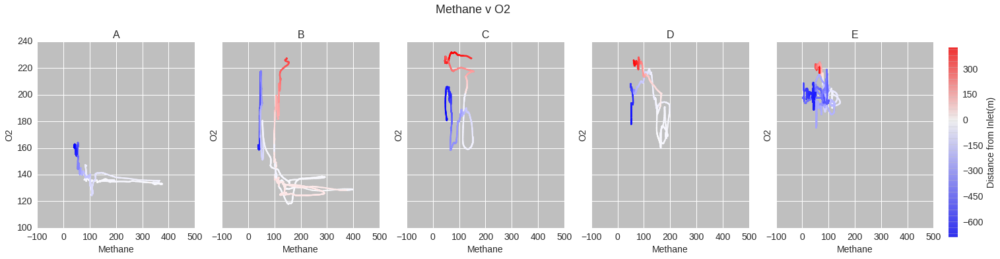

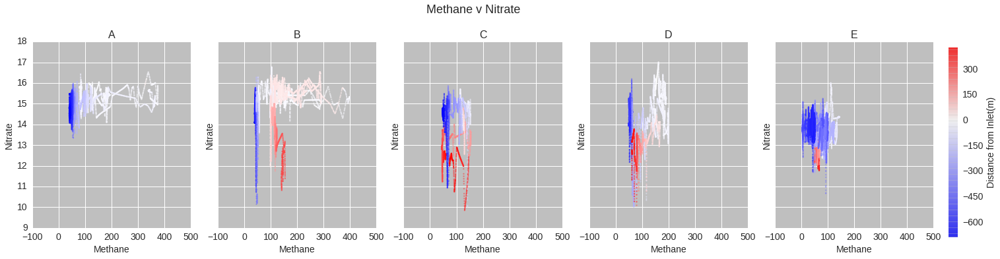

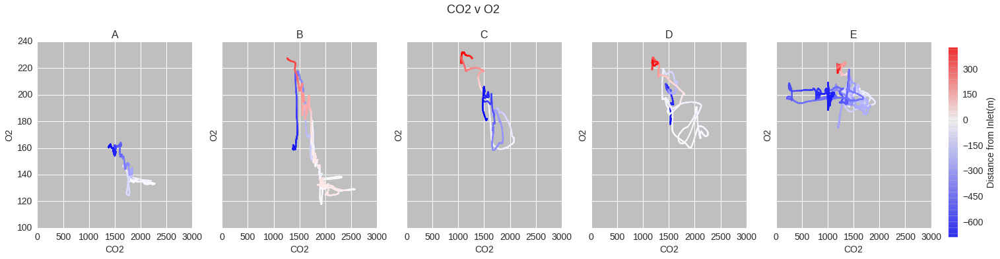

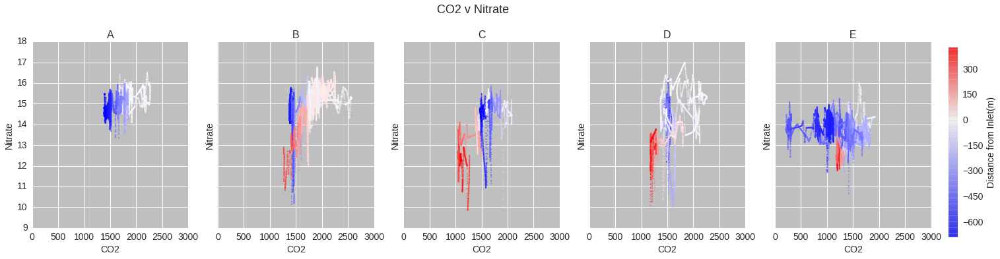

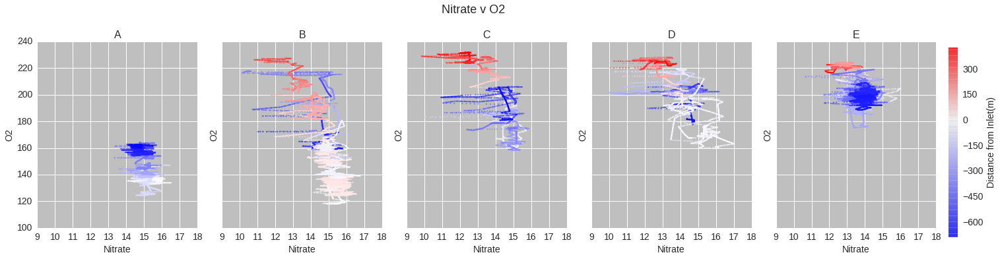

In [72]:
sp.plot_transect_pvpdistance_master(df, ta, tb, tc, td, te)

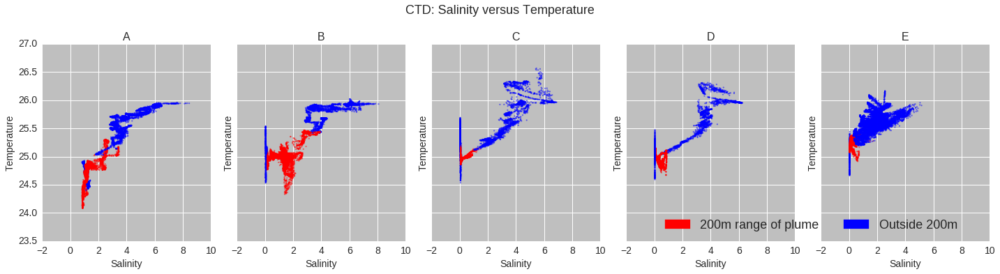

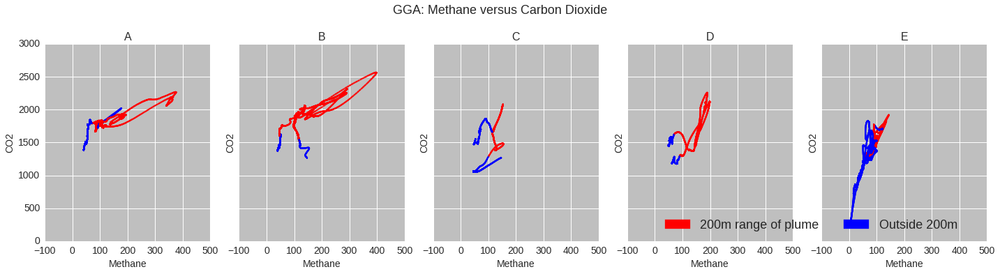

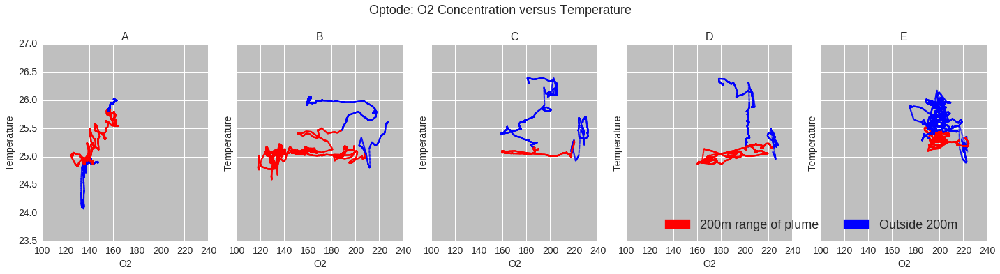

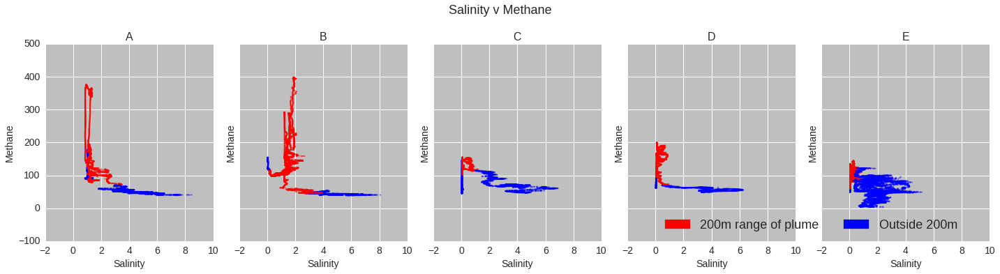

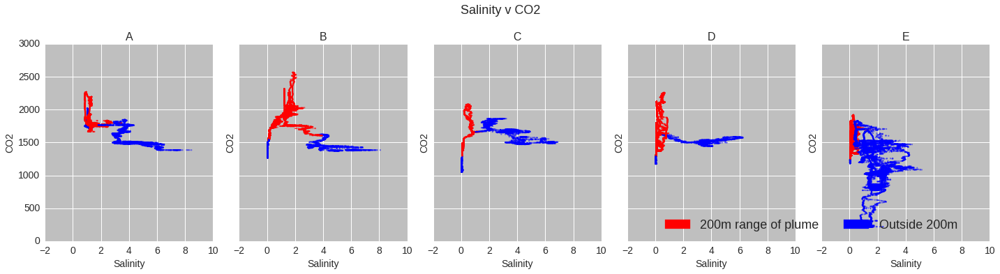

...

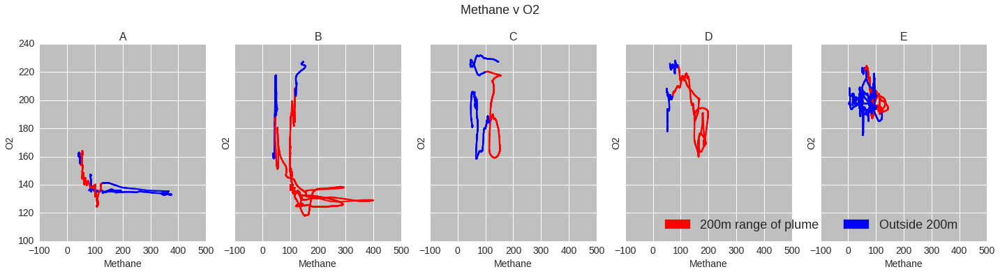

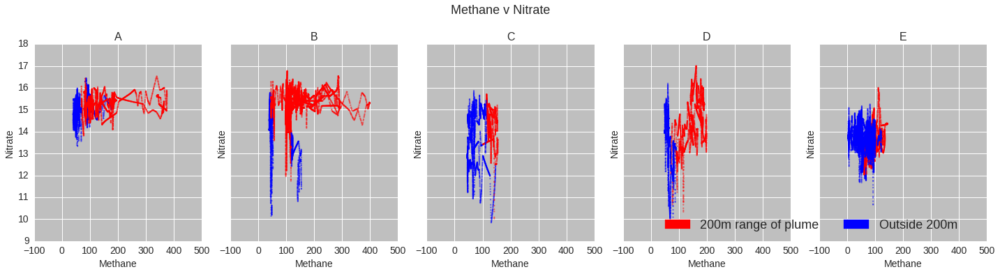

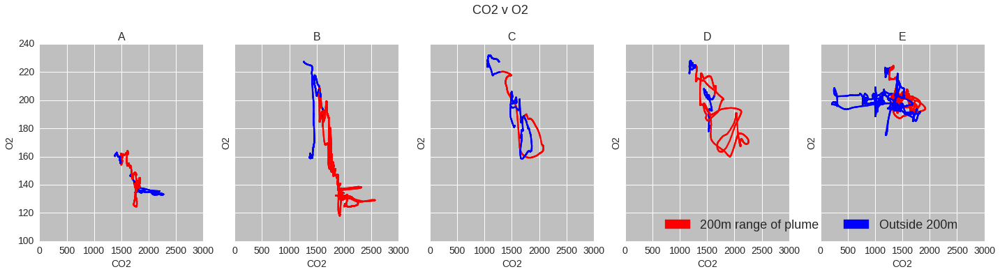

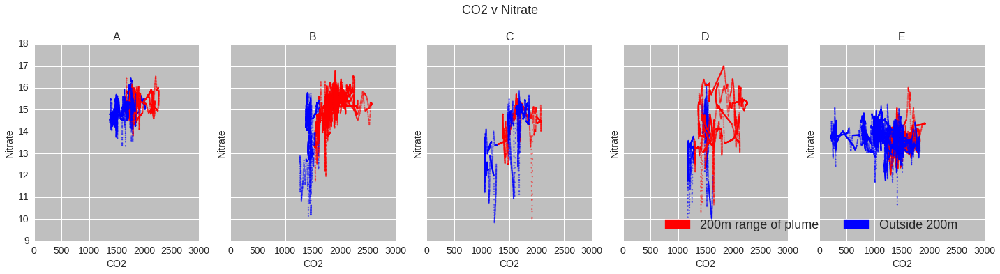

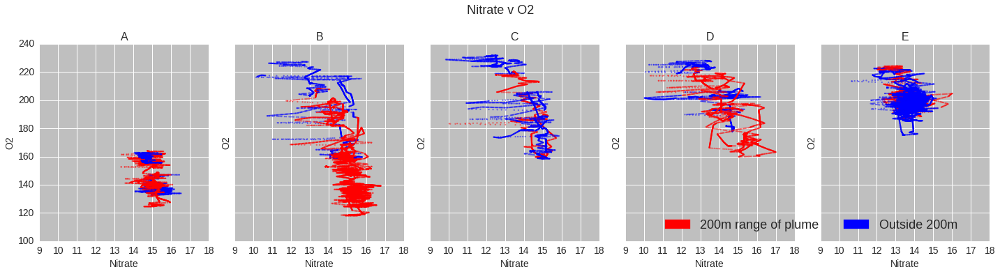

In [73]:
sp.plot_transect_pvprange_master(ta, tb, tc, td, te)

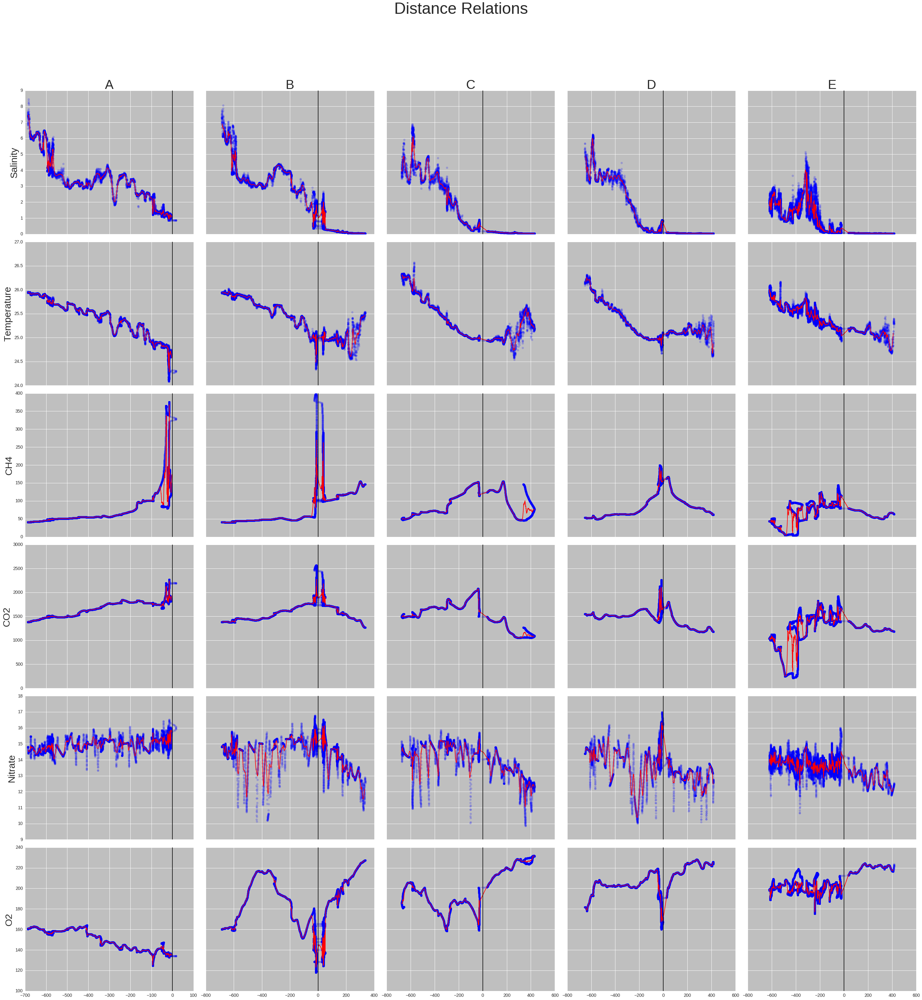

In [74]:
sp.plot_distance_master(ta, tb, tc, td, te)

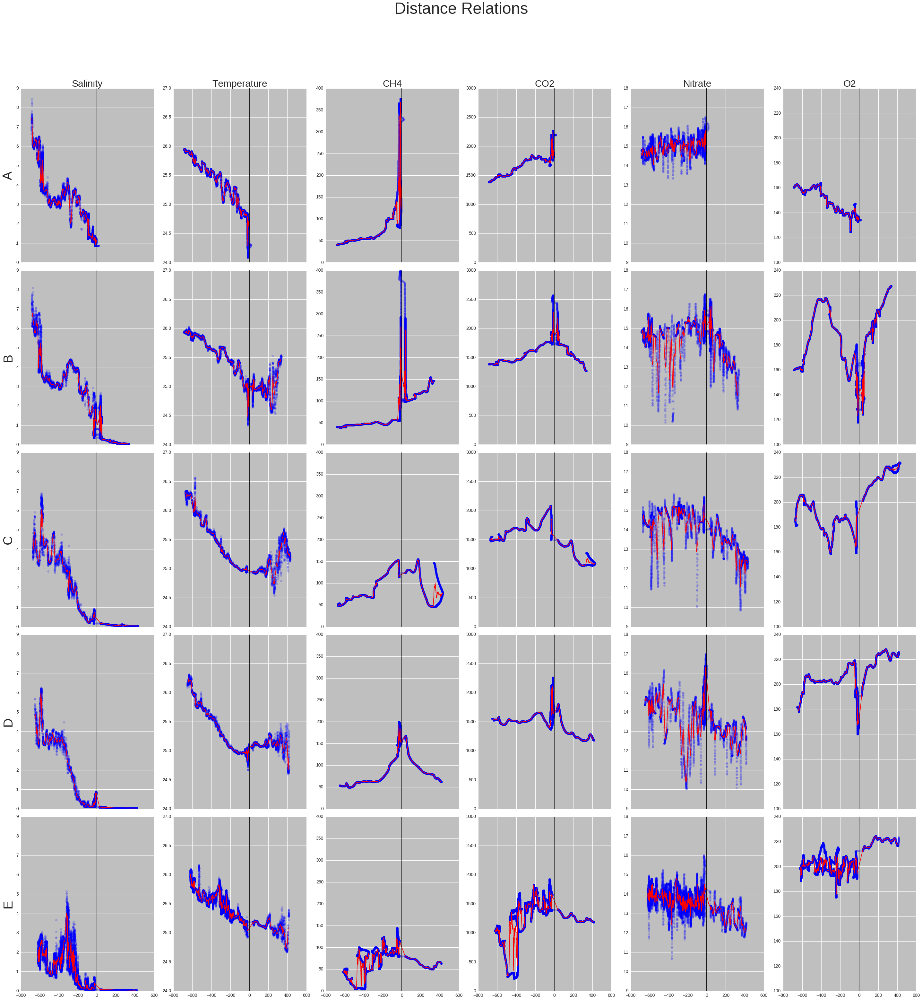

In [75]:
sp.plot_distance_master_2(ta, tb, tc, td, te)